In [ ]:
%matplotlib inline
import matplotlib.pyplot as plt
import numpy as np

!pip install pydmd
import pydmd

from pydmd import DMD

!pip install scipy
import scipy

!pip install future
import future
!pip install sphinx
import sphinx

from sklearn.decomposition import PCA

import pandas as pd

from sklearn.preprocessing import StandardScaler
from pydmd import DMDc
from numpy.testing import assert_array_almost_equal

from numpy import linalg as LA
from pydmd import CDMD

import timeit
import psutil

!pip install ipython-autotime
%load_ext autotime

In [ ]:
!pip install memory_profiler
from memory_profiler import memory_usage

In [ ]:
def f1(x,t):
    return 1./np.cosh(x+3)*np.exp(2.3j*t)

def f2(x,t):
    return 2./np.cosh(x)*np.tanh(x)*np.exp(2.8j*t)

x = np.linspace(-5, 5, 128)
t = np.linspace(0, 4*np.pi, 256)

xgrid, tgrid = np.meshgrid(x, t)

X1 = f1(xgrid, tgrid)
X2 = f2(xgrid, tgrid)
X = X1 + X2

time: 28 ms (started: 2023-09-27 21:58:31 +00:00)


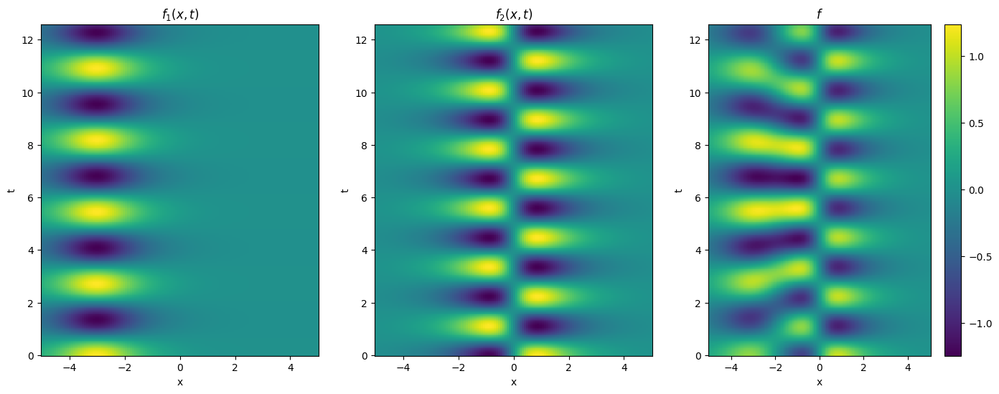

time: 5.11 s (started: 2023-09-27 21:58:32 +00:00)


In [ ]:
titles = ['$f_1(x,t)$', '$f_2(x,t)$', '$f$']
data = np.array([X1, X2, X])

fig = plt.figure(figsize=(17,6))
for n, title, d in zip(range(131,134), titles, data):
    plt.subplot(n)
    plt.pcolor(xgrid, tgrid, d.real)
    plt.title(title)
    plt.xlabel("x")
    plt.ylabel("t")
plt.colorbar()
plt.show()

In [ ]:
Xr = X1.real + X2.real
Xi = X1.imag + X2.imag
Xr.shape

(256, 128)

time: 26.7 ms (started: 2023-09-27 21:58:39 +00:00)


In [ ]:
pca_r = PCA(n_components=2)
pca_i = PCA(n_components=2)

time: 684 µs (started: 2023-09-27 21:58:41 +00:00)


In [ ]:
PCr = pca_r.fit_transform(Xr)
PCi = pca_i.fit_transform(Xi)

time: 70.4 ms (started: 2023-09-27 21:58:42 +00:00)


In [ ]:
pci = pd.DataFrame(PCi)
pcr = pd.DataFrame(PCr)

time: 1.42 ms (started: 2023-09-27 21:58:44 +00:00)


In [ ]:
pcf = pcr.T.append(pci.T)
PCf = np.array(pcf)

time: 11.2 ms (started: 2023-09-27 21:58:45 +00:00)


<ipython-input-8-cac15d55409c>:1: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pcf = pcr.T.append(pci.T)


In [ ]:
PCf.shape

(4, 256)

time: 18.2 ms (started: 2023-09-27 21:58:46 +00:00)


In [ ]:
pd.DataFrame(PCf)

,0,1,2,3,4,5,6,7,8,9,...,246,247,248,249,250,251,252,253,254,255
0,1.909721,1.881074,1.795815,1.655973,1.464883,1.227110,0.948355,0.635329,0.295604,-0.062544,...,-1.160004,-1.413142,-1.618554,-1.771806,-1.869722,-1.910453,-1.893510,-1.819769,-1.691451,-1.512063
1,6.017296,5.972292,5.837994,5.616527,5.311393,4.927419,4.470668,3.948348,3.368691,2.740816,...,-5.106697,-5.405287,-5.620500,-5.748800,-5.788022,-5.737407,-5.597621,-5.370739,-5.060221,-4.670850
2,0.050923,-0.282646,-0.607422,-0.914812,-1.196616,-1.445211,-1.653730,-1.816215,-1.927759,-1.984621,...,-1.666846,-1.415965,-1.131243,-0.820486,-0.492044,-0.154615,0.182949,0.511841,0.823499,1.109795
3,0.336385,-0.393150,-1.111302,-1.806874,-2.469035,-3.087492,-3.652664,-4.155827,-4.589261,-4.946369,...,-2.391431,-1.730310,-1.035944,-0.319103,0.409062,1.137199,1.853938,2.548078,3.208767,3.825678


time: 75.4 ms (started: 2023-09-26 14:51:58 +00:00)


In [ ]:
#PC = pca.fit_transform(Xf)
eVecs = pca.components_

In [ ]:
eVecs.shape

(2, 128)

In [ ]:
eigenvalues_r = pca_r.explained_variance_
explained_variance_ratio_r = pca_r.explained_variance_ratio_

eigenvalues_i = pca_i.explained_variance_
explained_variance_ratio_i = pca_i.explained_variance_ratio_

time: 807 µs (started: 2023-07-17 11:05:49 +00:00)


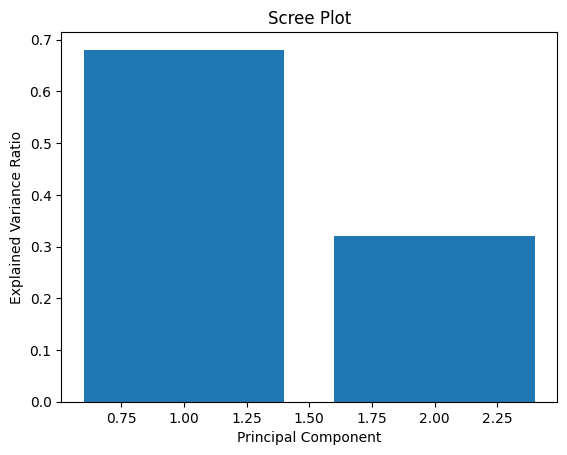

PC	Explained Variance Ratio	Cumulative Explained Variance Ratio
1.0	0.6805028147568966	0.6805028147568966
2.0	0.31949718524310344	1.0
time: 1.09 s (started: 2023-07-17 13:57:09 +00:00)


In [ ]:

# Scree plot
num_components = len(explained_variance_ratio_r)
plt.bar(range(1, num_components + 1), explained_variance_ratio_r)
plt.xlabel('Principal Component')
plt.ylabel('Explained Variance Ratio')
plt.title('Scree Plot')
plt.show()

# Summary table
cumulative_explained_variance_ratio_r = np.cumsum(explained_variance_ratio_r)
summary_table = np.column_stack((range(1, num_components + 1), explained_variance_ratio_r, cumulative_explained_variance_ratio_r))
print('PC\tExplained Variance Ratio\tCumulative Explained Variance Ratio')
for row in summary_table:
    print('\t'.join(str(x) for x in row))

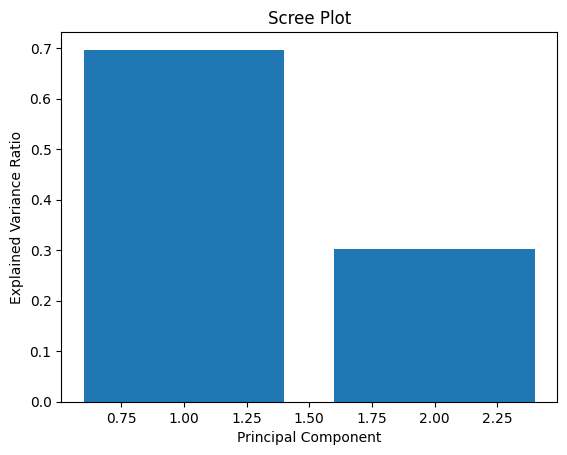

PC	Explained Variance Ratio	Cumulative Explained Variance Ratio
1.0	0.6969581690287145	0.6969581690287145
2.0	0.30304183097128556	1.0
time: 392 ms (started: 2023-07-17 13:57:23 +00:00)


In [ ]:

# Scree plot
num_components = len(explained_variance_ratio_i)
plt.bar(range(1, num_components + 1), explained_variance_ratio_i)
plt.xlabel('Principal Component')
plt.ylabel('Explained Variance Ratio')
plt.title('Scree Plot')
plt.show()

# Summary table
cumulative_explained_variance_ratio_i = np.cumsum(explained_variance_ratio_i)
summary_table = np.column_stack((range(1, num_components + 1), explained_variance_ratio_i, cumulative_explained_variance_ratio_i))
print('PC\tExplained Variance Ratio\tCumulative Explained Variance Ratio')
for row in summary_table:
    print('\t'.join(str(x) for x in row))

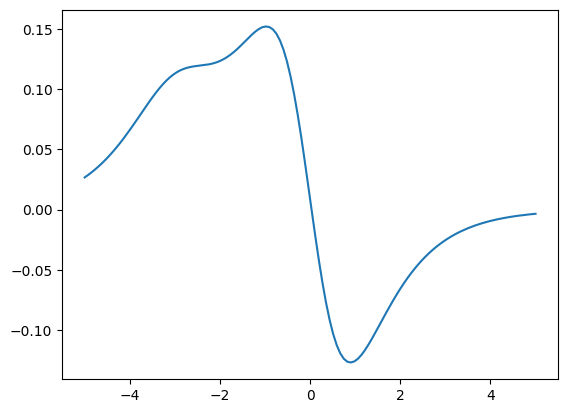

In [ ]:
plt.plot(x, eVecs[0,:])

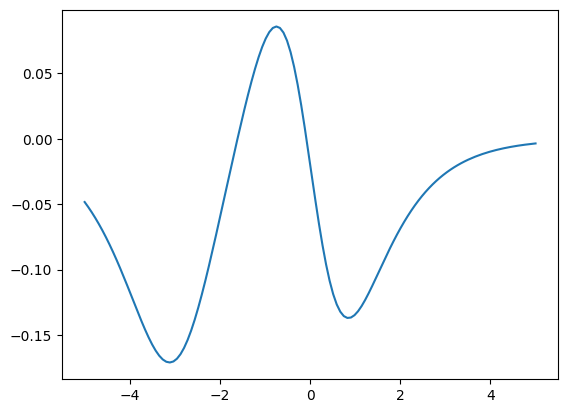

In [ ]:
plt.plot(x, eVecs[1,:])

In [ ]:
plt.plot(x, eVecs[2,:])

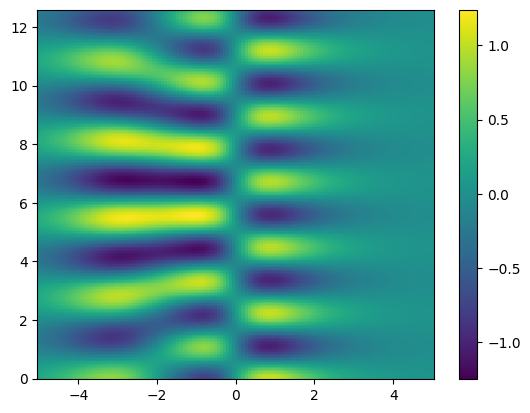

In [ ]:
plt.pcolor(xgrid, tgrid, Xr)
fig = plt.colorbar()

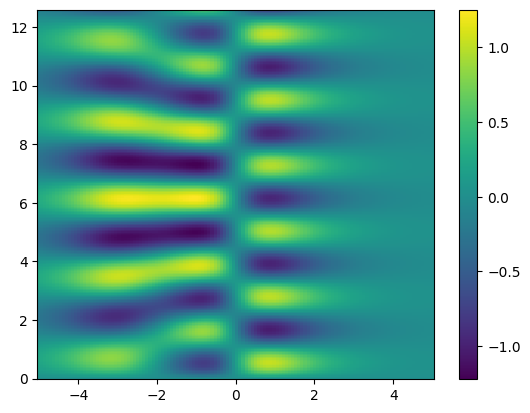

In [ ]:
plt.pcolor(xgrid, tgrid, Xi)
fig = plt.colorbar()

/usr/local/lib/python3.10/dist-packages/matplotlib/cbook/__init__.py:1335: ComplexWarning: Casting complex values to real discards the imaginary part
  return np.asarray(x, float)


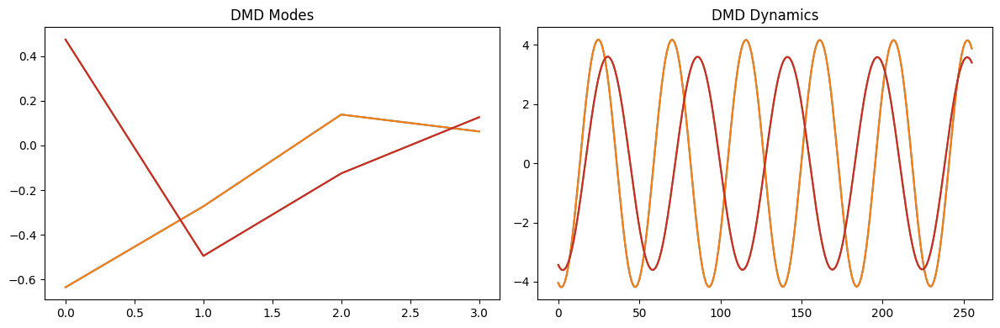

time: 709 ms (started: 2023-09-27 21:59:01 +00:00)


In [ ]:
Z = PCf

# Perform DMD
pdmd = DMD(svd_rank=4)
pdmd.fit(Z)

# Access DMD modes and dynamics
pmodes = pdmd.modes.T
pdynamics = pdmd.dynamics

# Visualize DMD modes and dynamics
plt.figure(figsize=(12, 4))

# Plot DMD modes
plt.subplot(1, 2, 1)
for mode in pmodes:
    plt.plot(mode)
plt.title('DMD Modes')

# Plot DMD dynamics
plt.subplot(1, 2, 2)
for dynamic in pdynamics:
    plt.plot(dynamic)
plt.title('DMD Dynamics')

plt.tight_layout()
plt.show()


In [ ]:
pd.DataFrame(pdynamics)

,0,1,2,3,4,5,6,7,8,9,...,246,247,248,249,250,251,252,253,254,255
0,-4.041879+1.093216j,-4.153731+0.526814j,-4.186605-0.049575j,-4.139881-0.624992j,-4.014451-1.188498j,-3.812703-1.729379j,-3.538476-2.237353j,-3.196989-2.702764j,-2.794738-3.116765j,-2.339372-3.471489j,...,2.668615-3.192613j,3.082340-2.795101j,3.437442-2.344467j,3.727172-1.849282j,3.946024-1.318963j,4.089843-0.763595j,4.155897-0.193737j,4.142935+0.379776j,4.051206+0.946039j,3.882459+1.494286j
1,-4.041879-1.093216j,-4.153731-0.526814j,-4.186605+0.049575j,-4.139881+0.624992j,-4.014451+1.188498j,-3.812703+1.729379j,-3.538476+2.237353j,-3.196989+2.702764j,-2.794738+3.116765j,-2.339372+3.471489j,...,2.668615+3.192613j,3.082340+2.795101j,3.437442+2.344467j,3.727172+1.849282j,3.946024+1.318963j,4.089843+0.763595j,4.155897+0.193737j,4.142935-0.379776j,4.051206-0.946039j,3.882459-1.494286j
2,-3.432015+1.115500j,-3.536076+0.720113j,-3.594745+0.315504j,-3.607270-0.093135j,-3.573493-0.500557j,-3.493849-0.901534j,-3.369364-1.290918j,-3.201637-1.663713j,-2.992823-2.015134j,-2.745605-2.340671j,...,2.736247-2.318121j,2.980822-1.993684j,3.187124-1.643674j,3.352506-1.272584j,3.474848-0.885179j,3.552582-0.486431j,3.584713-0.081460j,3.570829+0.324535j,3.511113+0.726345j,3.406332+1.118811j
3,-3.432015-1.115500j,-3.536076-0.720113j,-3.594745-0.315504j,-3.607270+0.093135j,-3.573493+0.500557j,-3.493849+0.901534j,-3.369364+1.290918j,-3.201637+1.663713j,-2.992823+2.015134j,-2.745605+2.340671j,...,2.736247+2.318121j,2.980822+1.993684j,3.187124+1.643674j,3.352506+1.272584j,3.474848+0.885179j,3.552582+0.486431j,3.584713+0.081460j,3.570829-0.324535j,3.511113-0.726345j,3.406332-1.118811j


time: 78.2 ms (started: 2023-09-26 14:52:29 +00:00)


/usr/local/lib/python3.10/dist-packages/pydmd/snapshots.py:72: UserWarning: Input data condition number 3.529453303606382e+18. Consider preprocessing data, passing in augmented data
matrix, or regularization methods.
  warnings.warn(


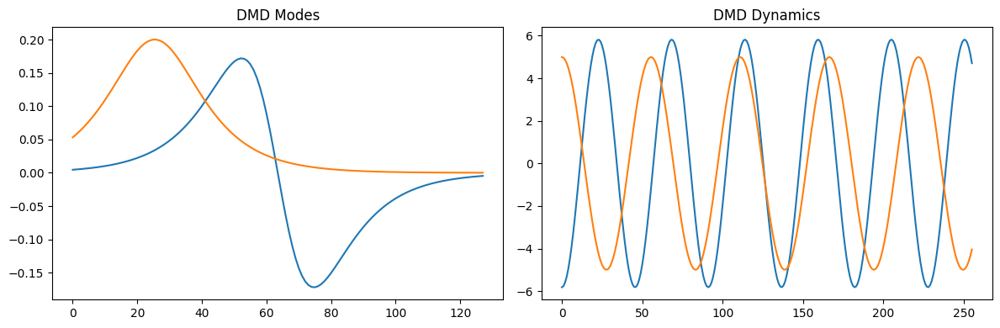

time: 1.41 s (started: 2023-09-27 21:59:04 +00:00)


In [ ]:
Z = X.T

# Perform DMD
dmd = DMD(svd_rank=2)
dmd.fit(Z)

# Access DMD modes and dynamics
modes = dmd.modes.T
dynamics = dmd.dynamics

# Visualize DMD modes and dynamics
plt.figure(figsize=(12, 4))

# Plot DMD modes
plt.subplot(1, 2, 1)
for mode in modes:
    plt.plot(mode)
plt.title('DMD Modes')

# Plot DMD dynamics
plt.subplot(1, 2, 2)
for dynamic in dynamics:
    plt.plot(dynamic)
plt.title('DMD Dynamics')

plt.tight_layout()
plt.show()

In [ ]:
snapshots_matrix = PCf
random_matrix = np.random.permutation(
    snapshots_matrix.shape[0] * snapshots_matrix.shape[1]
)
random_matrix = random_matrix.reshape(
    snapshots_matrix.shape[1], snapshots_matrix.shape[0]
)

compression_matrix = random_matrix / np.linalg.norm(random_matrix)

time: 1.36 ms (started: 2023-07-16 19:46:48 +00:00)


In [ ]:
cdmd = CDMD(svd_rank=4, compression_matrix=compression_matrix)
cdmd.fit(snapshots_matrix)

plt.figure(figsize=(16, 8))
plt.subplot(1, 2, 1)
plt.plot(cdmd.modes.real)
plt.subplot(1, 2, 2)
plt.plot(cdmd.dynamics.T.real)
plt.show()

In [ ]:
print(X.T.shape)
print(Z.shape)

(128, 256)
(4, 256)


In [ ]:
print(dmd.modes.shape)
print(dmd.dynamics.shape)

(4, 4)
(4, 256)


In [ ]:
dmd.dmd_timesteps

(2,)

time: 8.29 ms (started: 2023-08-23 19:34:50 +00:00)


In [ ]:
omega = np.log(dmd.eigs)
omega

array([6.59370326e-16+0.13798368j, 3.51160342e-16+0.11334373j])

time: 16.2 ms (started: 2023-08-24 11:23:10 +00:00)


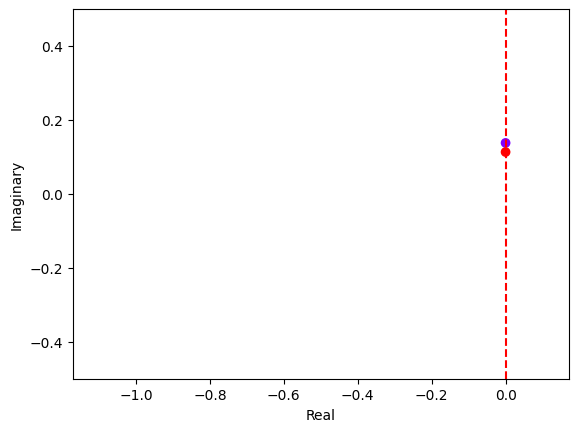

time: 406 ms (started: 2023-08-24 11:58:59 +00:00)


In [ ]:
fig, ax = plt.subplots()
colors = np.linspace(0, 1, len(omega))
edge_colors = plt.cm.rainbow(colors)
ax.scatter(np.real(omega), np.imag(omega), c=colors, cmap='rainbow', marker='o', edgecolors=edge_colors, facecolors='none')
#unit_circle = plt.Circle((0, 0), 1, color='green', fill=False, linestyle='dashed')
#ax.add_artist(unit_circle)
ax.set_aspect('equal', adjustable='datalim')
ax.axvline(x=0, color='red', linestyle='dashed')
ax.set_xlim([-1.5, 0.5])
ax.set_ylim([-0.5, 0.5])
plt.xlabel('Real')
plt.ylabel('Imaginary')
#plt.grid(True)
#plt.title('Eigenvalues on the Unit Circle (Positive Imaginary Part)')
plt.show()

In [ ]:
omega2 = np.log(pdmd.eigs)
omega2

array([-2.53864828e-05+0.13799638j, -2.53864828e-05-0.13799638j,
       -2.54942709e-05+0.11335663j, -2.54942709e-05-0.11335663j])

time: 5.67 ms (started: 2023-08-24 11:23:50 +00:00)


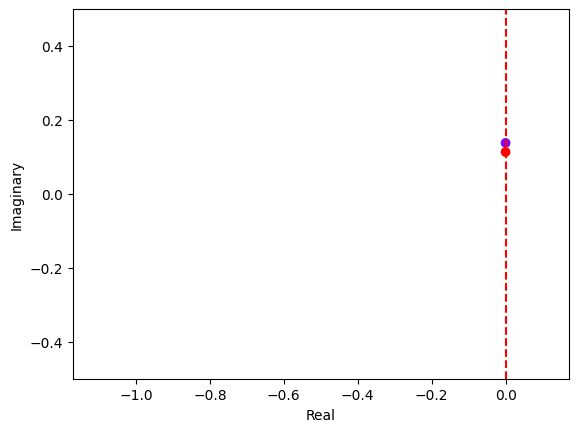

time: 368 ms (started: 2023-08-24 11:59:06 +00:00)


In [ ]:
filtered_eigenvalues = [eig for eig in omega2 if eig.imag > 0]
fig, ax = plt.subplots()
colors = np.linspace(0, 1, len(filtered_eigenvalues))
edge_colors = plt.cm.rainbow(colors)
ax.scatter(np.real(filtered_eigenvalues), np.imag(filtered_eigenvalues), c=colors, cmap='rainbow', marker='o', edgecolors=edge_colors, facecolors='none')
#unit_circle = plt.Circle((0, 0), 1, color='green', fill=False, linestyle='dashed')
#ax.add_artist(unit_circle)
ax.set_aspect('equal', adjustable='datalim')
ax.axvline(x=0, color='red', linestyle='dashed')
ax.set_xlim([-1.5, 0.5])
ax.set_ylim([-0.5, 0.5])
plt.xlabel('Real')
plt.ylabel('Imaginary')
#plt.grid(True)
#plt.title('Eigenvalues on the Unit Circle (Positive Imaginary Part)')
plt.show()

Eigenvalue (0.9904684550632443+0.13755532649803903j): distance from unit circle 2.5386160552476333e-05
Eigenvalue (0.9935566839137823+0.11311113388290847j): distance from unit circle 2.5493945956300834e-05


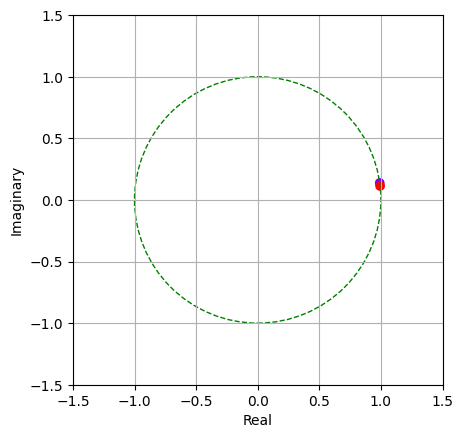

time: 675 ms (started: 2023-08-24 11:23:50 +00:00)


In [ ]:
eigenvalues = pdmd.eigs
for eig in eigenvalues:
    if eig.imag > 0:  # Filter eigenvalues with positive imaginary parts
        print("Eigenvalue {}: distance from unit circle {}".format(eig, np.abs(np.sqrt(eig.imag**2 + eig.real**2) - 1)))

fig, ax = plt.subplots()
filtered_eigenvalues = [eig for eig in eigenvalues if eig.imag > 0]
colors = np.linspace(0, 1, len(filtered_eigenvalues))
edge_colors = plt.cm.rainbow(colors)
ax.scatter(np.real(filtered_eigenvalues), np.imag(filtered_eigenvalues), c=colors, cmap='rainbow', marker='o', edgecolors=edge_colors, facecolors='none')
unit_circle = plt.Circle((0, 0), 1, color='green', fill=False, linestyle='dashed')
ax.add_artist(unit_circle)
ax.set_aspect('equal', adjustable='box')
ax.set_xlim([-1.5, 1.5])
ax.set_ylim([-1.5, 1.5])
plt.xlabel('Real')
plt.ylabel('Imaginary')
#plt.title('Eigenvalues on the Unit Circle (Positive Imaginary Part)')
plt.grid(True)
plt.show()

Eigenvalue (0.9904953470777584+0.13754623737970062j): distance from unit circle 1.1102230246251565e-15
Eigenvalue (0.9935834726096835+0.11310120669950205j): distance from unit circle 4.440892098500626e-16


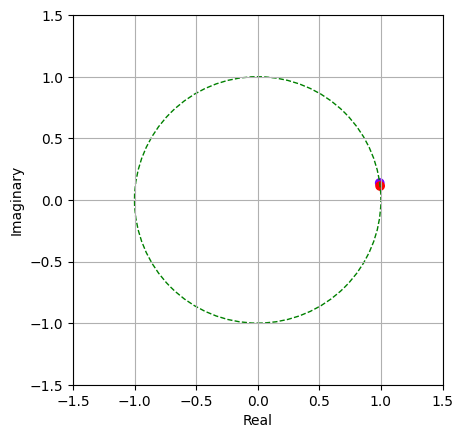

time: 393 ms (started: 2023-07-15 18:00:34 +00:00)


In [ ]:
eigenvalues = dmd.eigs

for eig in eigenvalues:
    print("Eigenvalue {}: distance from unit circle {}".format(eig, np.abs(np.sqrt(eig.imag**2 + eig.real**2) - 1)))
fig, ax = plt.subplots()
filtered_eigenvalues = [eig for eig in eigenvalues if eig.imag > 0]
colors = np.linspace(0, 1, len(filtered_eigenvalues))
edge_colors = plt.cm.rainbow(colors)
ax.scatter(np.real(filtered_eigenvalues), np.imag(filtered_eigenvalues), c=colors, cmap='rainbow', marker='o', edgecolors=edge_colors, facecolors='none')
unit_circle = plt.Circle((0, 0), 1, color='green', fill=False, linestyle='dashed')
ax.add_artist(unit_circle)
ax.set_aspect('equal', adjustable='box')
ax.set_xlim([-1.5, 1.5])
ax.set_ylim([-1.5, 1.5])
plt.xlabel('Real')
plt.ylabel('Imaginary')
#plt.title('Eigenvalues on the Unit Circle (Positive Imaginary Part)')
plt.grid(True)
plt.show()

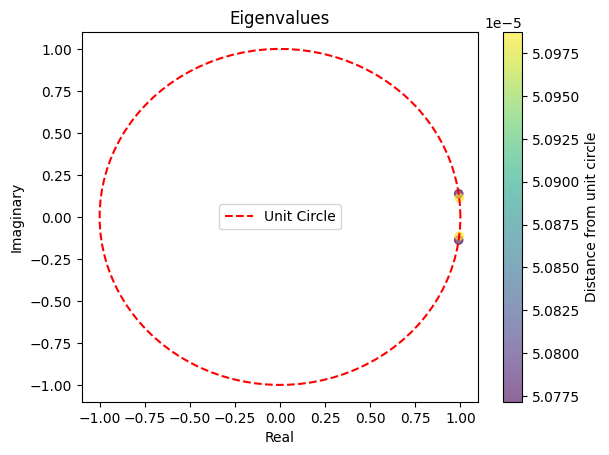

time: 744 ms (started: 2023-07-15 15:07:51 +00:00)


In [ ]:
eigenvalues = pdmd.eigs

# Calculate distance from unit circle
distances = np.abs(eigenvalues.imag**2 + eigenvalues.real**2 - 1)

# Plot eigenvalues and unit circle
plt.figure()
plt.scatter(eigenvalues.real, eigenvalues.imag, c=distances, cmap='viridis', alpha=0.6)
plt.colorbar(label='Distance from unit circle')
plt.xlabel('Real')
plt.ylabel('Imaginary')
plt.title('Eigenvalues')

# Plot unit circle
theta = np.linspace(0, 2 * np.pi, 100)
plt.plot(np.cos(theta), np.sin(theta), color='red', linestyle='--', label='Unit Circle')
plt.legend()

plt.show()

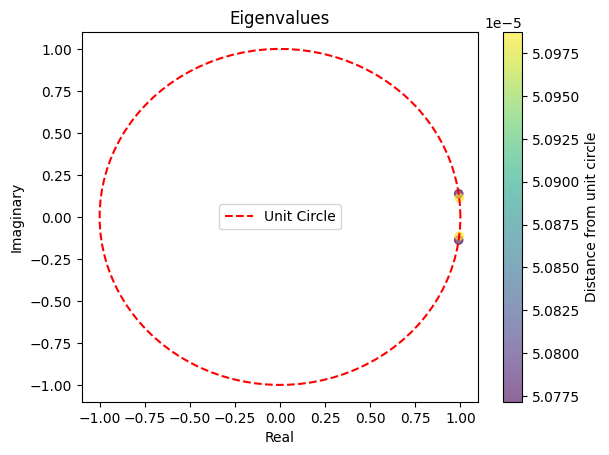

time: 856 ms (started: 2023-07-15 15:07:56 +00:00)


In [ ]:
eigenvalues = dmd.eigs

# Calculate distance from unit circle
distances = np.abs(eigenvalues.imag**2 + eigenvalues.real**2 - 1)

# Plot eigenvalues and unit circle
plt.figure()
plt.scatter(eigenvalues.real, eigenvalues.imag, c=distances, cmap='viridis', alpha=0.6)
plt.colorbar(label='Distance from unit circle')
plt.xlabel('Real')
plt.ylabel('Imaginary')
plt.title('Eigenvalues')

# Plot unit circle
theta = np.linspace(0, 2 * np.pi, 100)
plt.plot(np.cos(theta), np.sin(theta), color='red', linestyle='--', label='Unit Circle')
plt.legend()

plt.show()

In [ ]:
dmd.reconstructed_data.T.shape

(256, 128)

time: 15.5 ms (started: 2023-09-27 22:00:05 +00:00)


In [ ]:
pd.DataFrame(PCf).T

In [ ]:
dmd_rec = pd.DataFrame(dmd.reconstructed_data)
dmd_rec.T

In [ ]:
dmd_rec_real = pdmd.reconstructed_data[0:2]
dmd_rec_imag = pdmd.reconstructed_data[2:]

time: 3.03 ms (started: 2023-09-27 22:00:29 +00:00)


In [ ]:
x_recon_real = pca_r.inverse_transform(dmd_rec_real.T)
x_recon_imag = pca_i.inverse_transform(dmd_rec_imag.T)

time: 1.83 ms (started: 2023-09-27 22:00:33 +00:00)


In [ ]:
x_recon_real[:,0:1]

In [ ]:
#combined_array = np.array([complex(a, b) for a, b in zip(x_recon_real, x_recon_imag)])
#combined_array = np.column_stack((x_recon_real, x_recon_imag)).view(complex)

X_recon = x_recon_real + 1j * x_recon_imag


time: 2.2 ms (started: 2023-09-27 22:00:42 +00:00)


In [ ]:
pd.DataFrame(x_recon_imag)

In [ ]:
X_recon.shape

(256, 128)

time: 3.16 ms (started: 2023-09-27 22:00:46 +00:00)


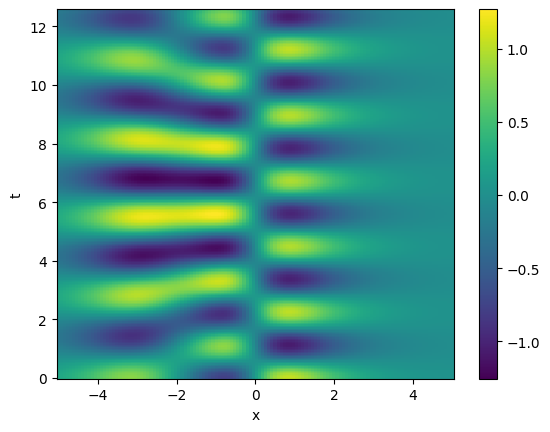

time: 601 ms (started: 2023-09-27 22:00:49 +00:00)


In [ ]:
plt.pcolor(xgrid, tgrid, X_recon.real)
plt.xlabel("x")
plt.ylabel("t")
fig = plt.colorbar()

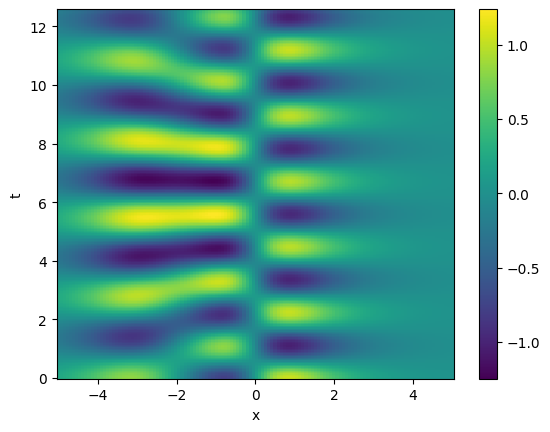

time: 856 ms (started: 2023-09-27 22:00:54 +00:00)


In [ ]:
plt.pcolor(xgrid, tgrid, dmd.reconstructed_data.T.real)
plt.xlabel("x")
plt.ylabel("t")
fig = plt.colorbar()

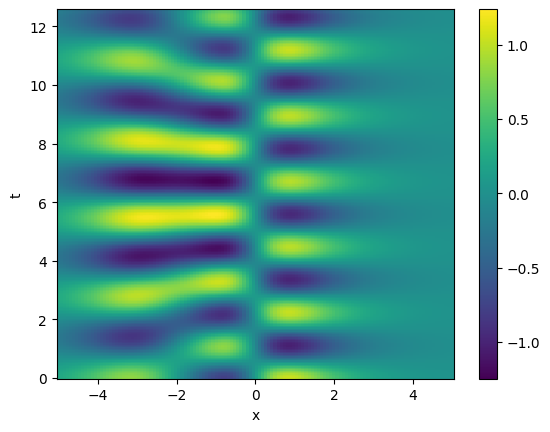

time: 606 ms (started: 2023-09-27 22:01:00 +00:00)


In [ ]:
plt.pcolor(xgrid, tgrid, X.real)
plt.xlabel("x")
plt.ylabel("t")
fig = plt.colorbar()

In [ ]:
diff_dmd = X.real - dmd.reconstructed_data.T.real

diff_pcadmd = X.real - X_recon.real

time: 10.7 ms (started: 2023-09-27 22:03:30 +00:00)


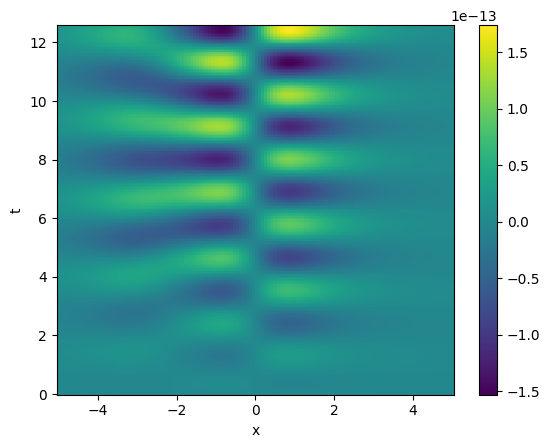

time: 3.28 s (started: 2023-09-27 22:04:00 +00:00)


In [ ]:
plt.pcolor(xgrid, tgrid, diff_dmd)
plt.xlabel("x")
plt.ylabel("t")
fig = plt.colorbar()

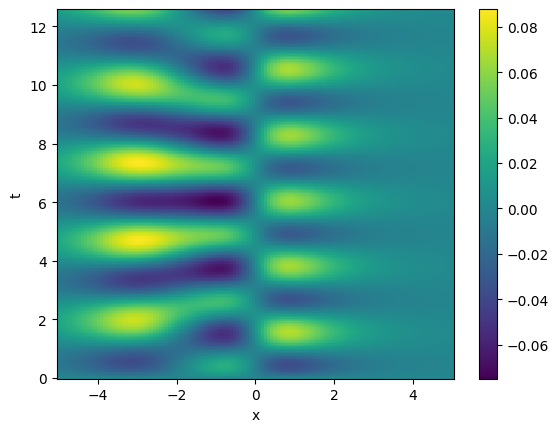

time: 1.9 s (started: 2023-09-27 22:04:18 +00:00)


In [ ]:
plt.pcolor(xgrid, tgrid, diff_pcadmd)
plt.xlabel("x")
plt.ylabel("t")
fig = plt.colorbar()

[[ 1.90972135  1.88107444  1.79581516 ... -1.81976943 -1.69145074
  -1.5120626 ]
 [ 6.01729568  5.97229218  5.83799403 ... -5.37073899 -5.06022056
  -4.6708503 ]
 [ 0.05092254 -0.28264586 -0.60742199 ...  0.51184106  0.82349855
   1.10979513]
 [ 0.33638498 -0.39314953 -1.11130182 ...  2.54807778  3.20876652
   3.82567769]]


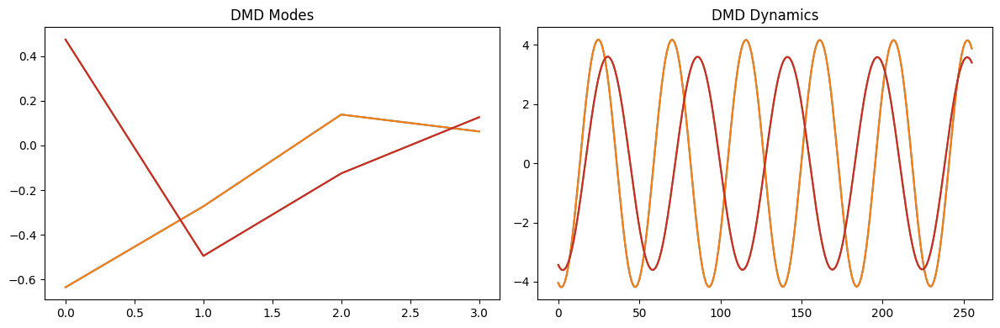

[[ 1.90972135  1.88107444  1.79581516 ... -1.81976943 -1.69145074
  -1.5120626 ]
 [ 6.01729568  5.97229218  5.83799403 ... -5.37073899 -5.06022056
  -4.6708503 ]
 [ 0.05092254 -0.28264586 -0.60742199 ...  0.51184106  0.82349855
   1.10979513]
 [ 0.33638498 -0.39314953 -1.11130182 ...  2.54807778  3.20876652
   3.82567769]]


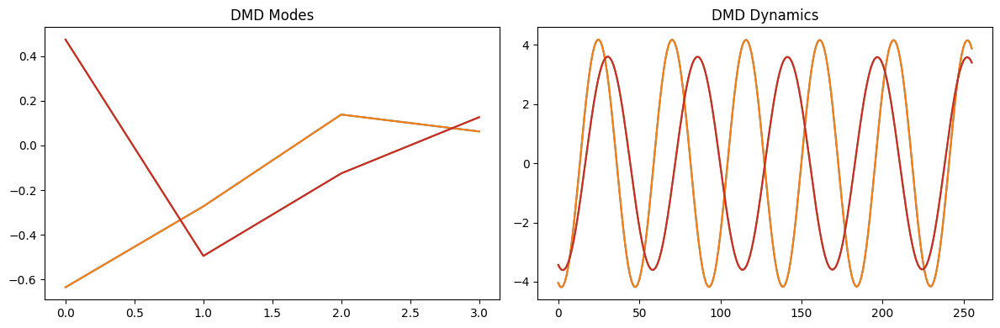

[[ 1.90972135  1.88107444  1.79581516 ... -1.81976943 -1.69145074
  -1.5120626 ]
 [ 6.01729568  5.97229218  5.83799403 ... -5.37073899 -5.06022056
  -4.6708503 ]
 [ 0.05092254 -0.28264586 -0.60742199 ...  0.51184106  0.82349855
   1.10979513]
 [ 0.33638498 -0.39314953 -1.11130182 ...  2.54807778  3.20876652
   3.82567769]]


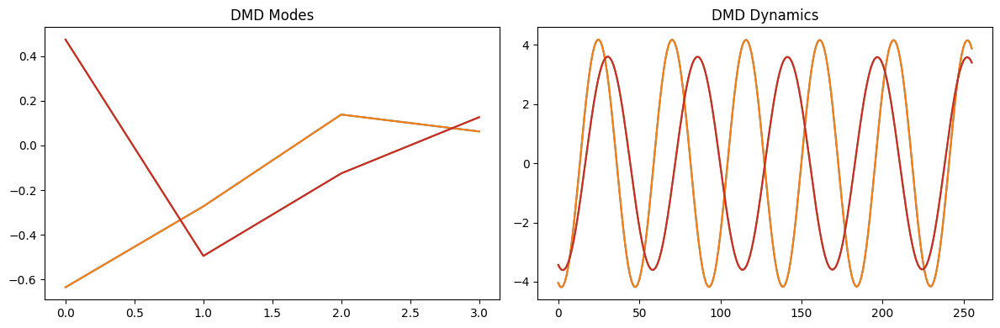

[[ 1.90972135  1.88107444  1.79581516 ... -1.81976943 -1.69145074
  -1.5120626 ]
 [ 6.01729568  5.97229218  5.83799403 ... -5.37073899 -5.06022056
  -4.6708503 ]
 [ 0.05092254 -0.28264586 -0.60742199 ...  0.51184106  0.82349855
   1.10979513]
 [ 0.33638498 -0.39314953 -1.11130182 ...  2.54807778  3.20876652
   3.82567769]]


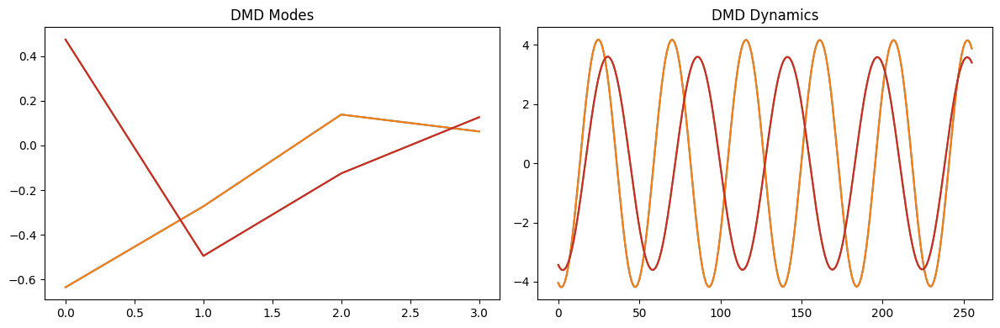

[[ 1.90972135  1.88107444  1.79581516 ... -1.81976943 -1.69145074
  -1.5120626 ]
 [ 6.01729568  5.97229218  5.83799403 ... -5.37073899 -5.06022056
  -4.6708503 ]
 [ 0.05092254 -0.28264586 -0.60742199 ...  0.51184106  0.82349855
   1.10979513]
 [ 0.33638498 -0.39314953 -1.11130182 ...  2.54807778  3.20876652
   3.82567769]]


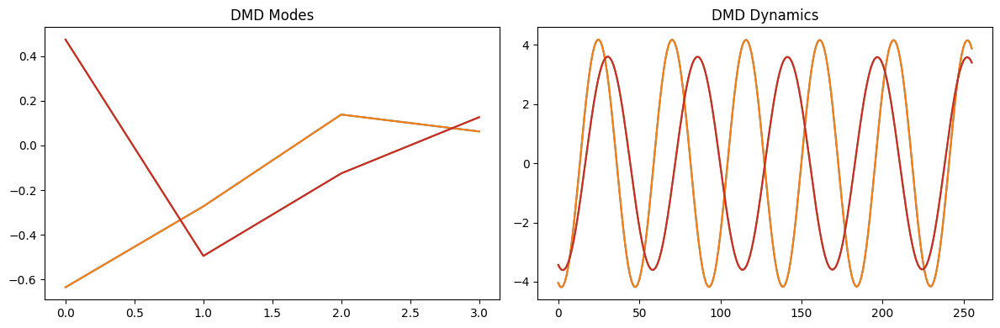

[[ 1.90972135  1.88107444  1.79581516 ... -1.81976943 -1.69145074
  -1.5120626 ]
 [ 6.01729568  5.97229218  5.83799403 ... -5.37073899 -5.06022056
  -4.6708503 ]
 [ 0.05092254 -0.28264586 -0.60742199 ...  0.51184106  0.82349855
   1.10979513]
 [ 0.33638498 -0.39314953 -1.11130182 ...  2.54807778  3.20876652
   3.82567769]]


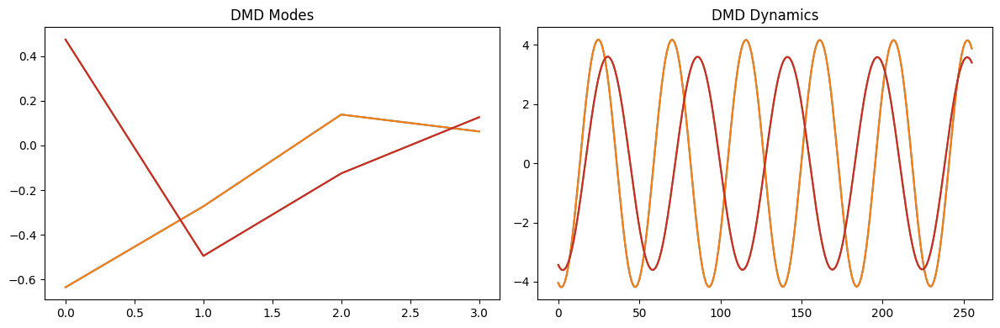

[[ 1.90972135  1.88107444  1.79581516 ... -1.81976943 -1.69145074
  -1.5120626 ]
 [ 6.01729568  5.97229218  5.83799403 ... -5.37073899 -5.06022056
  -4.6708503 ]
 [ 0.05092254 -0.28264586 -0.60742199 ...  0.51184106  0.82349855
   1.10979513]
 [ 0.33638498 -0.39314953 -1.11130182 ...  2.54807778  3.20876652
   3.82567769]]


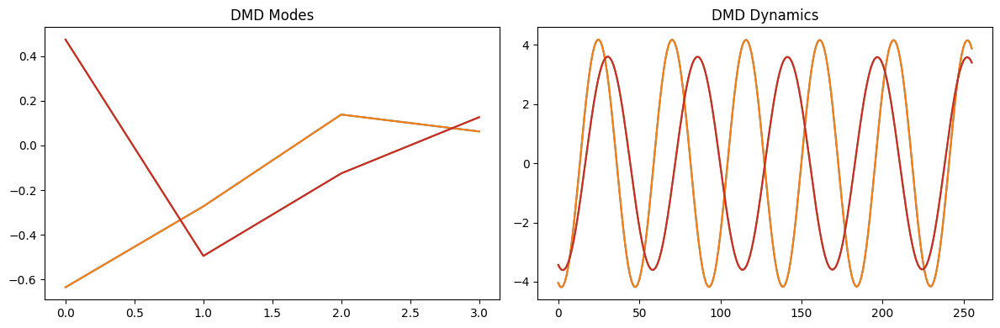

[[ 1.90972135  1.88107444  1.79581516 ... -1.81976943 -1.69145074
  -1.5120626 ]
 [ 6.01729568  5.97229218  5.83799403 ... -5.37073899 -5.06022056
  -4.6708503 ]
 [ 0.05092254 -0.28264586 -0.60742199 ...  0.51184106  0.82349855
   1.10979513]
 [ 0.33638498 -0.39314953 -1.11130182 ...  2.54807778  3.20876652
   3.82567769]]


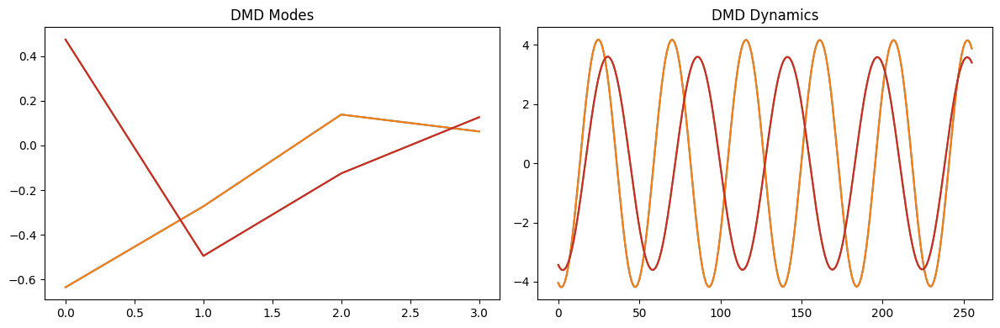

[[ 1.90972135  1.88107444  1.79581516 ... -1.81976943 -1.69145074
  -1.5120626 ]
 [ 6.01729568  5.97229218  5.83799403 ... -5.37073899 -5.06022056
  -4.6708503 ]
 [ 0.05092254 -0.28264586 -0.60742199 ...  0.51184106  0.82349855
   1.10979513]
 [ 0.33638498 -0.39314953 -1.11130182 ...  2.54807778  3.20876652
   3.82567769]]


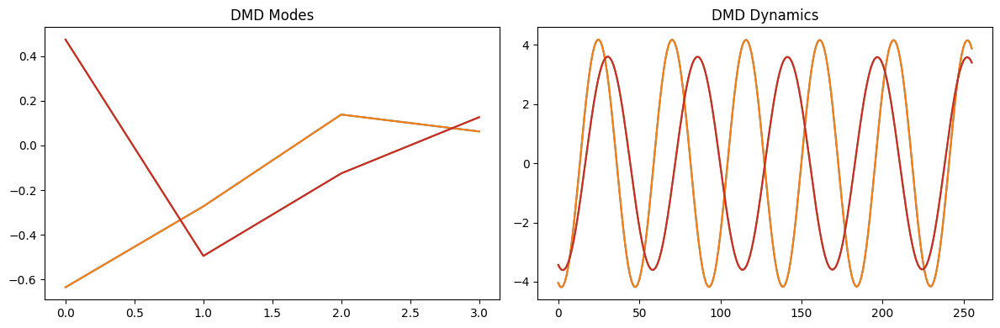

[[ 1.90972135  1.88107444  1.79581516 ... -1.81976943 -1.69145074
  -1.5120626 ]
 [ 6.01729568  5.97229218  5.83799403 ... -5.37073899 -5.06022056
  -4.6708503 ]
 [ 0.05092254 -0.28264586 -0.60742199 ...  0.51184106  0.82349855
   1.10979513]
 [ 0.33638498 -0.39314953 -1.11130182 ...  2.54807778  3.20876652
   3.82567769]]


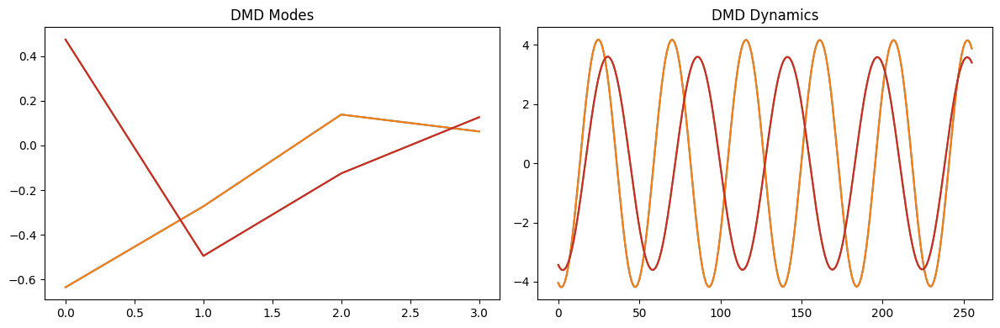

[[ 1.90972135  1.88107444  1.79581516 ... -1.81976943 -1.69145074
  -1.5120626 ]
 [ 6.01729568  5.97229218  5.83799403 ... -5.37073899 -5.06022056
  -4.6708503 ]
 [ 0.05092254 -0.28264586 -0.60742199 ...  0.51184106  0.82349855
   1.10979513]
 [ 0.33638498 -0.39314953 -1.11130182 ...  2.54807778  3.20876652
   3.82567769]]


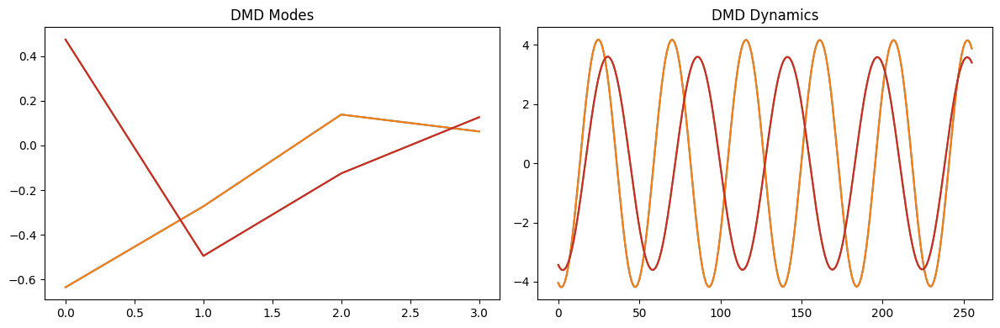

[[ 1.90972135  1.88107444  1.79581516 ... -1.81976943 -1.69145074
  -1.5120626 ]
 [ 6.01729568  5.97229218  5.83799403 ... -5.37073899 -5.06022056
  -4.6708503 ]
 [ 0.05092254 -0.28264586 -0.60742199 ...  0.51184106  0.82349855
   1.10979513]
 [ 0.33638498 -0.39314953 -1.11130182 ...  2.54807778  3.20876652
   3.82567769]]


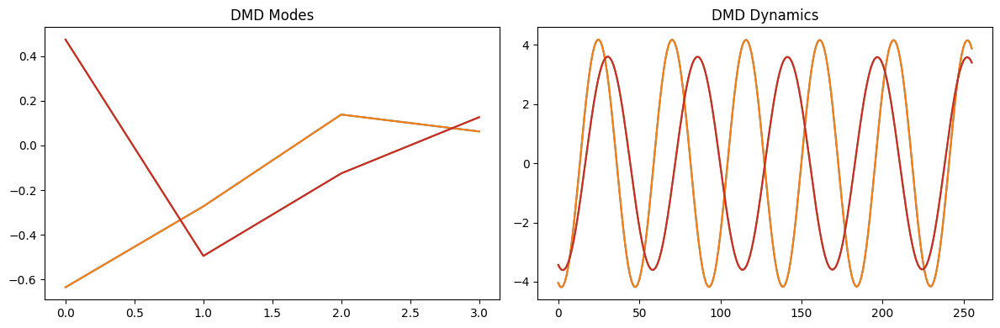

[[ 1.90972135  1.88107444  1.79581516 ... -1.81976943 -1.69145074
  -1.5120626 ]
 [ 6.01729568  5.97229218  5.83799403 ... -5.37073899 -5.06022056
  -4.6708503 ]
 [ 0.05092254 -0.28264586 -0.60742199 ...  0.51184106  0.82349855
   1.10979513]
 [ 0.33638498 -0.39314953 -1.11130182 ...  2.54807778  3.20876652
   3.82567769]]


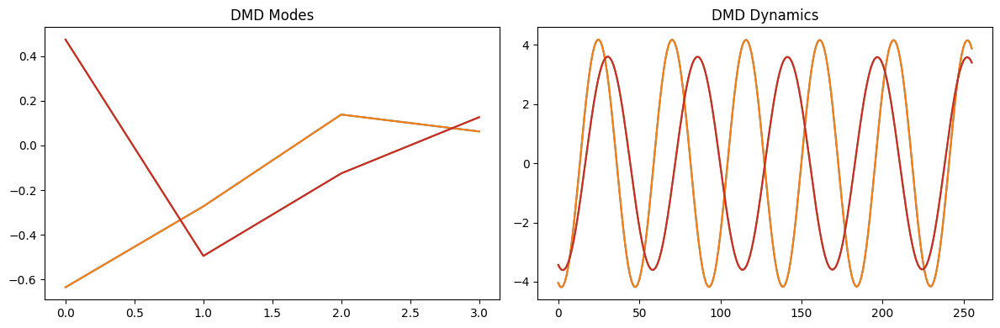

[[ 1.90972135  1.88107444  1.79581516 ... -1.81976943 -1.69145074
  -1.5120626 ]
 [ 6.01729568  5.97229218  5.83799403 ... -5.37073899 -5.06022056
  -4.6708503 ]
 [ 0.05092254 -0.28264586 -0.60742199 ...  0.51184106  0.82349855
   1.10979513]
 [ 0.33638498 -0.39314953 -1.11130182 ...  2.54807778  3.20876652
   3.82567769]]


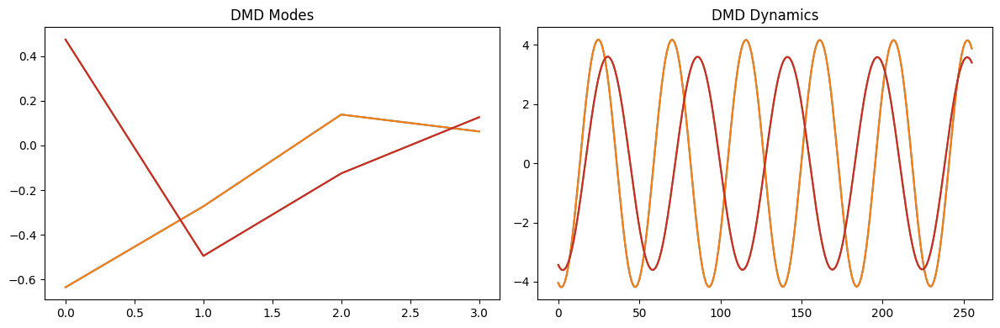

[[ 1.90972135  1.88107444  1.79581516 ... -1.81976943 -1.69145074
  -1.5120626 ]
 [ 6.01729568  5.97229218  5.83799403 ... -5.37073899 -5.06022056
  -4.6708503 ]
 [ 0.05092254 -0.28264586 -0.60742199 ...  0.51184106  0.82349855
   1.10979513]
 [ 0.33638498 -0.39314953 -1.11130182 ...  2.54807778  3.20876652
   3.82567769]]


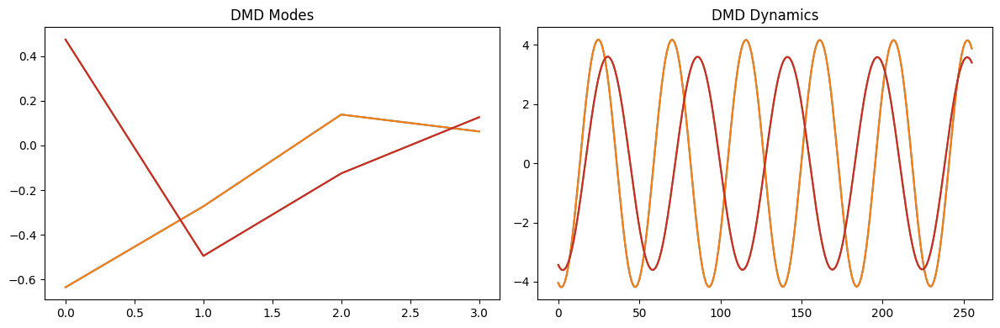

[[ 1.90972135  1.88107444  1.79581516 ... -1.81976943 -1.69145074
  -1.5120626 ]
 [ 6.01729568  5.97229218  5.83799403 ... -5.37073899 -5.06022056
  -4.6708503 ]
 [ 0.05092254 -0.28264586 -0.60742199 ...  0.51184106  0.82349855
   1.10979513]
 [ 0.33638498 -0.39314953 -1.11130182 ...  2.54807778  3.20876652
   3.82567769]]


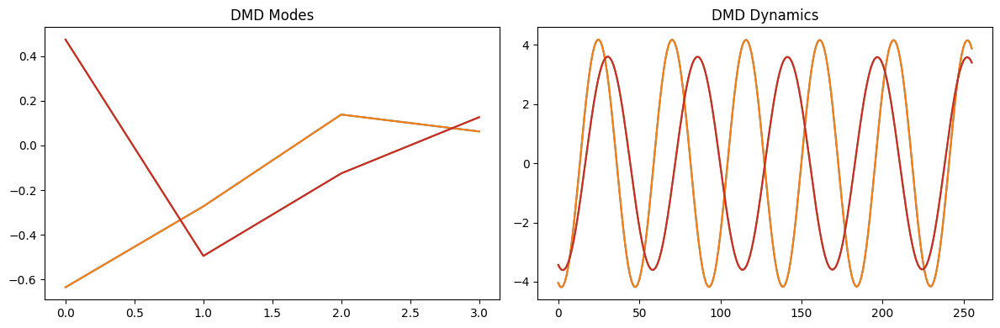

[[ 1.90972135  1.88107444  1.79581516 ... -1.81976943 -1.69145074
  -1.5120626 ]
 [ 6.01729568  5.97229218  5.83799403 ... -5.37073899 -5.06022056
  -4.6708503 ]
 [ 0.05092254 -0.28264586 -0.60742199 ...  0.51184106  0.82349855
   1.10979513]
 [ 0.33638498 -0.39314953 -1.11130182 ...  2.54807778  3.20876652
   3.82567769]]


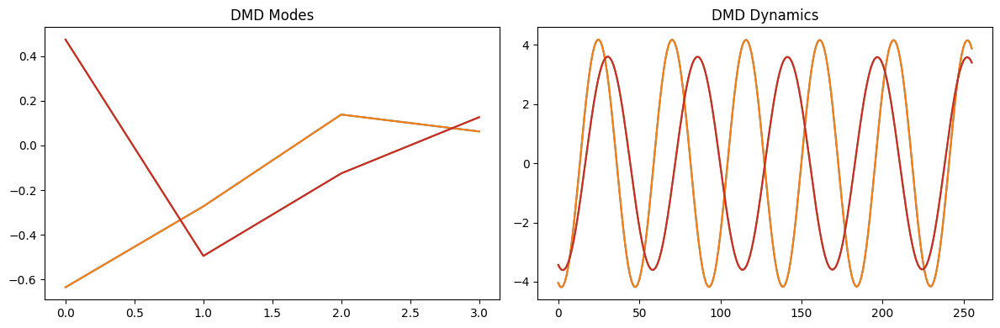

[[ 1.90972135  1.88107444  1.79581516 ... -1.81976943 -1.69145074
  -1.5120626 ]
 [ 6.01729568  5.97229218  5.83799403 ... -5.37073899 -5.06022056
  -4.6708503 ]
 [ 0.05092254 -0.28264586 -0.60742199 ...  0.51184106  0.82349855
   1.10979513]
 [ 0.33638498 -0.39314953 -1.11130182 ...  2.54807778  3.20876652
   3.82567769]]


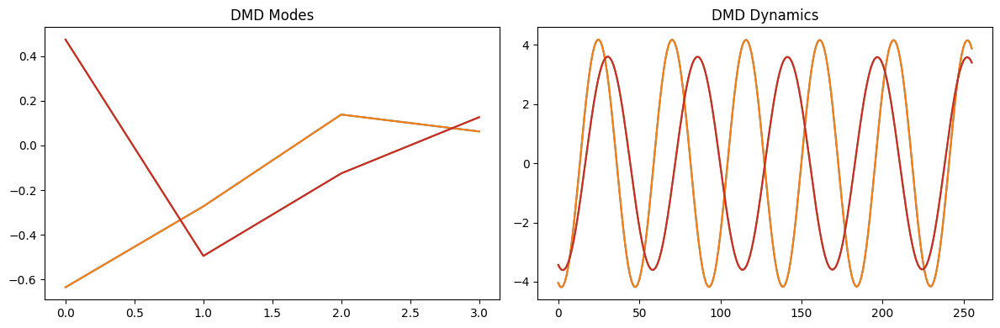

[[ 1.90972135  1.88107444  1.79581516 ... -1.81976943 -1.69145074
  -1.5120626 ]
 [ 6.01729568  5.97229218  5.83799403 ... -5.37073899 -5.06022056
  -4.6708503 ]
 [ 0.05092254 -0.28264586 -0.60742199 ...  0.51184106  0.82349855
   1.10979513]
 [ 0.33638498 -0.39314953 -1.11130182 ...  2.54807778  3.20876652
   3.82567769]]


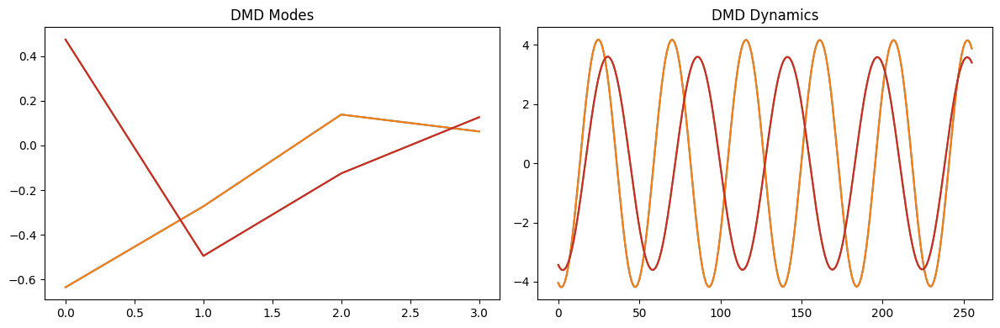

[[ 1.90972135  1.88107444  1.79581516 ... -1.81976943 -1.69145074
  -1.5120626 ]
 [ 6.01729568  5.97229218  5.83799403 ... -5.37073899 -5.06022056
  -4.6708503 ]
 [ 0.05092254 -0.28264586 -0.60742199 ...  0.51184106  0.82349855
   1.10979513]
 [ 0.33638498 -0.39314953 -1.11130182 ...  2.54807778  3.20876652
   3.82567769]]


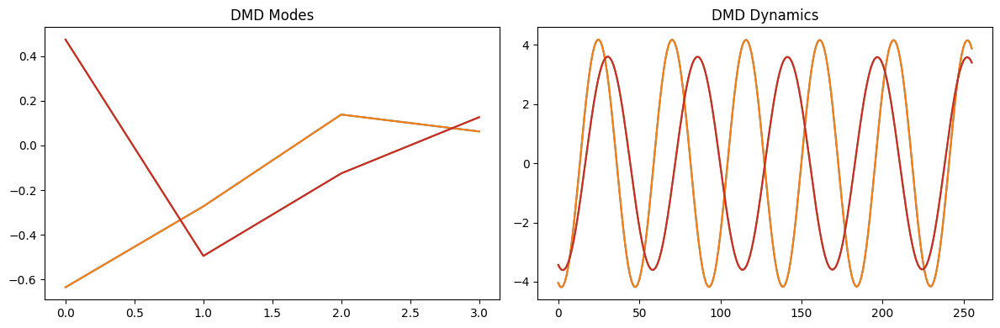

[[ 1.90972135  1.88107444  1.79581516 ... -1.81976943 -1.69145074
  -1.5120626 ]
 [ 6.01729568  5.97229218  5.83799403 ... -5.37073899 -5.06022056
  -4.6708503 ]
 [ 0.05092254 -0.28264586 -0.60742199 ...  0.51184106  0.82349855
   1.10979513]
 [ 0.33638498 -0.39314953 -1.11130182 ...  2.54807778  3.20876652
   3.82567769]]


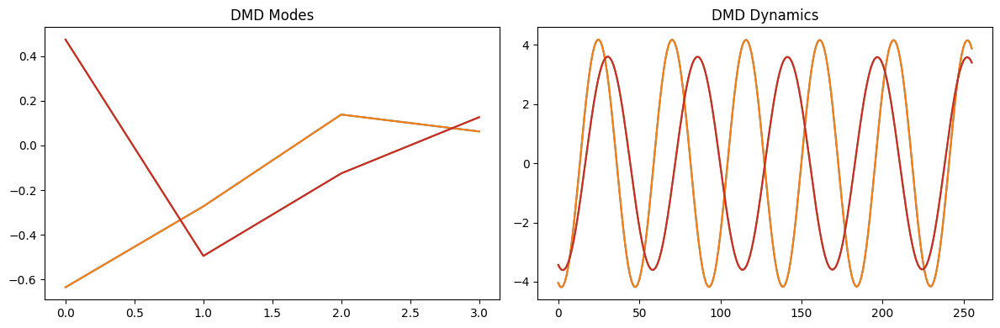

[[ 1.90972135  1.88107444  1.79581516 ... -1.81976943 -1.69145074
  -1.5120626 ]
 [ 6.01729568  5.97229218  5.83799403 ... -5.37073899 -5.06022056
  -4.6708503 ]
 [ 0.05092254 -0.28264586 -0.60742199 ...  0.51184106  0.82349855
   1.10979513]
 [ 0.33638498 -0.39314953 -1.11130182 ...  2.54807778  3.20876652
   3.82567769]]


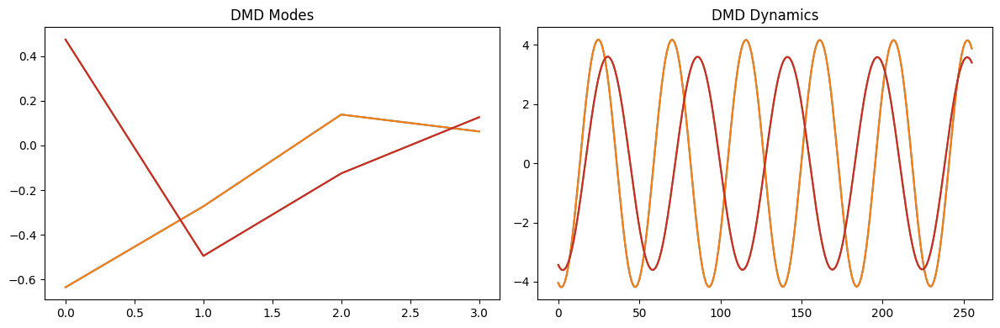

[[ 1.90972135  1.88107444  1.79581516 ... -1.81976943 -1.69145074
  -1.5120626 ]
 [ 6.01729568  5.97229218  5.83799403 ... -5.37073899 -5.06022056
  -4.6708503 ]
 [ 0.05092254 -0.28264586 -0.60742199 ...  0.51184106  0.82349855
   1.10979513]
 [ 0.33638498 -0.39314953 -1.11130182 ...  2.54807778  3.20876652
   3.82567769]]


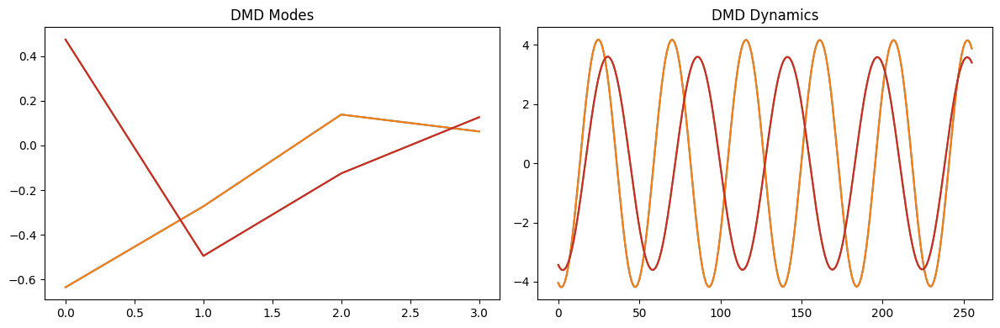

[[ 1.90972135  1.88107444  1.79581516 ... -1.81976943 -1.69145074
  -1.5120626 ]
 [ 6.01729568  5.97229218  5.83799403 ... -5.37073899 -5.06022056
  -4.6708503 ]
 [ 0.05092254 -0.28264586 -0.60742199 ...  0.51184106  0.82349855
   1.10979513]
 [ 0.33638498 -0.39314953 -1.11130182 ...  2.54807778  3.20876652
   3.82567769]]


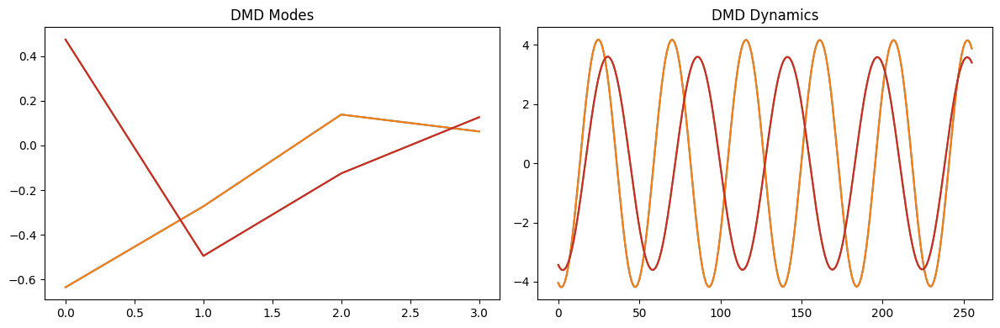

[[ 1.90972135  1.88107444  1.79581516 ... -1.81976943 -1.69145074
  -1.5120626 ]
 [ 6.01729568  5.97229218  5.83799403 ... -5.37073899 -5.06022056
  -4.6708503 ]
 [ 0.05092254 -0.28264586 -0.60742199 ...  0.51184106  0.82349855
   1.10979513]
 [ 0.33638498 -0.39314953 -1.11130182 ...  2.54807778  3.20876652
   3.82567769]]


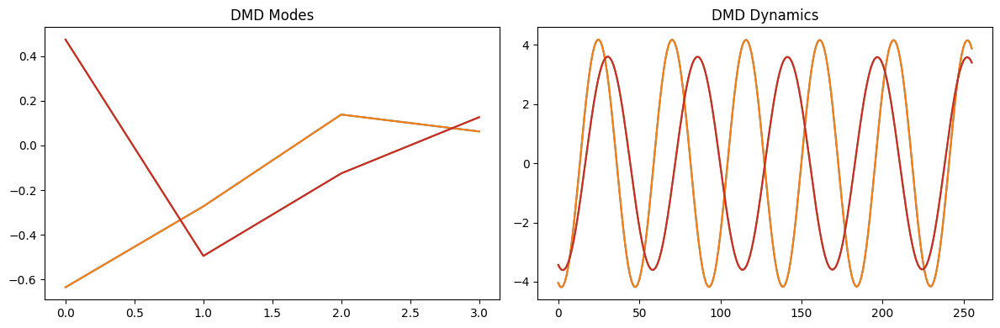

[[ 1.90972135  1.88107444  1.79581516 ... -1.81976943 -1.69145074
  -1.5120626 ]
 [ 6.01729568  5.97229218  5.83799403 ... -5.37073899 -5.06022056
  -4.6708503 ]
 [ 0.05092254 -0.28264586 -0.60742199 ...  0.51184106  0.82349855
   1.10979513]
 [ 0.33638498 -0.39314953 -1.11130182 ...  2.54807778  3.20876652
   3.82567769]]


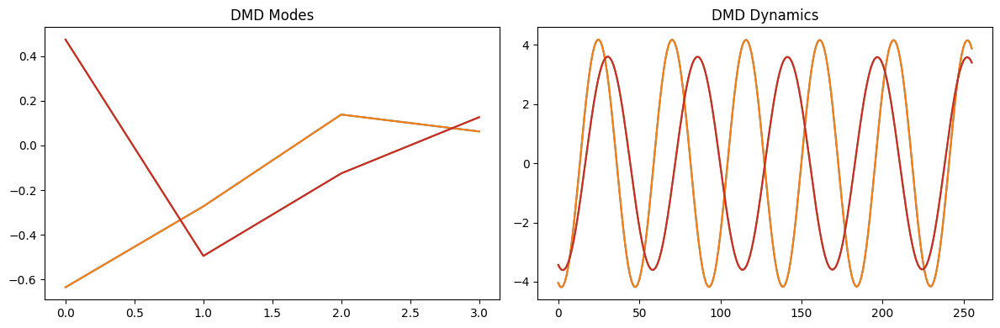

[[ 1.90972135  1.88107444  1.79581516 ... -1.81976943 -1.69145074
  -1.5120626 ]
 [ 6.01729568  5.97229218  5.83799403 ... -5.37073899 -5.06022056
  -4.6708503 ]
 [ 0.05092254 -0.28264586 -0.60742199 ...  0.51184106  0.82349855
   1.10979513]
 [ 0.33638498 -0.39314953 -1.11130182 ...  2.54807778  3.20876652
   3.82567769]]


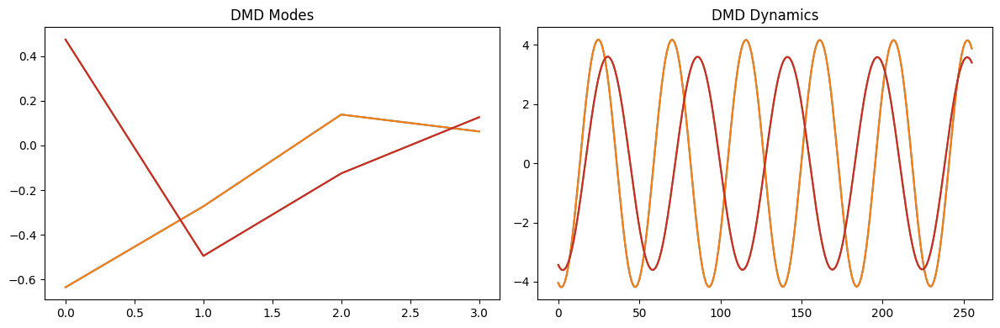

[[ 1.90972135  1.88107444  1.79581516 ... -1.81976943 -1.69145074
  -1.5120626 ]
 [ 6.01729568  5.97229218  5.83799403 ... -5.37073899 -5.06022056
  -4.6708503 ]
 [ 0.05092254 -0.28264586 -0.60742199 ...  0.51184106  0.82349855
   1.10979513]
 [ 0.33638498 -0.39314953 -1.11130182 ...  2.54807778  3.20876652
   3.82567769]]


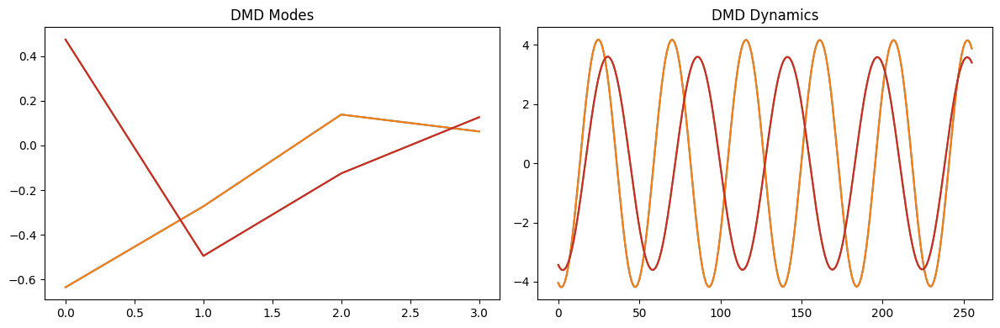

[[ 1.90972135  1.88107444  1.79581516 ... -1.81976943 -1.69145074
  -1.5120626 ]
 [ 6.01729568  5.97229218  5.83799403 ... -5.37073899 -5.06022056
  -4.6708503 ]
 [ 0.05092254 -0.28264586 -0.60742199 ...  0.51184106  0.82349855
   1.10979513]
 [ 0.33638498 -0.39314953 -1.11130182 ...  2.54807778  3.20876652
   3.82567769]]


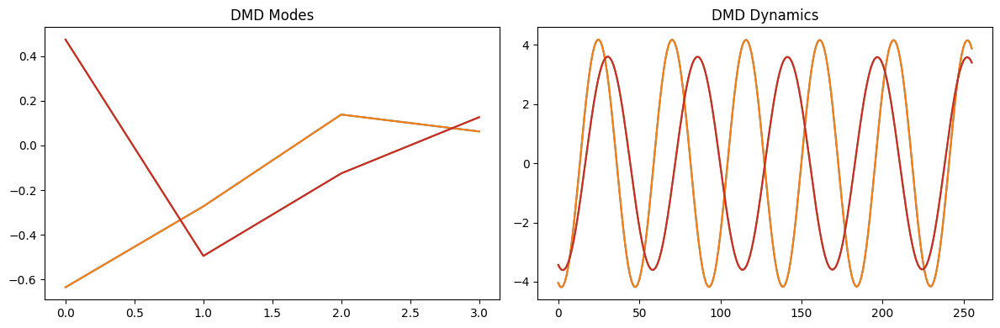

[[ 1.90972135  1.88107444  1.79581516 ... -1.81976943 -1.69145074
  -1.5120626 ]
 [ 6.01729568  5.97229218  5.83799403 ... -5.37073899 -5.06022056
  -4.6708503 ]
 [ 0.05092254 -0.28264586 -0.60742199 ...  0.51184106  0.82349855
   1.10979513]
 [ 0.33638498 -0.39314953 -1.11130182 ...  2.54807778  3.20876652
   3.82567769]]


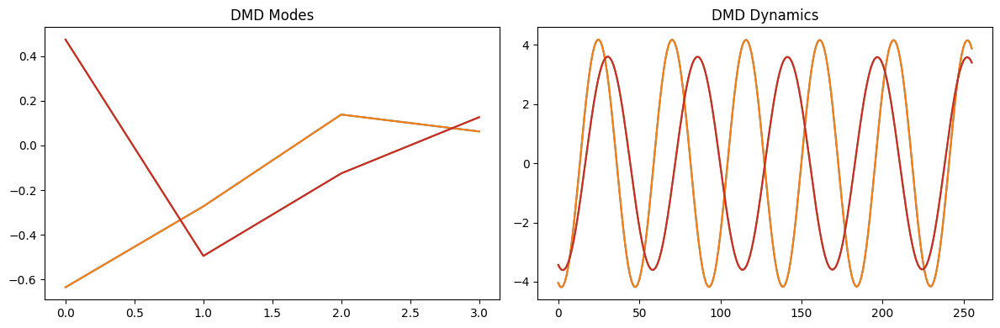

[[ 1.90972135  1.88107444  1.79581516 ... -1.81976943 -1.69145074
  -1.5120626 ]
 [ 6.01729568  5.97229218  5.83799403 ... -5.37073899 -5.06022056
  -4.6708503 ]
 [ 0.05092254 -0.28264586 -0.60742199 ...  0.51184106  0.82349855
   1.10979513]
 [ 0.33638498 -0.39314953 -1.11130182 ...  2.54807778  3.20876652
   3.82567769]]


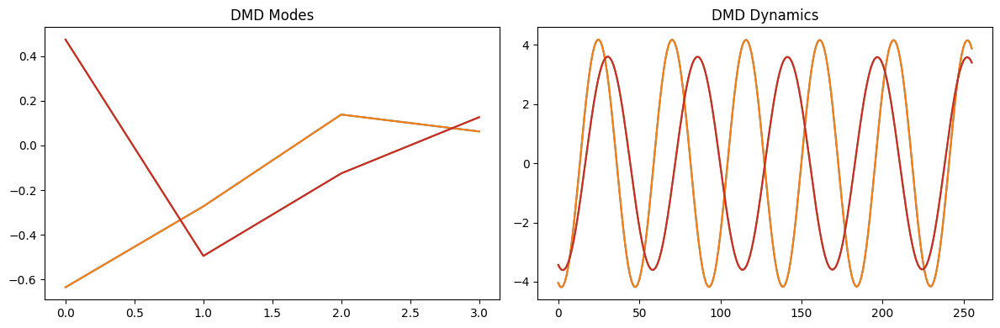

[[ 1.90972135  1.88107444  1.79581516 ... -1.81976943 -1.69145074
  -1.5120626 ]
 [ 6.01729568  5.97229218  5.83799403 ... -5.37073899 -5.06022056
  -4.6708503 ]
 [ 0.05092254 -0.28264586 -0.60742199 ...  0.51184106  0.82349855
   1.10979513]
 [ 0.33638498 -0.39314953 -1.11130182 ...  2.54807778  3.20876652
   3.82567769]]


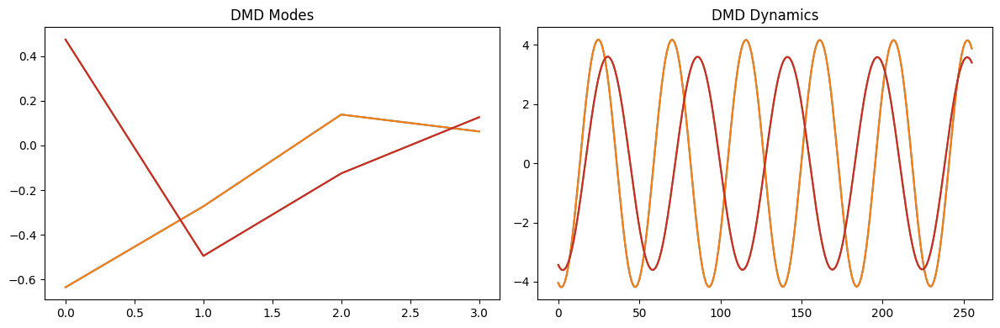

[[ 1.90972135  1.88107444  1.79581516 ... -1.81976943 -1.69145074
  -1.5120626 ]
 [ 6.01729568  5.97229218  5.83799403 ... -5.37073899 -5.06022056
  -4.6708503 ]
 [ 0.05092254 -0.28264586 -0.60742199 ...  0.51184106  0.82349855
   1.10979513]
 [ 0.33638498 -0.39314953 -1.11130182 ...  2.54807778  3.20876652
   3.82567769]]


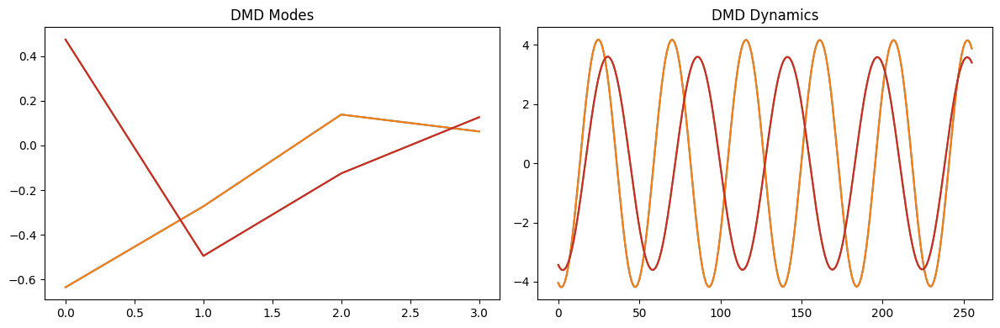

[[ 1.90972135  1.88107444  1.79581516 ... -1.81976943 -1.69145074
  -1.5120626 ]
 [ 6.01729568  5.97229218  5.83799403 ... -5.37073899 -5.06022056
  -4.6708503 ]
 [ 0.05092254 -0.28264586 -0.60742199 ...  0.51184106  0.82349855
   1.10979513]
 [ 0.33638498 -0.39314953 -1.11130182 ...  2.54807778  3.20876652
   3.82567769]]


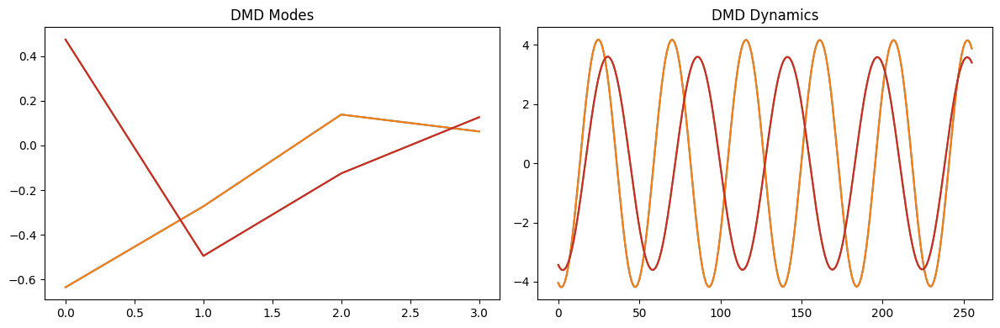

[[ 1.90972135  1.88107444  1.79581516 ... -1.81976943 -1.69145074
  -1.5120626 ]
 [ 6.01729568  5.97229218  5.83799403 ... -5.37073899 -5.06022056
  -4.6708503 ]
 [ 0.05092254 -0.28264586 -0.60742199 ...  0.51184106  0.82349855
   1.10979513]
 [ 0.33638498 -0.39314953 -1.11130182 ...  2.54807778  3.20876652
   3.82567769]]


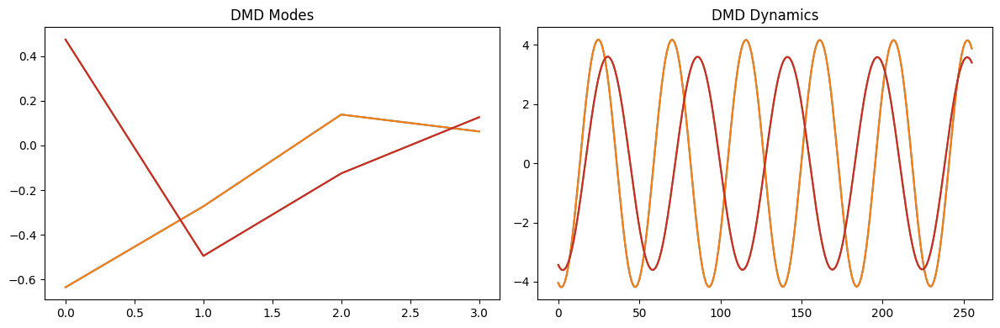

[[ 1.90972135  1.88107444  1.79581516 ... -1.81976943 -1.69145074
  -1.5120626 ]
 [ 6.01729568  5.97229218  5.83799403 ... -5.37073899 -5.06022056
  -4.6708503 ]
 [ 0.05092254 -0.28264586 -0.60742199 ...  0.51184106  0.82349855
   1.10979513]
 [ 0.33638498 -0.39314953 -1.11130182 ...  2.54807778  3.20876652
   3.82567769]]


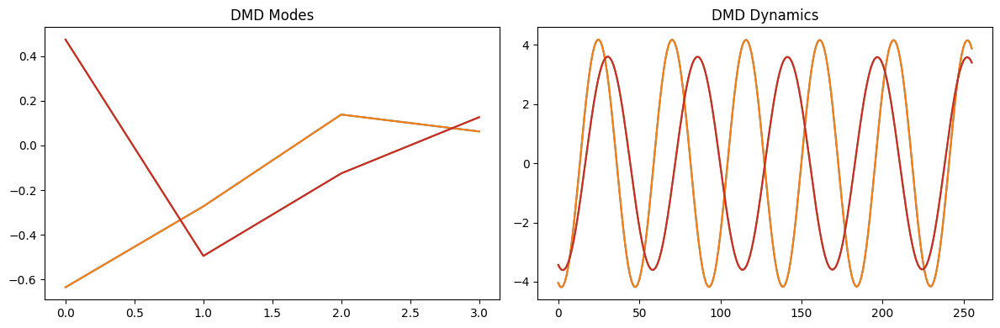

[[ 1.90972135  1.88107444  1.79581516 ... -1.81976943 -1.69145074
  -1.5120626 ]
 [ 6.01729568  5.97229218  5.83799403 ... -5.37073899 -5.06022056
  -4.6708503 ]
 [ 0.05092254 -0.28264586 -0.60742199 ...  0.51184106  0.82349855
   1.10979513]
 [ 0.33638498 -0.39314953 -1.11130182 ...  2.54807778  3.20876652
   3.82567769]]


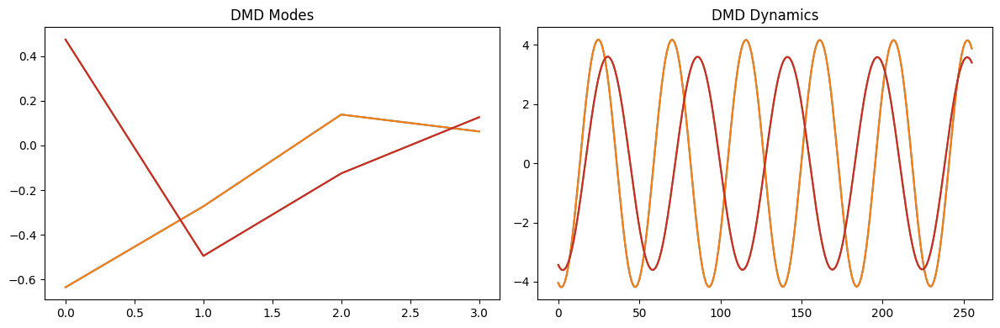

[[ 1.90972135  1.88107444  1.79581516 ... -1.81976943 -1.69145074
  -1.5120626 ]
 [ 6.01729568  5.97229218  5.83799403 ... -5.37073899 -5.06022056
  -4.6708503 ]
 [ 0.05092254 -0.28264586 -0.60742199 ...  0.51184106  0.82349855
   1.10979513]
 [ 0.33638498 -0.39314953 -1.11130182 ...  2.54807778  3.20876652
   3.82567769]]


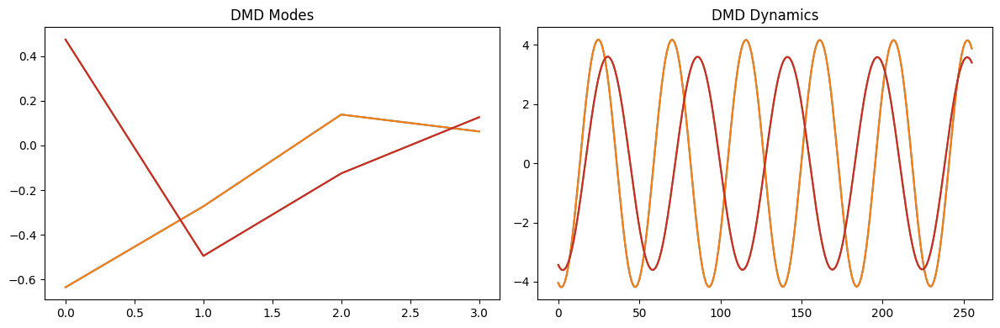

[[ 1.90972135  1.88107444  1.79581516 ... -1.81976943 -1.69145074
  -1.5120626 ]
 [ 6.01729568  5.97229218  5.83799403 ... -5.37073899 -5.06022056
  -4.6708503 ]
 [ 0.05092254 -0.28264586 -0.60742199 ...  0.51184106  0.82349855
   1.10979513]
 [ 0.33638498 -0.39314953 -1.11130182 ...  2.54807778  3.20876652
   3.82567769]]


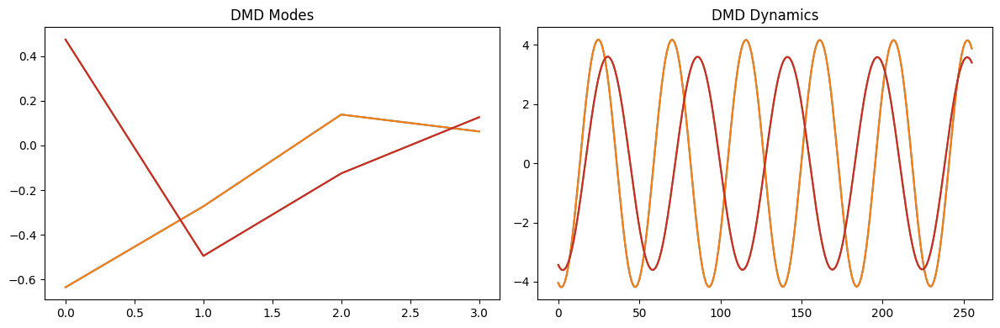

[[ 1.90972135  1.88107444  1.79581516 ... -1.81976943 -1.69145074
  -1.5120626 ]
 [ 6.01729568  5.97229218  5.83799403 ... -5.37073899 -5.06022056
  -4.6708503 ]
 [ 0.05092254 -0.28264586 -0.60742199 ...  0.51184106  0.82349855
   1.10979513]
 [ 0.33638498 -0.39314953 -1.11130182 ...  2.54807778  3.20876652
   3.82567769]]


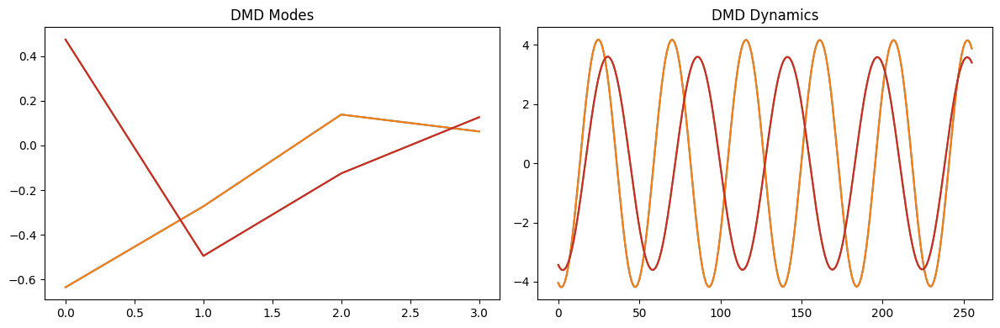

[[ 1.90972135  1.88107444  1.79581516 ... -1.81976943 -1.69145074
  -1.5120626 ]
 [ 6.01729568  5.97229218  5.83799403 ... -5.37073899 -5.06022056
  -4.6708503 ]
 [ 0.05092254 -0.28264586 -0.60742199 ...  0.51184106  0.82349855
   1.10979513]
 [ 0.33638498 -0.39314953 -1.11130182 ...  2.54807778  3.20876652
   3.82567769]]


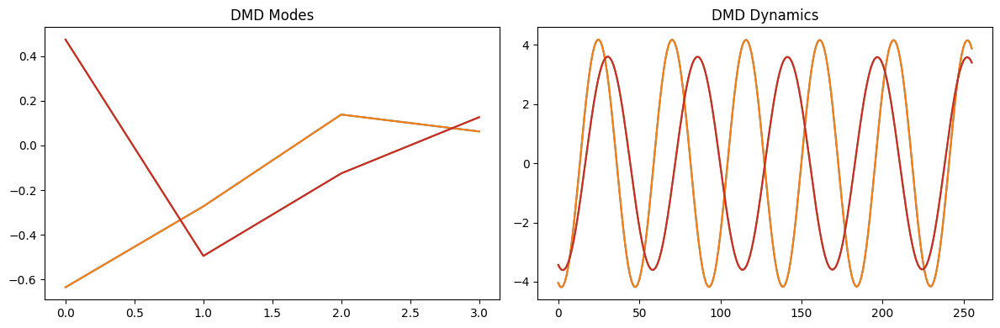

[[ 1.90972135  1.88107444  1.79581516 ... -1.81976943 -1.69145074
  -1.5120626 ]
 [ 6.01729568  5.97229218  5.83799403 ... -5.37073899 -5.06022056
  -4.6708503 ]
 [ 0.05092254 -0.28264586 -0.60742199 ...  0.51184106  0.82349855
   1.10979513]
 [ 0.33638498 -0.39314953 -1.11130182 ...  2.54807778  3.20876652
   3.82567769]]


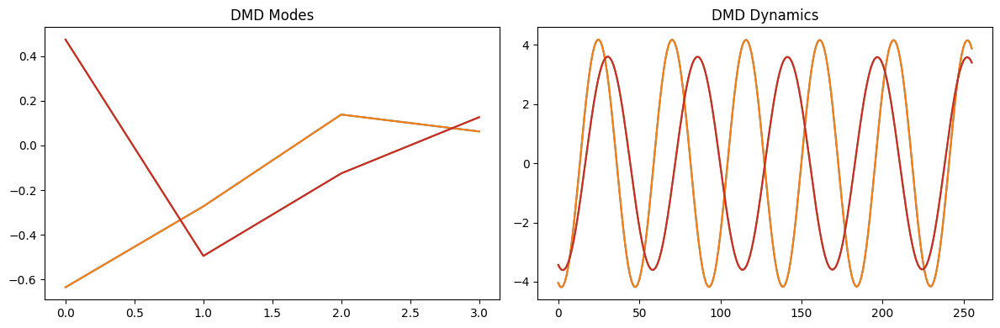

[[ 1.90972135  1.88107444  1.79581516 ... -1.81976943 -1.69145074
  -1.5120626 ]
 [ 6.01729568  5.97229218  5.83799403 ... -5.37073899 -5.06022056
  -4.6708503 ]
 [ 0.05092254 -0.28264586 -0.60742199 ...  0.51184106  0.82349855
   1.10979513]
 [ 0.33638498 -0.39314953 -1.11130182 ...  2.54807778  3.20876652
   3.82567769]]


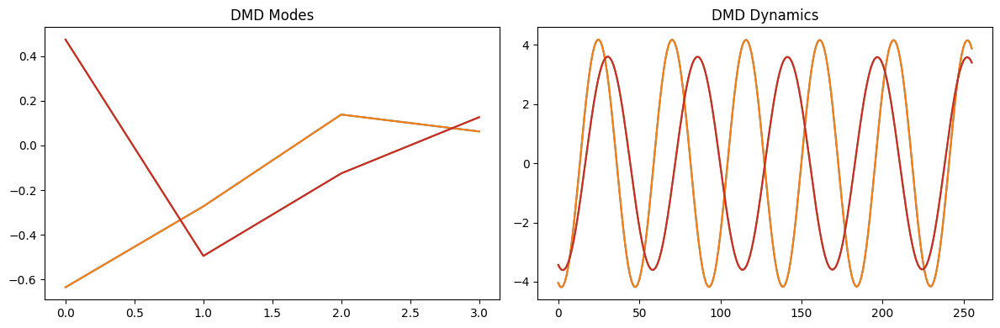

[[ 1.90972135  1.88107444  1.79581516 ... -1.81976943 -1.69145074
  -1.5120626 ]
 [ 6.01729568  5.97229218  5.83799403 ... -5.37073899 -5.06022056
  -4.6708503 ]
 [ 0.05092254 -0.28264586 -0.60742199 ...  0.51184106  0.82349855
   1.10979513]
 [ 0.33638498 -0.39314953 -1.11130182 ...  2.54807778  3.20876652
   3.82567769]]


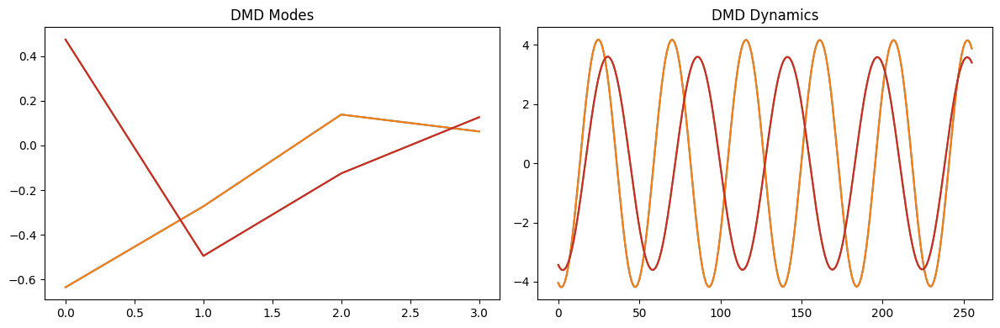

[[ 1.90972135  1.88107444  1.79581516 ... -1.81976943 -1.69145074
  -1.5120626 ]
 [ 6.01729568  5.97229218  5.83799403 ... -5.37073899 -5.06022056
  -4.6708503 ]
 [ 0.05092254 -0.28264586 -0.60742199 ...  0.51184106  0.82349855
   1.10979513]
 [ 0.33638498 -0.39314953 -1.11130182 ...  2.54807778  3.20876652
   3.82567769]]


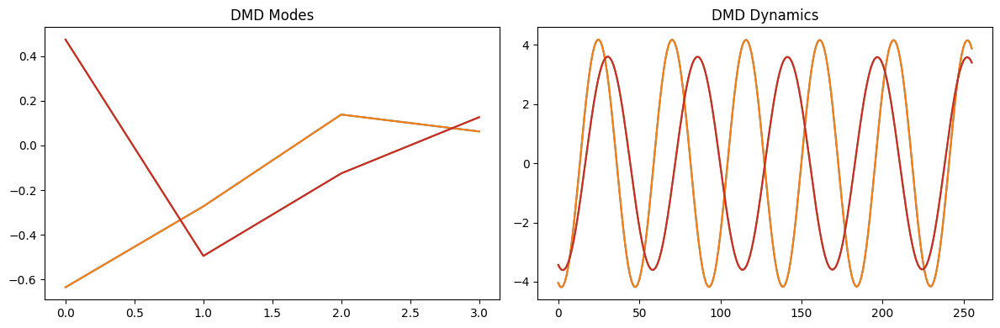

[[ 1.90972135  1.88107444  1.79581516 ... -1.81976943 -1.69145074
  -1.5120626 ]
 [ 6.01729568  5.97229218  5.83799403 ... -5.37073899 -5.06022056
  -4.6708503 ]
 [ 0.05092254 -0.28264586 -0.60742199 ...  0.51184106  0.82349855
   1.10979513]
 [ 0.33638498 -0.39314953 -1.11130182 ...  2.54807778  3.20876652
   3.82567769]]


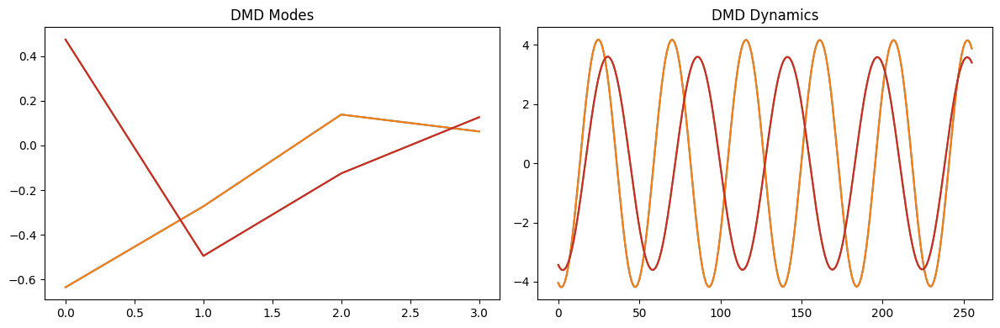

[[ 1.90972135  1.88107444  1.79581516 ... -1.81976943 -1.69145074
  -1.5120626 ]
 [ 6.01729568  5.97229218  5.83799403 ... -5.37073899 -5.06022056
  -4.6708503 ]
 [ 0.05092254 -0.28264586 -0.60742199 ...  0.51184106  0.82349855
   1.10979513]
 [ 0.33638498 -0.39314953 -1.11130182 ...  2.54807778  3.20876652
   3.82567769]]


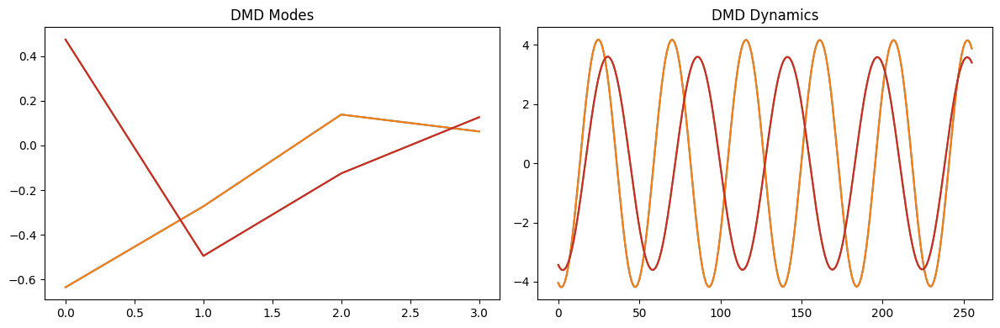

[[ 1.90972135  1.88107444  1.79581516 ... -1.81976943 -1.69145074
  -1.5120626 ]
 [ 6.01729568  5.97229218  5.83799403 ... -5.37073899 -5.06022056
  -4.6708503 ]
 [ 0.05092254 -0.28264586 -0.60742199 ...  0.51184106  0.82349855
   1.10979513]
 [ 0.33638498 -0.39314953 -1.11130182 ...  2.54807778  3.20876652
   3.82567769]]


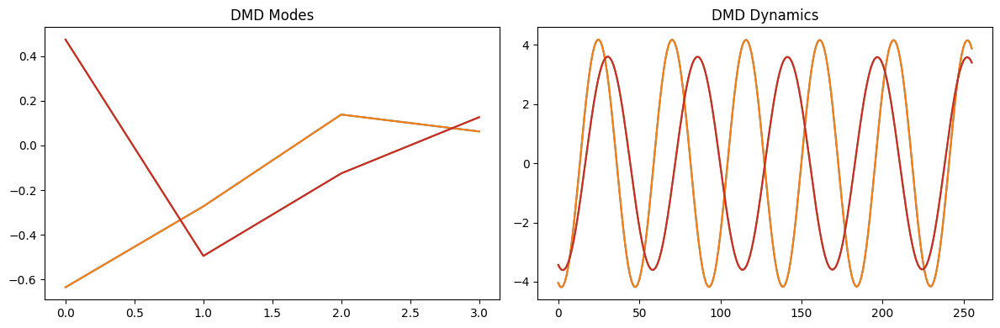

[[ 1.90972135  1.88107444  1.79581516 ... -1.81976943 -1.69145074
  -1.5120626 ]
 [ 6.01729568  5.97229218  5.83799403 ... -5.37073899 -5.06022056
  -4.6708503 ]
 [ 0.05092254 -0.28264586 -0.60742199 ...  0.51184106  0.82349855
   1.10979513]
 [ 0.33638498 -0.39314953 -1.11130182 ...  2.54807778  3.20876652
   3.82567769]]


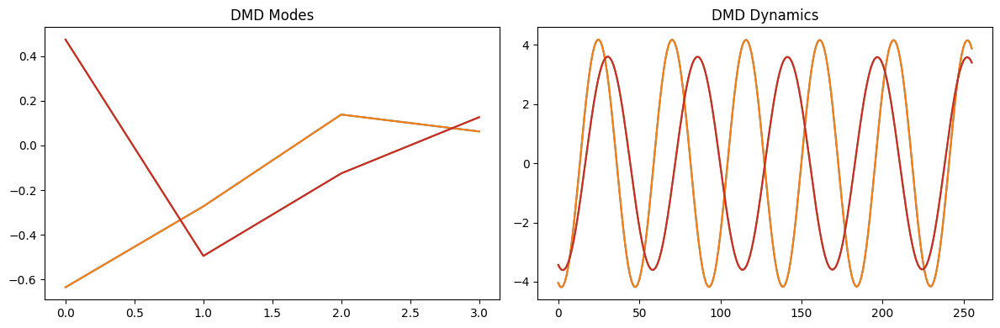

[[ 1.90972135  1.88107444  1.79581516 ... -1.81976943 -1.69145074
  -1.5120626 ]
 [ 6.01729568  5.97229218  5.83799403 ... -5.37073899 -5.06022056
  -4.6708503 ]
 [ 0.05092254 -0.28264586 -0.60742199 ...  0.51184106  0.82349855
   1.10979513]
 [ 0.33638498 -0.39314953 -1.11130182 ...  2.54807778  3.20876652
   3.82567769]]


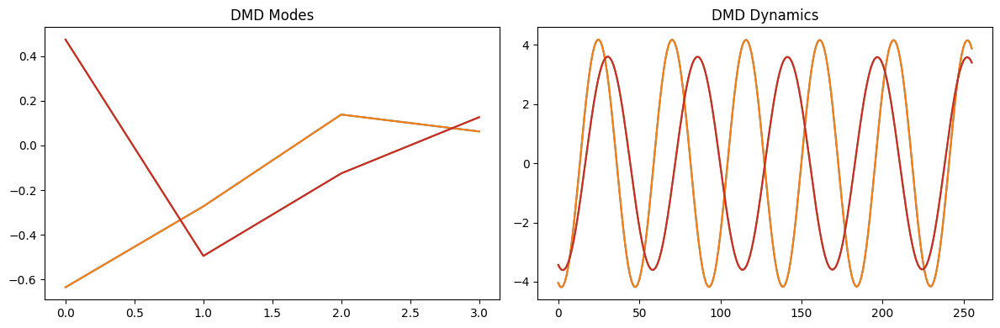

[[ 1.90972135  1.88107444  1.79581516 ... -1.81976943 -1.69145074
  -1.5120626 ]
 [ 6.01729568  5.97229218  5.83799403 ... -5.37073899 -5.06022056
  -4.6708503 ]
 [ 0.05092254 -0.28264586 -0.60742199 ...  0.51184106  0.82349855
   1.10979513]
 [ 0.33638498 -0.39314953 -1.11130182 ...  2.54807778  3.20876652
   3.82567769]]


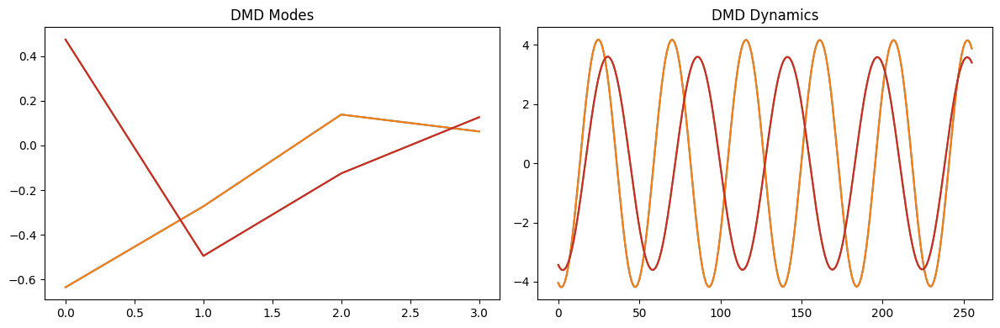

[[ 1.90972135  1.88107444  1.79581516 ... -1.81976943 -1.69145074
  -1.5120626 ]
 [ 6.01729568  5.97229218  5.83799403 ... -5.37073899 -5.06022056
  -4.6708503 ]
 [ 0.05092254 -0.28264586 -0.60742199 ...  0.51184106  0.82349855
   1.10979513]
 [ 0.33638498 -0.39314953 -1.11130182 ...  2.54807778  3.20876652
   3.82567769]]


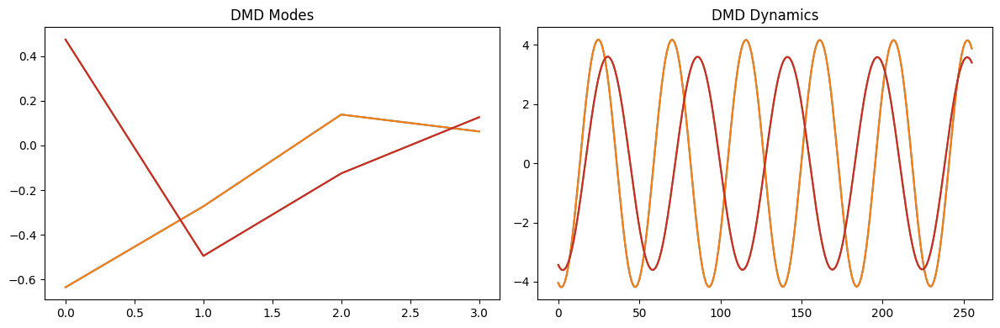

[[ 1.90972135  1.88107444  1.79581516 ... -1.81976943 -1.69145074
  -1.5120626 ]
 [ 6.01729568  5.97229218  5.83799403 ... -5.37073899 -5.06022056
  -4.6708503 ]
 [ 0.05092254 -0.28264586 -0.60742199 ...  0.51184106  0.82349855
   1.10979513]
 [ 0.33638498 -0.39314953 -1.11130182 ...  2.54807778  3.20876652
   3.82567769]]


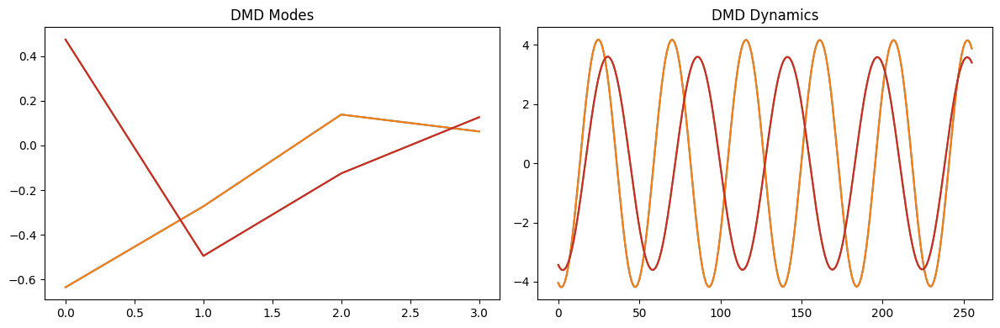

[[ 1.90972135  1.88107444  1.79581516 ... -1.81976943 -1.69145074
  -1.5120626 ]
 [ 6.01729568  5.97229218  5.83799403 ... -5.37073899 -5.06022056
  -4.6708503 ]
 [ 0.05092254 -0.28264586 -0.60742199 ...  0.51184106  0.82349855
   1.10979513]
 [ 0.33638498 -0.39314953 -1.11130182 ...  2.54807778  3.20876652
   3.82567769]]


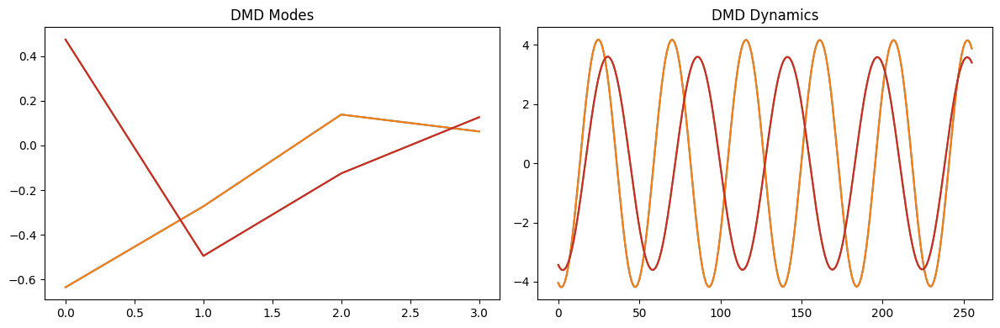

[[ 1.90972135  1.88107444  1.79581516 ... -1.81976943 -1.69145074
  -1.5120626 ]
 [ 6.01729568  5.97229218  5.83799403 ... -5.37073899 -5.06022056
  -4.6708503 ]
 [ 0.05092254 -0.28264586 -0.60742199 ...  0.51184106  0.82349855
   1.10979513]
 [ 0.33638498 -0.39314953 -1.11130182 ...  2.54807778  3.20876652
   3.82567769]]


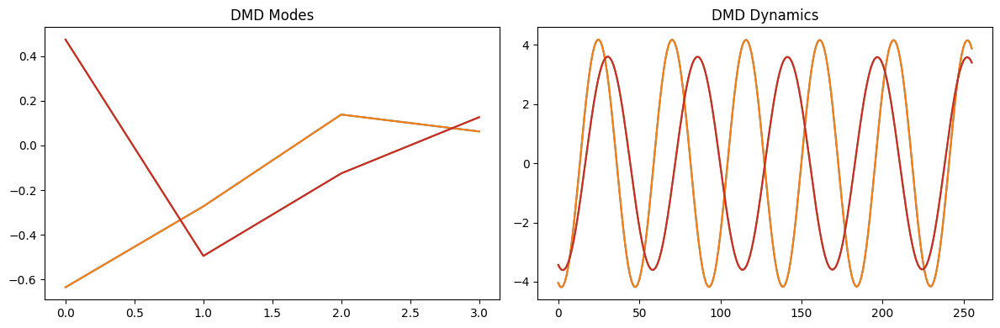

[[ 1.90972135  1.88107444  1.79581516 ... -1.81976943 -1.69145074
  -1.5120626 ]
 [ 6.01729568  5.97229218  5.83799403 ... -5.37073899 -5.06022056
  -4.6708503 ]
 [ 0.05092254 -0.28264586 -0.60742199 ...  0.51184106  0.82349855
   1.10979513]
 [ 0.33638498 -0.39314953 -1.11130182 ...  2.54807778  3.20876652
   3.82567769]]


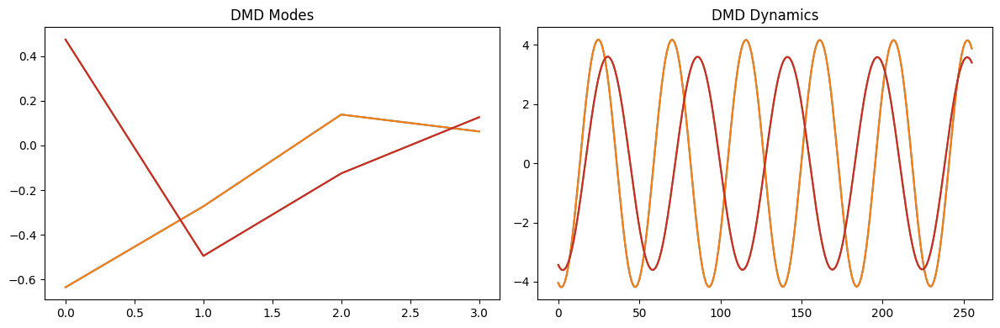

[[ 1.90972135  1.88107444  1.79581516 ... -1.81976943 -1.69145074
  -1.5120626 ]
 [ 6.01729568  5.97229218  5.83799403 ... -5.37073899 -5.06022056
  -4.6708503 ]
 [ 0.05092254 -0.28264586 -0.60742199 ...  0.51184106  0.82349855
   1.10979513]
 [ 0.33638498 -0.39314953 -1.11130182 ...  2.54807778  3.20876652
   3.82567769]]


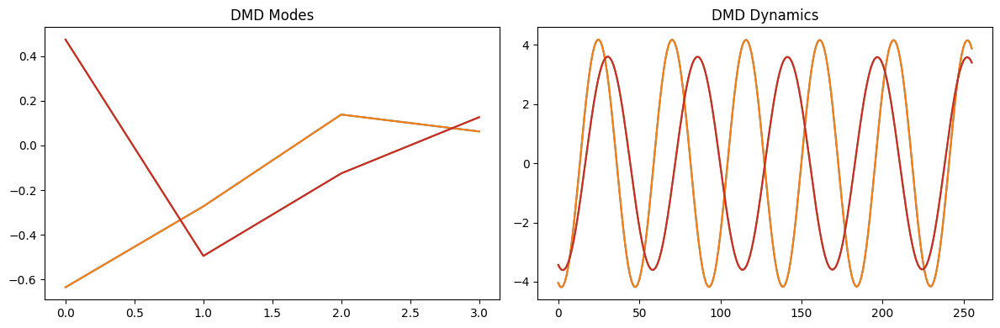

[[ 1.90972135  1.88107444  1.79581516 ... -1.81976943 -1.69145074
  -1.5120626 ]
 [ 6.01729568  5.97229218  5.83799403 ... -5.37073899 -5.06022056
  -4.6708503 ]
 [ 0.05092254 -0.28264586 -0.60742199 ...  0.51184106  0.82349855
   1.10979513]
 [ 0.33638498 -0.39314953 -1.11130182 ...  2.54807778  3.20876652
   3.82567769]]


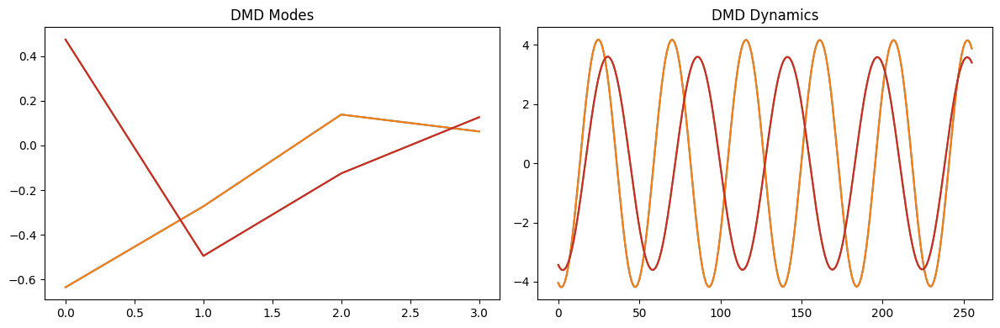

[[ 1.90972135  1.88107444  1.79581516 ... -1.81976943 -1.69145074
  -1.5120626 ]
 [ 6.01729568  5.97229218  5.83799403 ... -5.37073899 -5.06022056
  -4.6708503 ]
 [ 0.05092254 -0.28264586 -0.60742199 ...  0.51184106  0.82349855
   1.10979513]
 [ 0.33638498 -0.39314953 -1.11130182 ...  2.54807778  3.20876652
   3.82567769]]


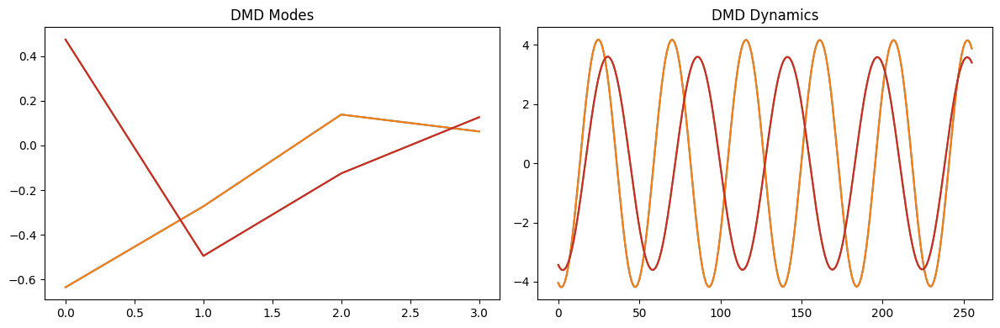

[[ 1.90972135  1.88107444  1.79581516 ... -1.81976943 -1.69145074
  -1.5120626 ]
 [ 6.01729568  5.97229218  5.83799403 ... -5.37073899 -5.06022056
  -4.6708503 ]
 [ 0.05092254 -0.28264586 -0.60742199 ...  0.51184106  0.82349855
   1.10979513]
 [ 0.33638498 -0.39314953 -1.11130182 ...  2.54807778  3.20876652
   3.82567769]]


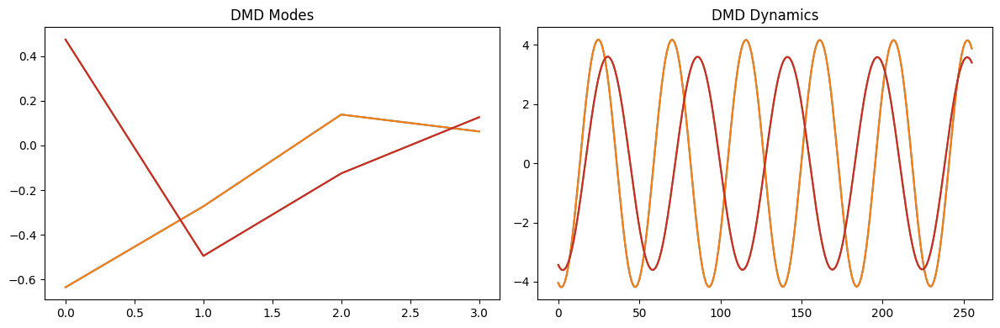

[[ 1.90972135  1.88107444  1.79581516 ... -1.81976943 -1.69145074
  -1.5120626 ]
 [ 6.01729568  5.97229218  5.83799403 ... -5.37073899 -5.06022056
  -4.6708503 ]
 [ 0.05092254 -0.28264586 -0.60742199 ...  0.51184106  0.82349855
   1.10979513]
 [ 0.33638498 -0.39314953 -1.11130182 ...  2.54807778  3.20876652
   3.82567769]]


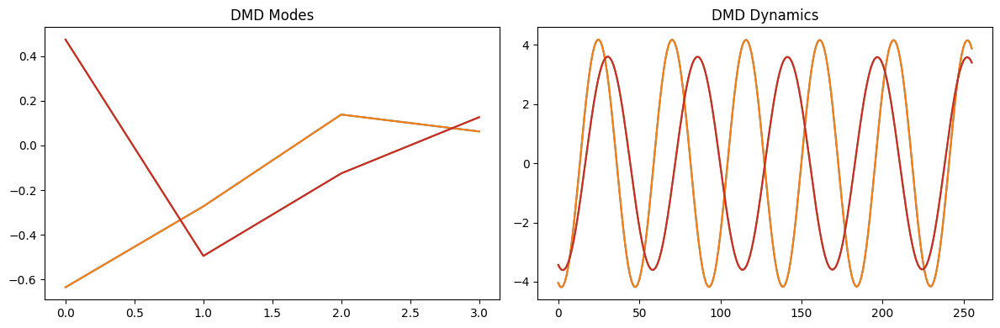

[[ 1.90972135  1.88107444  1.79581516 ... -1.81976943 -1.69145074
  -1.5120626 ]
 [ 6.01729568  5.97229218  5.83799403 ... -5.37073899 -5.06022056
  -4.6708503 ]
 [ 0.05092254 -0.28264586 -0.60742199 ...  0.51184106  0.82349855
   1.10979513]
 [ 0.33638498 -0.39314953 -1.11130182 ...  2.54807778  3.20876652
   3.82567769]]


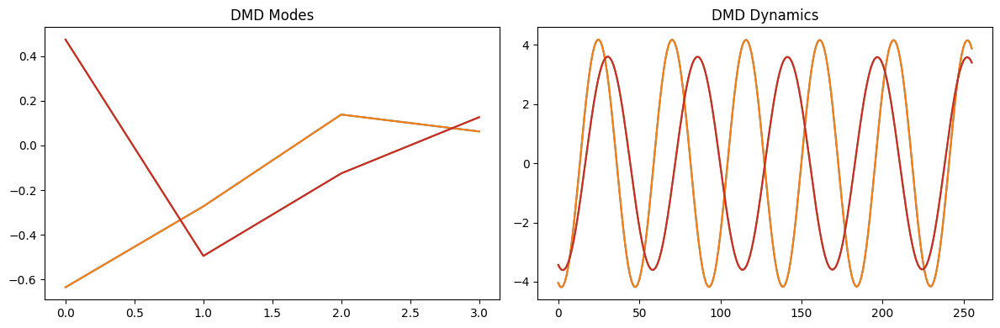

[[ 1.90972135  1.88107444  1.79581516 ... -1.81976943 -1.69145074
  -1.5120626 ]
 [ 6.01729568  5.97229218  5.83799403 ... -5.37073899 -5.06022056
  -4.6708503 ]
 [ 0.05092254 -0.28264586 -0.60742199 ...  0.51184106  0.82349855
   1.10979513]
 [ 0.33638498 -0.39314953 -1.11130182 ...  2.54807778  3.20876652
   3.82567769]]


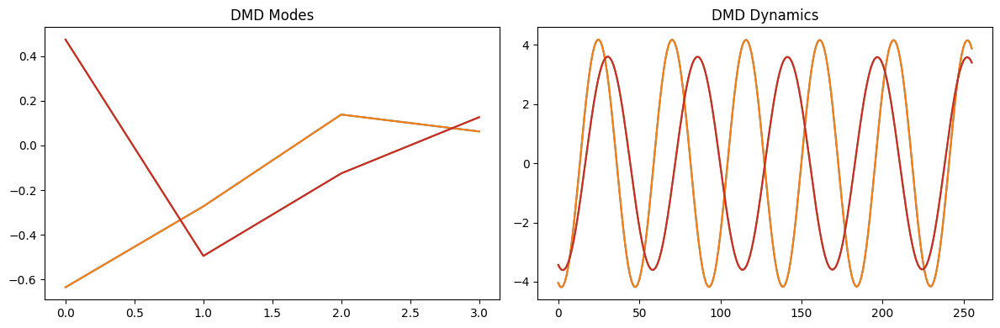

[[ 1.90972135  1.88107444  1.79581516 ... -1.81976943 -1.69145074
  -1.5120626 ]
 [ 6.01729568  5.97229218  5.83799403 ... -5.37073899 -5.06022056
  -4.6708503 ]
 [ 0.05092254 -0.28264586 -0.60742199 ...  0.51184106  0.82349855
   1.10979513]
 [ 0.33638498 -0.39314953 -1.11130182 ...  2.54807778  3.20876652
   3.82567769]]


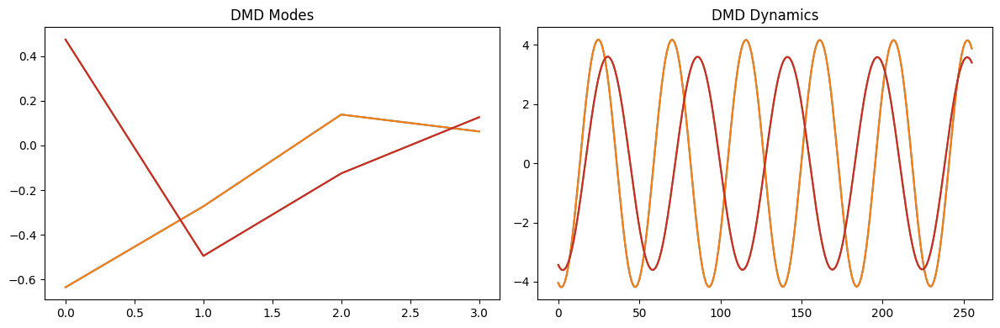

[[ 1.90972135  1.88107444  1.79581516 ... -1.81976943 -1.69145074
  -1.5120626 ]
 [ 6.01729568  5.97229218  5.83799403 ... -5.37073899 -5.06022056
  -4.6708503 ]
 [ 0.05092254 -0.28264586 -0.60742199 ...  0.51184106  0.82349855
   1.10979513]
 [ 0.33638498 -0.39314953 -1.11130182 ...  2.54807778  3.20876652
   3.82567769]]


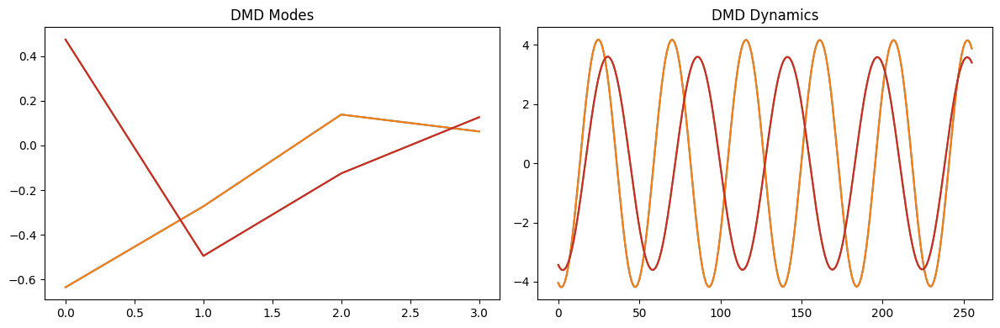

[[ 1.90972135  1.88107444  1.79581516 ... -1.81976943 -1.69145074
  -1.5120626 ]
 [ 6.01729568  5.97229218  5.83799403 ... -5.37073899 -5.06022056
  -4.6708503 ]
 [ 0.05092254 -0.28264586 -0.60742199 ...  0.51184106  0.82349855
   1.10979513]
 [ 0.33638498 -0.39314953 -1.11130182 ...  2.54807778  3.20876652
   3.82567769]]


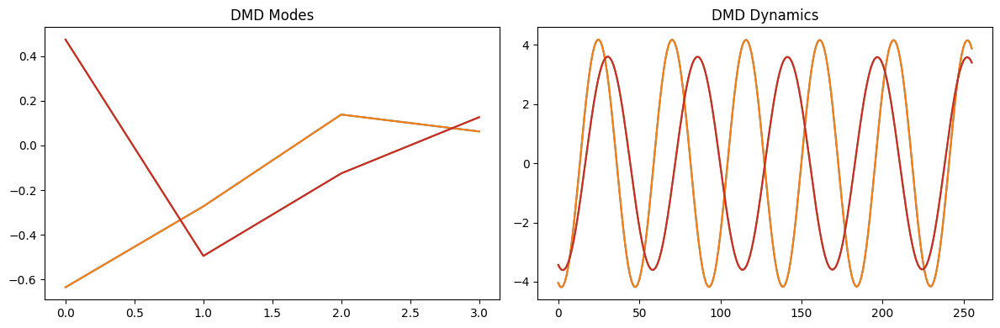

[[ 1.90972135  1.88107444  1.79581516 ... -1.81976943 -1.69145074
  -1.5120626 ]
 [ 6.01729568  5.97229218  5.83799403 ... -5.37073899 -5.06022056
  -4.6708503 ]
 [ 0.05092254 -0.28264586 -0.60742199 ...  0.51184106  0.82349855
   1.10979513]
 [ 0.33638498 -0.39314953 -1.11130182 ...  2.54807778  3.20876652
   3.82567769]]


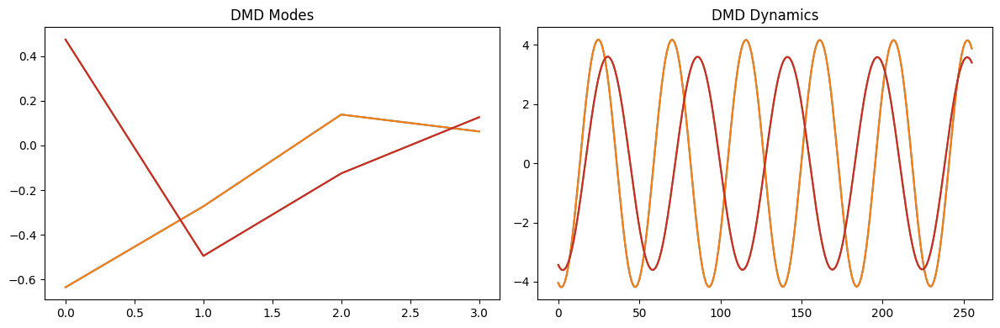

[[ 1.90972135  1.88107444  1.79581516 ... -1.81976943 -1.69145074
  -1.5120626 ]
 [ 6.01729568  5.97229218  5.83799403 ... -5.37073899 -5.06022056
  -4.6708503 ]
 [ 0.05092254 -0.28264586 -0.60742199 ...  0.51184106  0.82349855
   1.10979513]
 [ 0.33638498 -0.39314953 -1.11130182 ...  2.54807778  3.20876652
   3.82567769]]


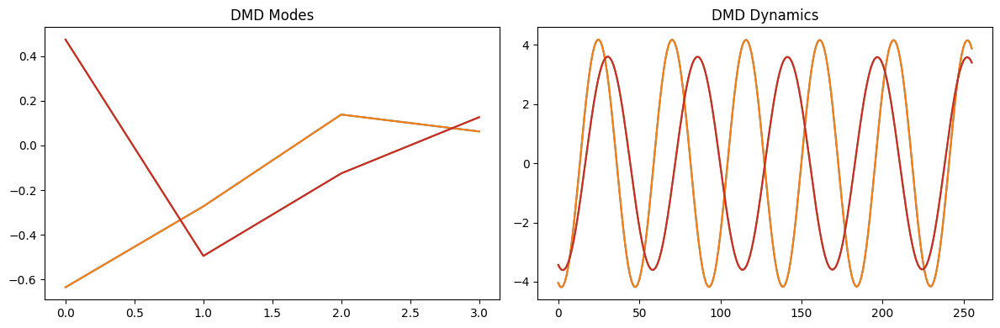

[[ 1.90972135  1.88107444  1.79581516 ... -1.81976943 -1.69145074
  -1.5120626 ]
 [ 6.01729568  5.97229218  5.83799403 ... -5.37073899 -5.06022056
  -4.6708503 ]
 [ 0.05092254 -0.28264586 -0.60742199 ...  0.51184106  0.82349855
   1.10979513]
 [ 0.33638498 -0.39314953 -1.11130182 ...  2.54807778  3.20876652
   3.82567769]]


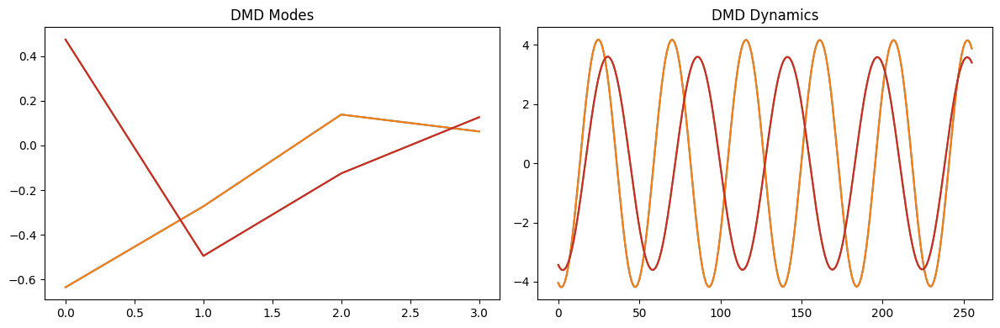

[[ 1.90972135  1.88107444  1.79581516 ... -1.81976943 -1.69145074
  -1.5120626 ]
 [ 6.01729568  5.97229218  5.83799403 ... -5.37073899 -5.06022056
  -4.6708503 ]
 [ 0.05092254 -0.28264586 -0.60742199 ...  0.51184106  0.82349855
   1.10979513]
 [ 0.33638498 -0.39314953 -1.11130182 ...  2.54807778  3.20876652
   3.82567769]]


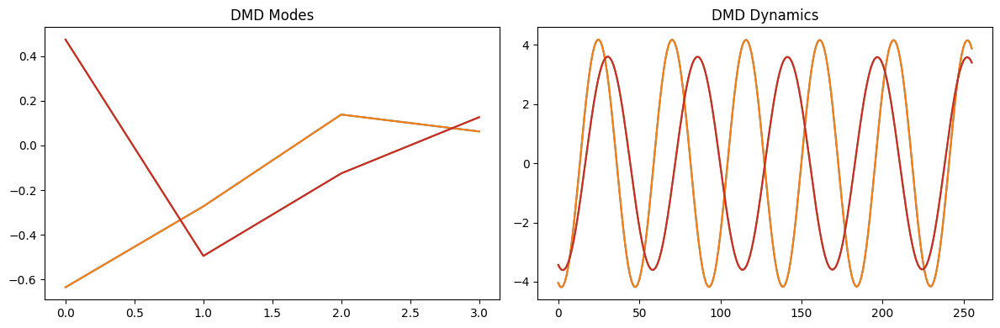

[[ 1.90972135  1.88107444  1.79581516 ... -1.81976943 -1.69145074
  -1.5120626 ]
 [ 6.01729568  5.97229218  5.83799403 ... -5.37073899 -5.06022056
  -4.6708503 ]
 [ 0.05092254 -0.28264586 -0.60742199 ...  0.51184106  0.82349855
   1.10979513]
 [ 0.33638498 -0.39314953 -1.11130182 ...  2.54807778  3.20876652
   3.82567769]]


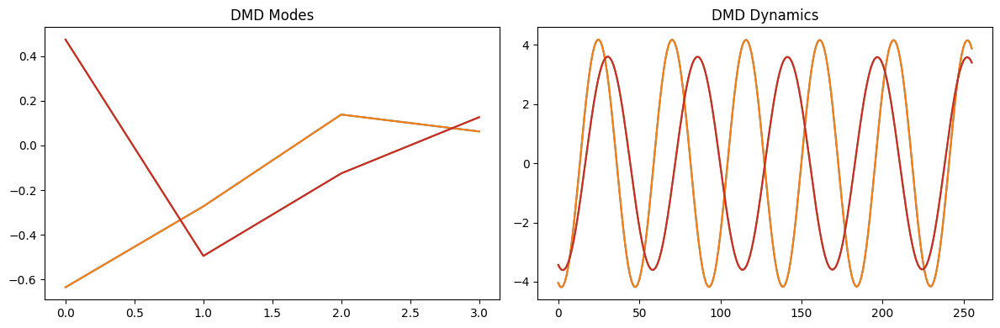

[[ 1.90972135  1.88107444  1.79581516 ... -1.81976943 -1.69145074
  -1.5120626 ]
 [ 6.01729568  5.97229218  5.83799403 ... -5.37073899 -5.06022056
  -4.6708503 ]
 [ 0.05092254 -0.28264586 -0.60742199 ...  0.51184106  0.82349855
   1.10979513]
 [ 0.33638498 -0.39314953 -1.11130182 ...  2.54807778  3.20876652
   3.82567769]]


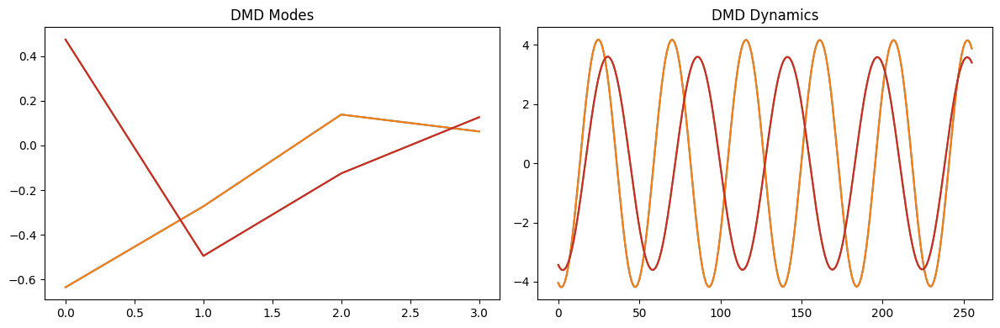

[[ 1.90972135  1.88107444  1.79581516 ... -1.81976943 -1.69145074
  -1.5120626 ]
 [ 6.01729568  5.97229218  5.83799403 ... -5.37073899 -5.06022056
  -4.6708503 ]
 [ 0.05092254 -0.28264586 -0.60742199 ...  0.51184106  0.82349855
   1.10979513]
 [ 0.33638498 -0.39314953 -1.11130182 ...  2.54807778  3.20876652
   3.82567769]]


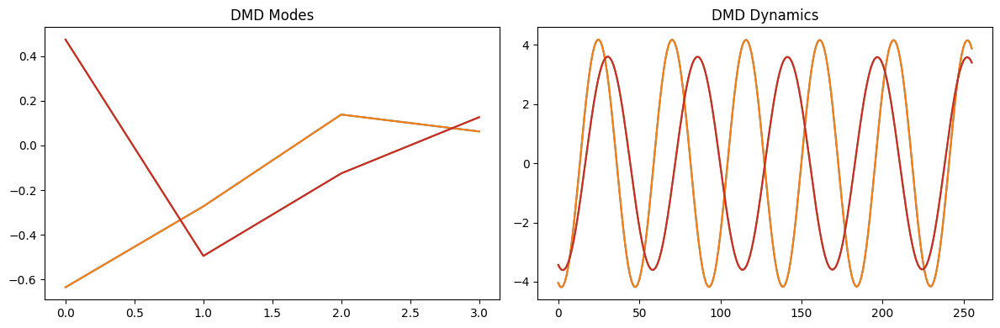

[[ 1.90972135  1.88107444  1.79581516 ... -1.81976943 -1.69145074
  -1.5120626 ]
 [ 6.01729568  5.97229218  5.83799403 ... -5.37073899 -5.06022056
  -4.6708503 ]
 [ 0.05092254 -0.28264586 -0.60742199 ...  0.51184106  0.82349855
   1.10979513]
 [ 0.33638498 -0.39314953 -1.11130182 ...  2.54807778  3.20876652
   3.82567769]]


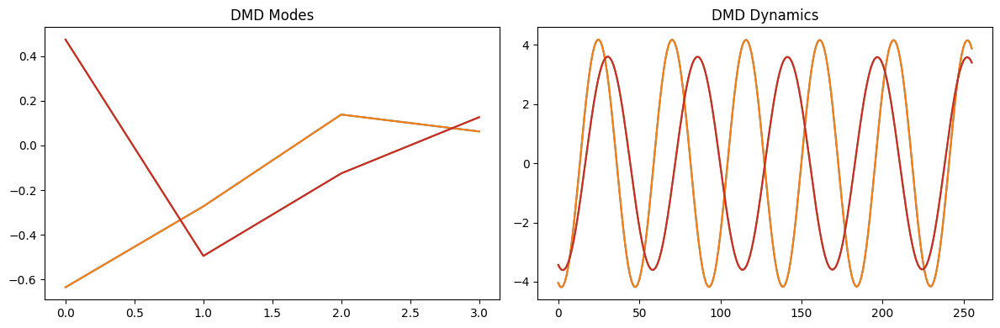

[[ 1.90972135  1.88107444  1.79581516 ... -1.81976943 -1.69145074
  -1.5120626 ]
 [ 6.01729568  5.97229218  5.83799403 ... -5.37073899 -5.06022056
  -4.6708503 ]
 [ 0.05092254 -0.28264586 -0.60742199 ...  0.51184106  0.82349855
   1.10979513]
 [ 0.33638498 -0.39314953 -1.11130182 ...  2.54807778  3.20876652
   3.82567769]]


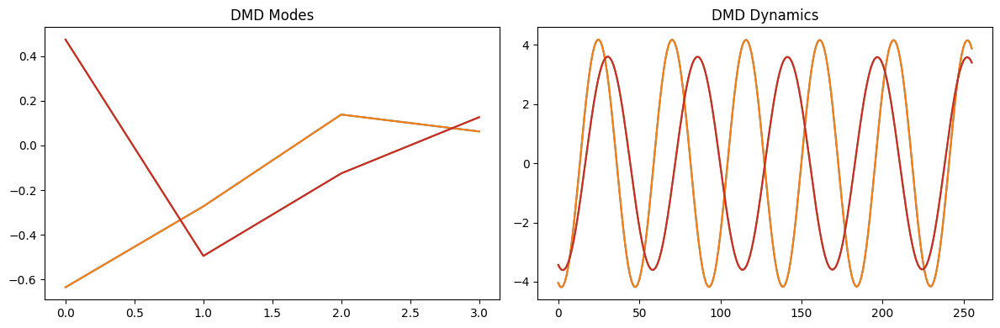

[[ 1.90972135  1.88107444  1.79581516 ... -1.81976943 -1.69145074
  -1.5120626 ]
 [ 6.01729568  5.97229218  5.83799403 ... -5.37073899 -5.06022056
  -4.6708503 ]
 [ 0.05092254 -0.28264586 -0.60742199 ...  0.51184106  0.82349855
   1.10979513]
 [ 0.33638498 -0.39314953 -1.11130182 ...  2.54807778  3.20876652
   3.82567769]]


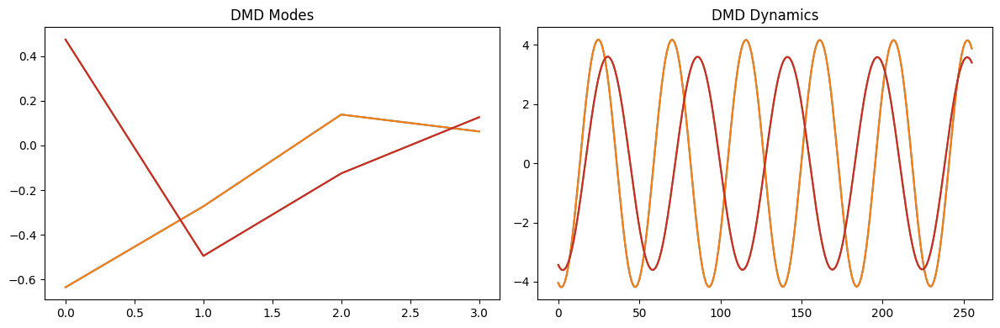

[[ 1.90972135  1.88107444  1.79581516 ... -1.81976943 -1.69145074
  -1.5120626 ]
 [ 6.01729568  5.97229218  5.83799403 ... -5.37073899 -5.06022056
  -4.6708503 ]
 [ 0.05092254 -0.28264586 -0.60742199 ...  0.51184106  0.82349855
   1.10979513]
 [ 0.33638498 -0.39314953 -1.11130182 ...  2.54807778  3.20876652
   3.82567769]]


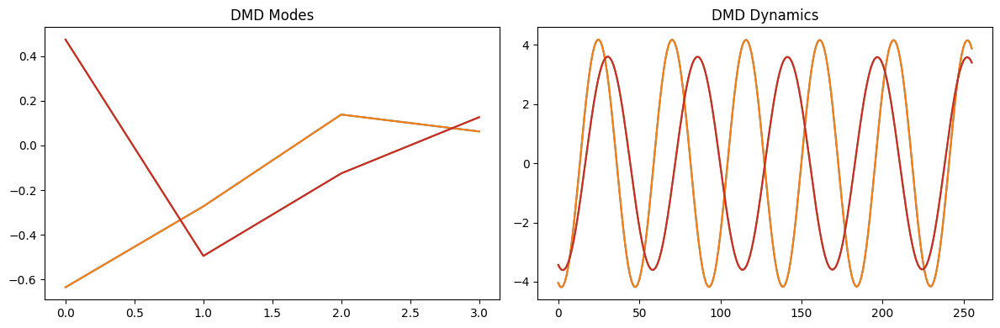

[[ 1.90972135  1.88107444  1.79581516 ... -1.81976943 -1.69145074
  -1.5120626 ]
 [ 6.01729568  5.97229218  5.83799403 ... -5.37073899 -5.06022056
  -4.6708503 ]
 [ 0.05092254 -0.28264586 -0.60742199 ...  0.51184106  0.82349855
   1.10979513]
 [ 0.33638498 -0.39314953 -1.11130182 ...  2.54807778  3.20876652
   3.82567769]]


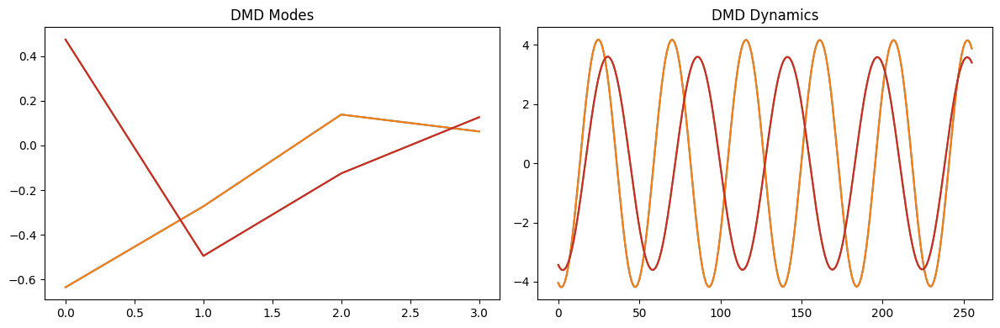

[[ 1.90972135  1.88107444  1.79581516 ... -1.81976943 -1.69145074
  -1.5120626 ]
 [ 6.01729568  5.97229218  5.83799403 ... -5.37073899 -5.06022056
  -4.6708503 ]
 [ 0.05092254 -0.28264586 -0.60742199 ...  0.51184106  0.82349855
   1.10979513]
 [ 0.33638498 -0.39314953 -1.11130182 ...  2.54807778  3.20876652
   3.82567769]]


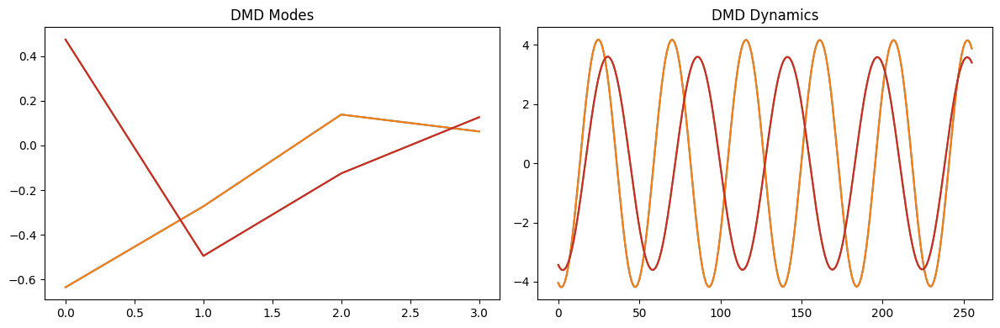

[[ 1.90972135  1.88107444  1.79581516 ... -1.81976943 -1.69145074
  -1.5120626 ]
 [ 6.01729568  5.97229218  5.83799403 ... -5.37073899 -5.06022056
  -4.6708503 ]
 [ 0.05092254 -0.28264586 -0.60742199 ...  0.51184106  0.82349855
   1.10979513]
 [ 0.33638498 -0.39314953 -1.11130182 ...  2.54807778  3.20876652
   3.82567769]]


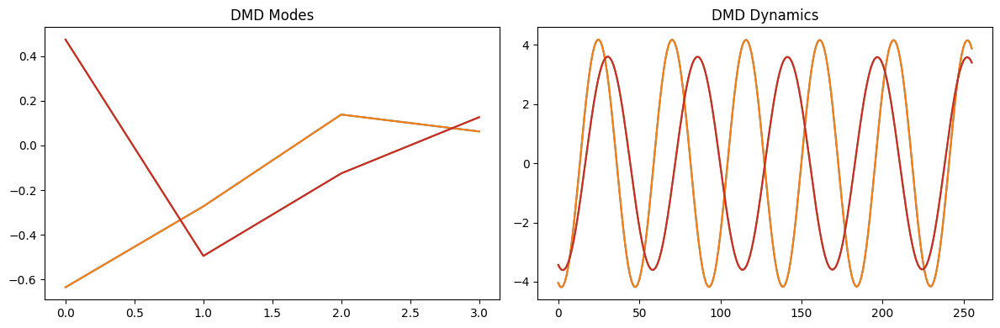

[[ 1.90972135  1.88107444  1.79581516 ... -1.81976943 -1.69145074
  -1.5120626 ]
 [ 6.01729568  5.97229218  5.83799403 ... -5.37073899 -5.06022056
  -4.6708503 ]
 [ 0.05092254 -0.28264586 -0.60742199 ...  0.51184106  0.82349855
   1.10979513]
 [ 0.33638498 -0.39314953 -1.11130182 ...  2.54807778  3.20876652
   3.82567769]]


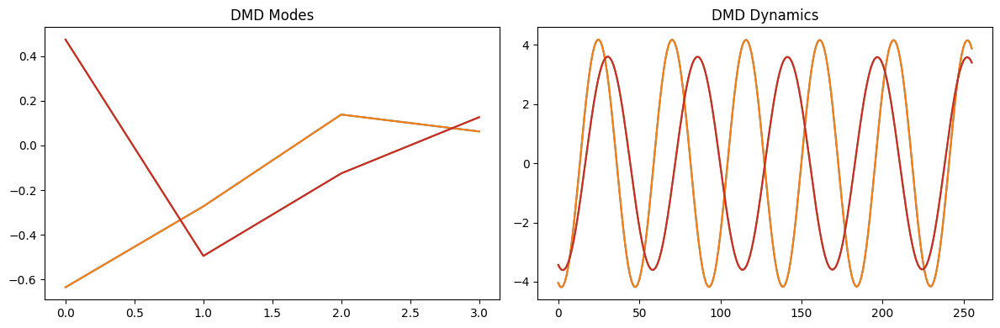

[[ 1.90972135  1.88107444  1.79581516 ... -1.81976943 -1.69145074
  -1.5120626 ]
 [ 6.01729568  5.97229218  5.83799403 ... -5.37073899 -5.06022056
  -4.6708503 ]
 [ 0.05092254 -0.28264586 -0.60742199 ...  0.51184106  0.82349855
   1.10979513]
 [ 0.33638498 -0.39314953 -1.11130182 ...  2.54807778  3.20876652
   3.82567769]]


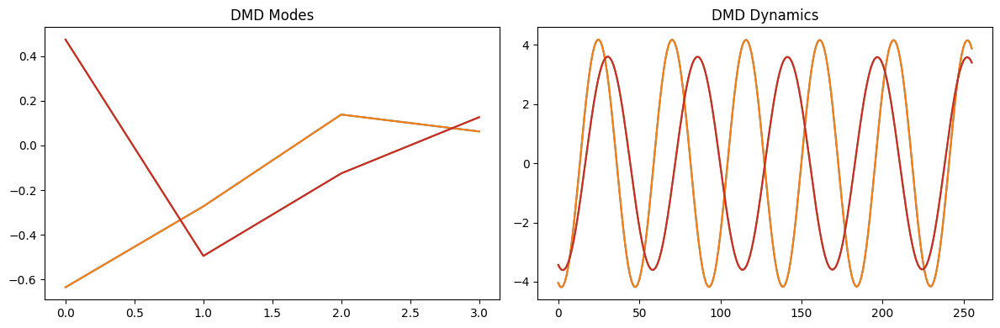

[[ 1.90972135  1.88107444  1.79581516 ... -1.81976943 -1.69145074
  -1.5120626 ]
 [ 6.01729568  5.97229218  5.83799403 ... -5.37073899 -5.06022056
  -4.6708503 ]
 [ 0.05092254 -0.28264586 -0.60742199 ...  0.51184106  0.82349855
   1.10979513]
 [ 0.33638498 -0.39314953 -1.11130182 ...  2.54807778  3.20876652
   3.82567769]]


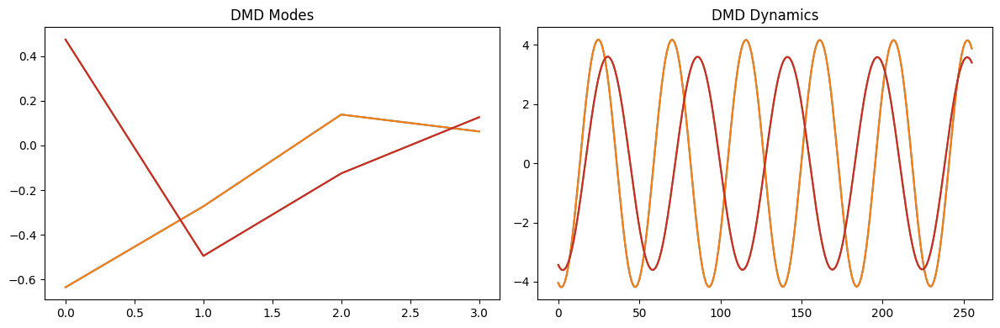

[[ 1.90972135  1.88107444  1.79581516 ... -1.81976943 -1.69145074
  -1.5120626 ]
 [ 6.01729568  5.97229218  5.83799403 ... -5.37073899 -5.06022056
  -4.6708503 ]
 [ 0.05092254 -0.28264586 -0.60742199 ...  0.51184106  0.82349855
   1.10979513]
 [ 0.33638498 -0.39314953 -1.11130182 ...  2.54807778  3.20876652
   3.82567769]]


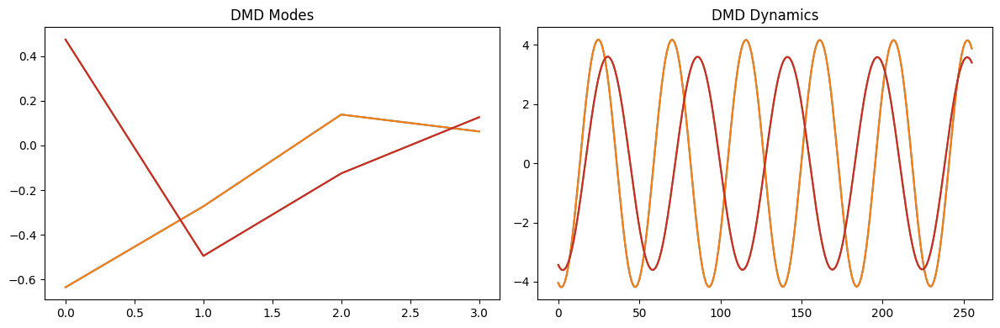

[[ 1.90972135  1.88107444  1.79581516 ... -1.81976943 -1.69145074
  -1.5120626 ]
 [ 6.01729568  5.97229218  5.83799403 ... -5.37073899 -5.06022056
  -4.6708503 ]
 [ 0.05092254 -0.28264586 -0.60742199 ...  0.51184106  0.82349855
   1.10979513]
 [ 0.33638498 -0.39314953 -1.11130182 ...  2.54807778  3.20876652
   3.82567769]]


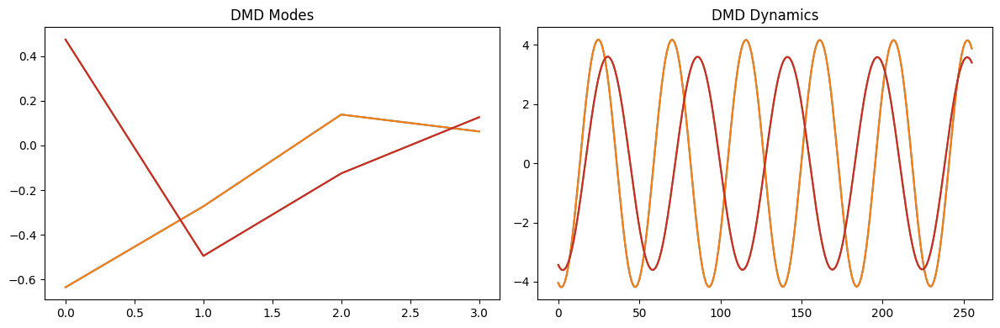

[[ 1.90972135  1.88107444  1.79581516 ... -1.81976943 -1.69145074
  -1.5120626 ]
 [ 6.01729568  5.97229218  5.83799403 ... -5.37073899 -5.06022056
  -4.6708503 ]
 [ 0.05092254 -0.28264586 -0.60742199 ...  0.51184106  0.82349855
   1.10979513]
 [ 0.33638498 -0.39314953 -1.11130182 ...  2.54807778  3.20876652
   3.82567769]]


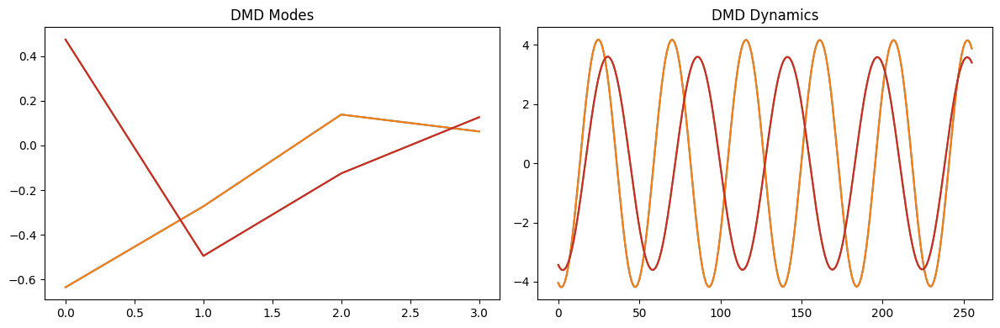

[[ 1.90972135  1.88107444  1.79581516 ... -1.81976943 -1.69145074
  -1.5120626 ]
 [ 6.01729568  5.97229218  5.83799403 ... -5.37073899 -5.06022056
  -4.6708503 ]
 [ 0.05092254 -0.28264586 -0.60742199 ...  0.51184106  0.82349855
   1.10979513]
 [ 0.33638498 -0.39314953 -1.11130182 ...  2.54807778  3.20876652
   3.82567769]]


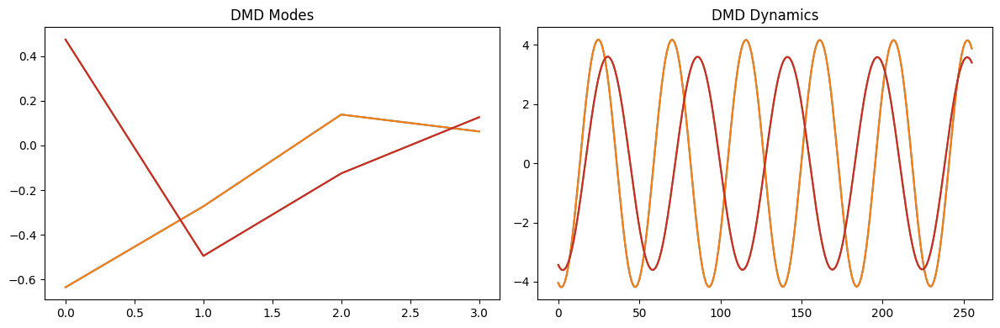

[[ 1.90972135  1.88107444  1.79581516 ... -1.81976943 -1.69145074
  -1.5120626 ]
 [ 6.01729568  5.97229218  5.83799403 ... -5.37073899 -5.06022056
  -4.6708503 ]
 [ 0.05092254 -0.28264586 -0.60742199 ...  0.51184106  0.82349855
   1.10979513]
 [ 0.33638498 -0.39314953 -1.11130182 ...  2.54807778  3.20876652
   3.82567769]]


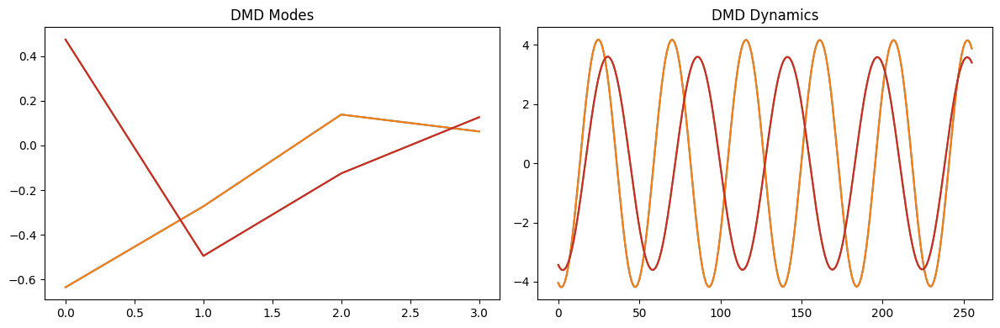

[[ 1.90972135  1.88107444  1.79581516 ... -1.81976943 -1.69145074
  -1.5120626 ]
 [ 6.01729568  5.97229218  5.83799403 ... -5.37073899 -5.06022056
  -4.6708503 ]
 [ 0.05092254 -0.28264586 -0.60742199 ...  0.51184106  0.82349855
   1.10979513]
 [ 0.33638498 -0.39314953 -1.11130182 ...  2.54807778  3.20876652
   3.82567769]]


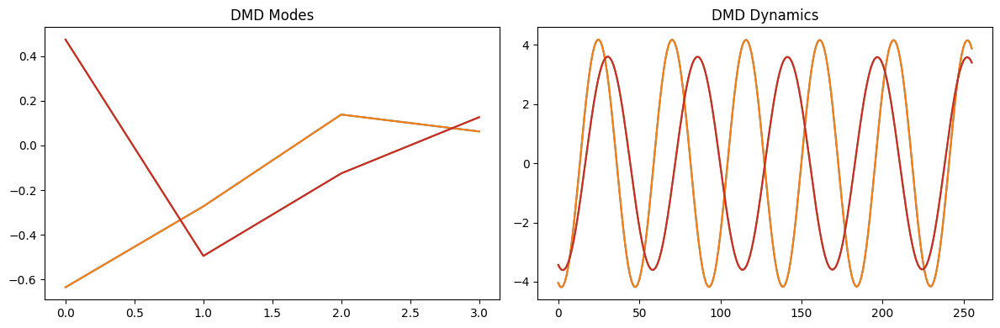

[[ 1.90972135  1.88107444  1.79581516 ... -1.81976943 -1.69145074
  -1.5120626 ]
 [ 6.01729568  5.97229218  5.83799403 ... -5.37073899 -5.06022056
  -4.6708503 ]
 [ 0.05092254 -0.28264586 -0.60742199 ...  0.51184106  0.82349855
   1.10979513]
 [ 0.33638498 -0.39314953 -1.11130182 ...  2.54807778  3.20876652
   3.82567769]]


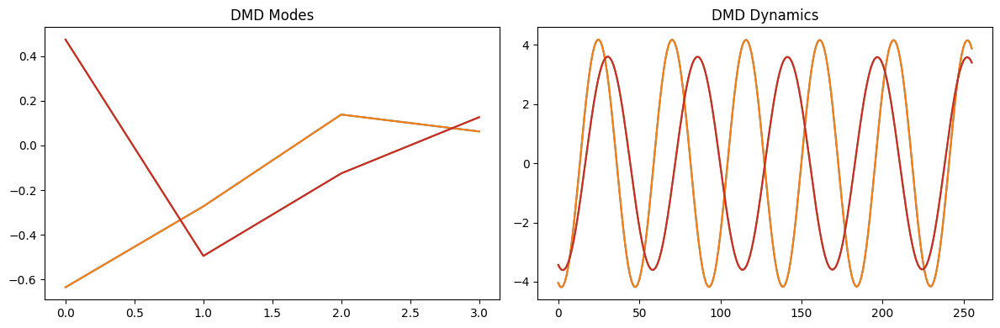

[[ 1.90972135  1.88107444  1.79581516 ... -1.81976943 -1.69145074
  -1.5120626 ]
 [ 6.01729568  5.97229218  5.83799403 ... -5.37073899 -5.06022056
  -4.6708503 ]
 [ 0.05092254 -0.28264586 -0.60742199 ...  0.51184106  0.82349855
   1.10979513]
 [ 0.33638498 -0.39314953 -1.11130182 ...  2.54807778  3.20876652
   3.82567769]]


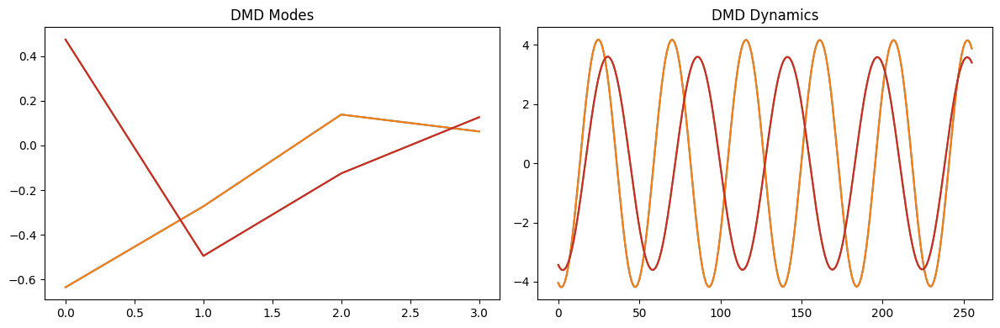

[[ 1.90972135  1.88107444  1.79581516 ... -1.81976943 -1.69145074
  -1.5120626 ]
 [ 6.01729568  5.97229218  5.83799403 ... -5.37073899 -5.06022056
  -4.6708503 ]
 [ 0.05092254 -0.28264586 -0.60742199 ...  0.51184106  0.82349855
   1.10979513]
 [ 0.33638498 -0.39314953 -1.11130182 ...  2.54807778  3.20876652
   3.82567769]]


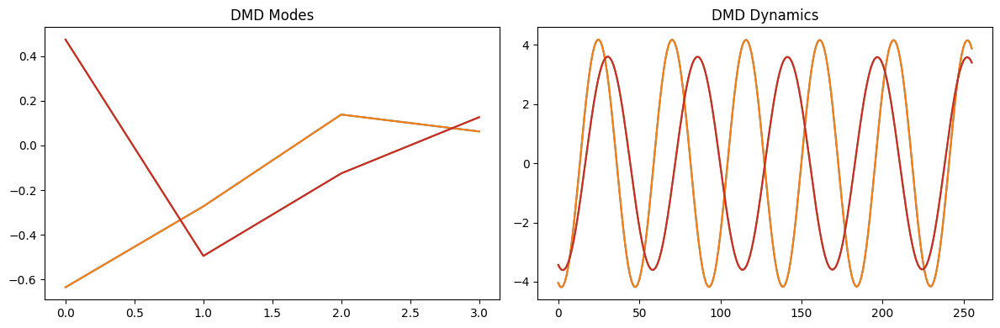

[[ 1.90972135  1.88107444  1.79581516 ... -1.81976943 -1.69145074
  -1.5120626 ]
 [ 6.01729568  5.97229218  5.83799403 ... -5.37073899 -5.06022056
  -4.6708503 ]
 [ 0.05092254 -0.28264586 -0.60742199 ...  0.51184106  0.82349855
   1.10979513]
 [ 0.33638498 -0.39314953 -1.11130182 ...  2.54807778  3.20876652
   3.82567769]]


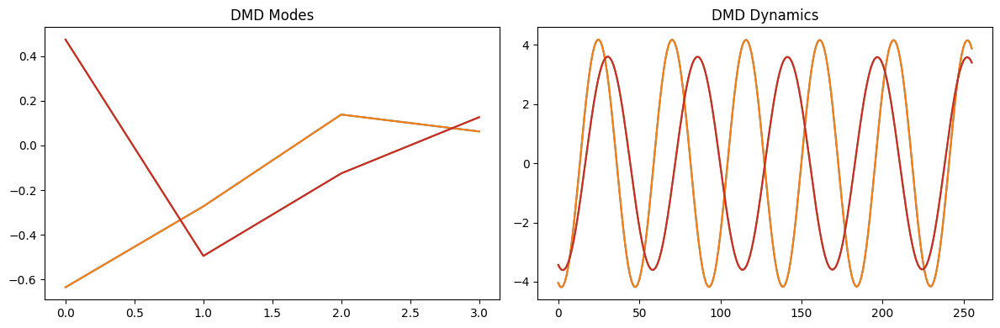

[[ 1.90972135  1.88107444  1.79581516 ... -1.81976943 -1.69145074
  -1.5120626 ]
 [ 6.01729568  5.97229218  5.83799403 ... -5.37073899 -5.06022056
  -4.6708503 ]
 [ 0.05092254 -0.28264586 -0.60742199 ...  0.51184106  0.82349855
   1.10979513]
 [ 0.33638498 -0.39314953 -1.11130182 ...  2.54807778  3.20876652
   3.82567769]]


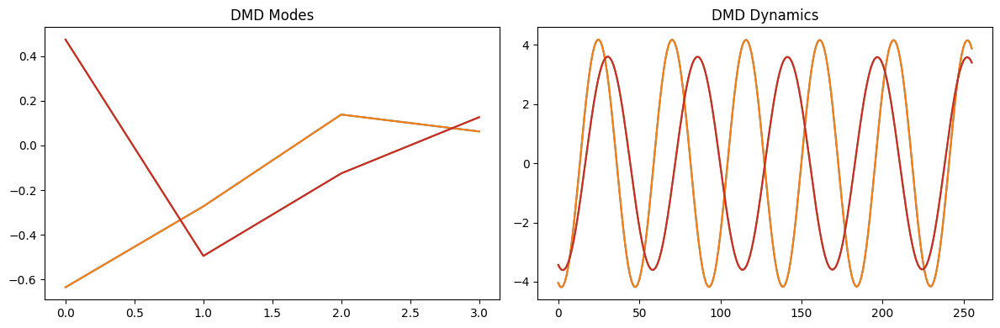

[[ 1.90972135  1.88107444  1.79581516 ... -1.81976943 -1.69145074
  -1.5120626 ]
 [ 6.01729568  5.97229218  5.83799403 ... -5.37073899 -5.06022056
  -4.6708503 ]
 [ 0.05092254 -0.28264586 -0.60742199 ...  0.51184106  0.82349855
   1.10979513]
 [ 0.33638498 -0.39314953 -1.11130182 ...  2.54807778  3.20876652
   3.82567769]]


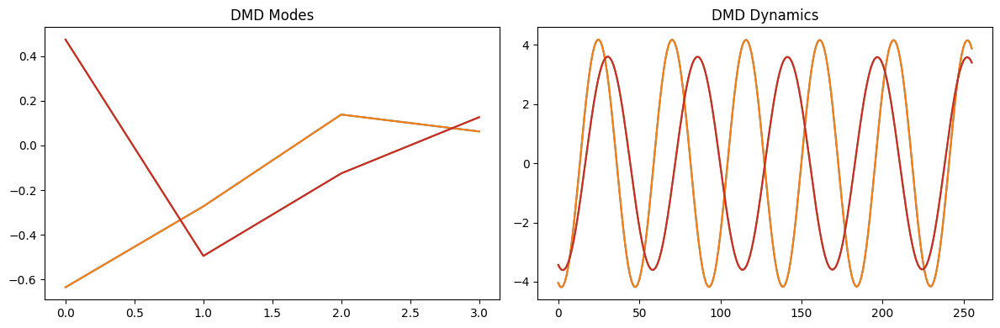

[[ 1.90972135  1.88107444  1.79581516 ... -1.81976943 -1.69145074
  -1.5120626 ]
 [ 6.01729568  5.97229218  5.83799403 ... -5.37073899 -5.06022056
  -4.6708503 ]
 [ 0.05092254 -0.28264586 -0.60742199 ...  0.51184106  0.82349855
   1.10979513]
 [ 0.33638498 -0.39314953 -1.11130182 ...  2.54807778  3.20876652
   3.82567769]]


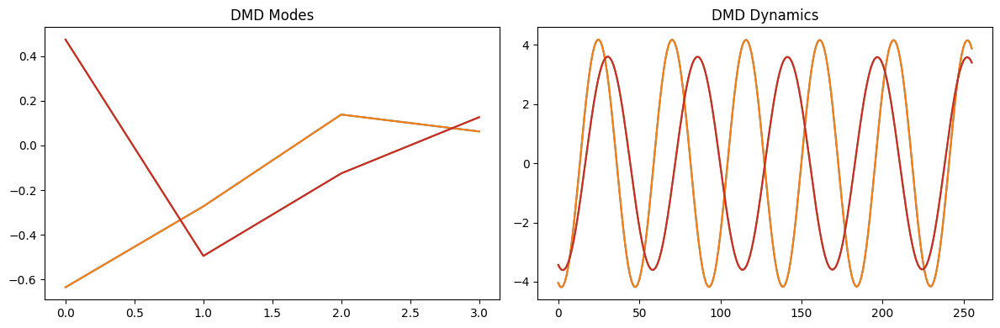

[[ 1.90972135  1.88107444  1.79581516 ... -1.81976943 -1.69145074
  -1.5120626 ]
 [ 6.01729568  5.97229218  5.83799403 ... -5.37073899 -5.06022056
  -4.6708503 ]
 [ 0.05092254 -0.28264586 -0.60742199 ...  0.51184106  0.82349855
   1.10979513]
 [ 0.33638498 -0.39314953 -1.11130182 ...  2.54807778  3.20876652
   3.82567769]]


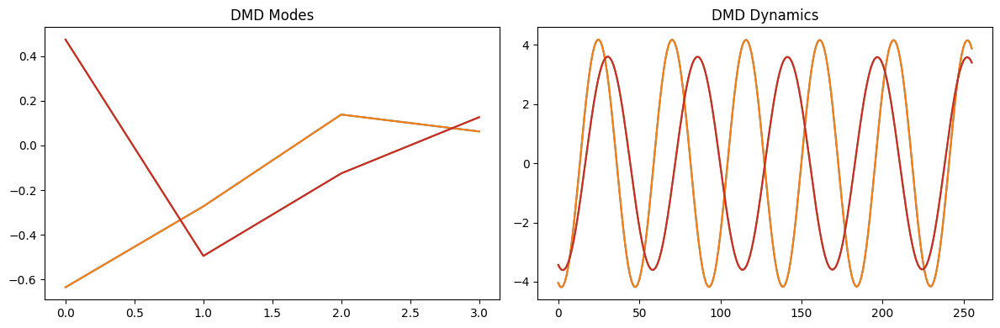

[[ 1.90972135  1.88107444  1.79581516 ... -1.81976943 -1.69145074
  -1.5120626 ]
 [ 6.01729568  5.97229218  5.83799403 ... -5.37073899 -5.06022056
  -4.6708503 ]
 [ 0.05092254 -0.28264586 -0.60742199 ...  0.51184106  0.82349855
   1.10979513]
 [ 0.33638498 -0.39314953 -1.11130182 ...  2.54807778  3.20876652
   3.82567769]]


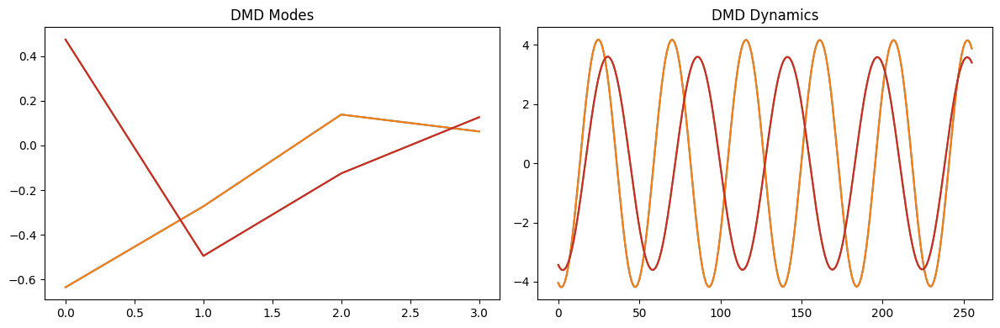

[[ 1.90972135  1.88107444  1.79581516 ... -1.81976943 -1.69145074
  -1.5120626 ]
 [ 6.01729568  5.97229218  5.83799403 ... -5.37073899 -5.06022056
  -4.6708503 ]
 [ 0.05092254 -0.28264586 -0.60742199 ...  0.51184106  0.82349855
   1.10979513]
 [ 0.33638498 -0.39314953 -1.11130182 ...  2.54807778  3.20876652
   3.82567769]]


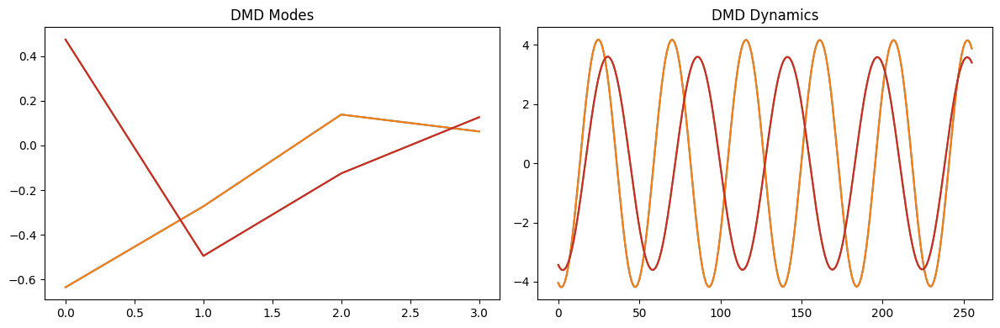

[[ 1.90972135  1.88107444  1.79581516 ... -1.81976943 -1.69145074
  -1.5120626 ]
 [ 6.01729568  5.97229218  5.83799403 ... -5.37073899 -5.06022056
  -4.6708503 ]
 [ 0.05092254 -0.28264586 -0.60742199 ...  0.51184106  0.82349855
   1.10979513]
 [ 0.33638498 -0.39314953 -1.11130182 ...  2.54807778  3.20876652
   3.82567769]]


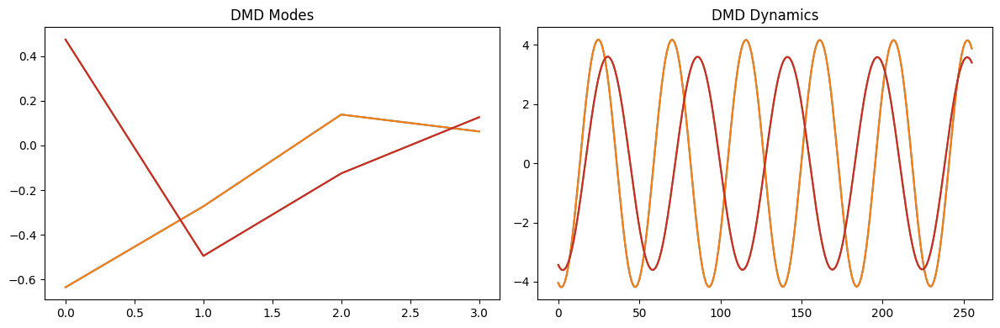

Average Execution Time: 0.622077 seconds
Average RAM Usage: -38584.32 bytes
time: 1min 3s (started: 2023-07-17 11:41:51 +00:00)


In [ ]:


# Define the external variables or dependencies needed by the code block
external_variable_1 = PCf

# Code block to measure execution time and RAM requirements
code_block = """
# Access the external variables or dependencies here
print(external_variable_1)

Z = PCf

# Perform DMD
pdmd = DMD(svd_rank=4)
pdmd.fit(Z)

# Access DMD modes and dynamics
pmodes = pdmd.modes.T
pdynamics = pdmd.dynamics

# Visualize DMD modes and dynamics
plt.figure(figsize=(12, 4))

# Plot DMD modes
plt.subplot(1, 2, 1)
for mode in pmodes:
    plt.plot(mode)
plt.title('DMD Modes')

# Plot DMD dynamics
plt.subplot(1, 2, 2)
for dynamic in pdynamics:
    plt.plot(dynamic)
plt.title('DMD Dynamics')

plt.tight_layout()
plt.show()
"""

execution_times = []
memory_usage = []

# Execute the code block 10 times and measure the execution time and RAM requirements
for _ in range(100):
    process = psutil.Process()
    process_memory_before = process.memory_info().rss

    # Create a setup statement to define the local namespace with the external variables
    setup_statement = f"from __main__ import external_variable_1"

    # Measure the execution time
    execution_time = timeit.timeit(stmt=code_block, setup=setup_statement, globals=globals(), number=1)

    # Measure the memory usage
    process_memory_after = process.memory_info().rss
    memory_usage.append(process_memory_after - process_memory_before)

    # Store the execution time
    execution_times.append(execution_time)

# Calculate the average execution time and RAM usage
average_execution_time = sum(execution_times) / len(execution_times)
average_memory_usage = sum(memory_usage) / len(memory_usage)

# Print the average execution time and RAM usage
print("Average Execution Time: {:.6f} seconds".format(average_execution_time))
print("Average RAM Usage: {:.2f} bytes".format(average_memory_usage))


[[ 0.23885411+0.j          0.23740472+0.02635594j  0.23307355+0.05239655j
  ... -0.21935838-0.0946075j  -0.20755608-0.11822059j
  -0.19323704-0.14039492j]
 [ 0.25754297+0.j          0.25598047+0.02841572j  0.25131132+0.05649155j
  ... -0.23652003-0.10201446j -0.2237949 -0.12747274j
  -0.20835664-0.15137996j]
 [ 0.27753608+0.j          0.27585267+0.0306186j   0.2708222 +0.06087107j
  ... -0.25487888-0.10993956j -0.24116666-0.13737116j
  -0.22453141-0.16313162j]
 ...
 [ 0.03232809+0.j          0.03202325+0.00442741j  0.03111449+0.00877121j
  ... -0.03032774-0.01119258j -0.02850972-0.01524095j
  -0.02615398-0.01900198j]
 [ 0.029881  +0.j          0.02959924+0.00409228j  0.02875926+0.00810727j
  ... -0.02803207-0.01034536j -0.02635167-0.01408728j
  -0.02417424-0.01756361j]
 [ 0.02761904+0.j          0.02735861+0.00378249j  0.02658222+0.00749356j
  ... -0.02591007-0.00956222j -0.02435687-0.01302088j
  -0.02234427-0.01623407j]]


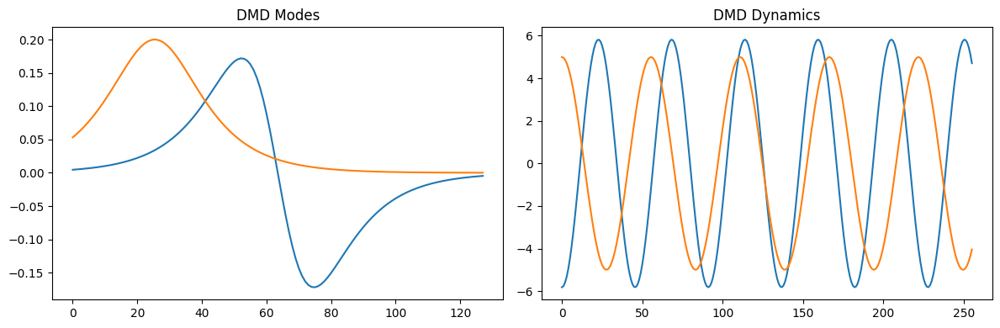

[[ 0.23885411+0.j          0.23740472+0.02635594j  0.23307355+0.05239655j
  ... -0.21935838-0.0946075j  -0.20755608-0.11822059j
  -0.19323704-0.14039492j]
 [ 0.25754297+0.j          0.25598047+0.02841572j  0.25131132+0.05649155j
  ... -0.23652003-0.10201446j -0.2237949 -0.12747274j
  -0.20835664-0.15137996j]
 [ 0.27753608+0.j          0.27585267+0.0306186j   0.2708222 +0.06087107j
  ... -0.25487888-0.10993956j -0.24116666-0.13737116j
  -0.22453141-0.16313162j]
 ...
 [ 0.03232809+0.j          0.03202325+0.00442741j  0.03111449+0.00877121j
  ... -0.03032774-0.01119258j -0.02850972-0.01524095j
  -0.02615398-0.01900198j]
 [ 0.029881  +0.j          0.02959924+0.00409228j  0.02875926+0.00810727j
  ... -0.02803207-0.01034536j -0.02635167-0.01408728j
  -0.02417424-0.01756361j]
 [ 0.02761904+0.j          0.02735861+0.00378249j  0.02658222+0.00749356j
  ... -0.02591007-0.00956222j -0.02435687-0.01302088j
  -0.02234427-0.01623407j]]


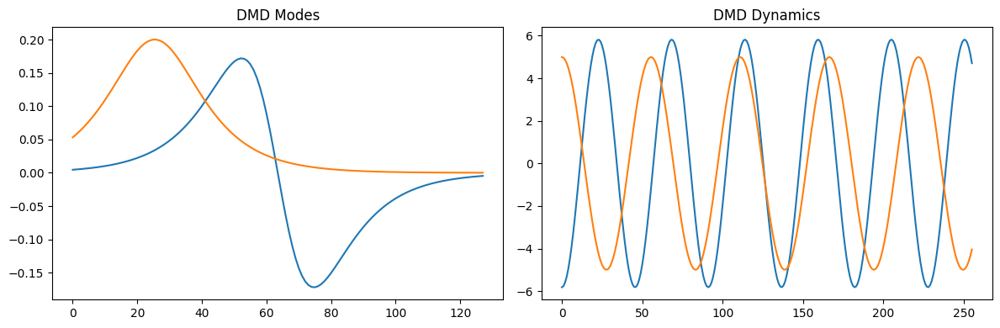

[[ 0.23885411+0.j          0.23740472+0.02635594j  0.23307355+0.05239655j
  ... -0.21935838-0.0946075j  -0.20755608-0.11822059j
  -0.19323704-0.14039492j]
 [ 0.25754297+0.j          0.25598047+0.02841572j  0.25131132+0.05649155j
  ... -0.23652003-0.10201446j -0.2237949 -0.12747274j
  -0.20835664-0.15137996j]
 [ 0.27753608+0.j          0.27585267+0.0306186j   0.2708222 +0.06087107j
  ... -0.25487888-0.10993956j -0.24116666-0.13737116j
  -0.22453141-0.16313162j]
 ...
 [ 0.03232809+0.j          0.03202325+0.00442741j  0.03111449+0.00877121j
  ... -0.03032774-0.01119258j -0.02850972-0.01524095j
  -0.02615398-0.01900198j]
 [ 0.029881  +0.j          0.02959924+0.00409228j  0.02875926+0.00810727j
  ... -0.02803207-0.01034536j -0.02635167-0.01408728j
  -0.02417424-0.01756361j]
 [ 0.02761904+0.j          0.02735861+0.00378249j  0.02658222+0.00749356j
  ... -0.02591007-0.00956222j -0.02435687-0.01302088j
  -0.02234427-0.01623407j]]


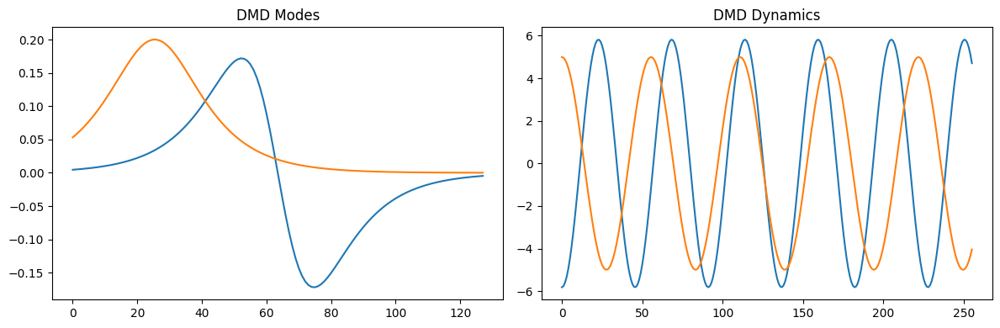

[[ 0.23885411+0.j          0.23740472+0.02635594j  0.23307355+0.05239655j
  ... -0.21935838-0.0946075j  -0.20755608-0.11822059j
  -0.19323704-0.14039492j]
 [ 0.25754297+0.j          0.25598047+0.02841572j  0.25131132+0.05649155j
  ... -0.23652003-0.10201446j -0.2237949 -0.12747274j
  -0.20835664-0.15137996j]
 [ 0.27753608+0.j          0.27585267+0.0306186j   0.2708222 +0.06087107j
  ... -0.25487888-0.10993956j -0.24116666-0.13737116j
  -0.22453141-0.16313162j]
 ...
 [ 0.03232809+0.j          0.03202325+0.00442741j  0.03111449+0.00877121j
  ... -0.03032774-0.01119258j -0.02850972-0.01524095j
  -0.02615398-0.01900198j]
 [ 0.029881  +0.j          0.02959924+0.00409228j  0.02875926+0.00810727j
  ... -0.02803207-0.01034536j -0.02635167-0.01408728j
  -0.02417424-0.01756361j]
 [ 0.02761904+0.j          0.02735861+0.00378249j  0.02658222+0.00749356j
  ... -0.02591007-0.00956222j -0.02435687-0.01302088j
  -0.02234427-0.01623407j]]


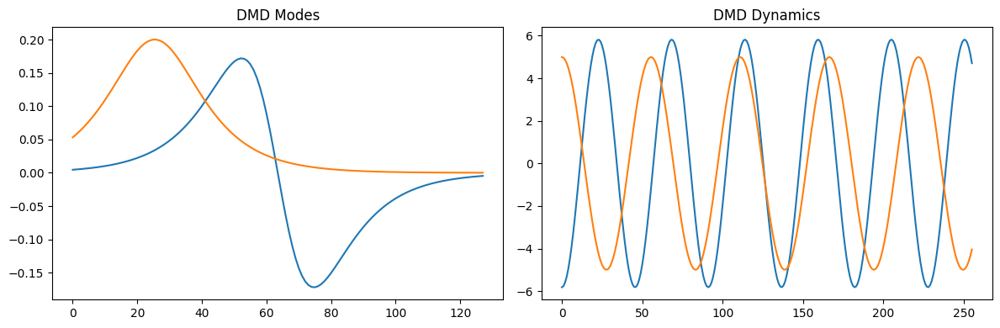

[[ 0.23885411+0.j          0.23740472+0.02635594j  0.23307355+0.05239655j
  ... -0.21935838-0.0946075j  -0.20755608-0.11822059j
  -0.19323704-0.14039492j]
 [ 0.25754297+0.j          0.25598047+0.02841572j  0.25131132+0.05649155j
  ... -0.23652003-0.10201446j -0.2237949 -0.12747274j
  -0.20835664-0.15137996j]
 [ 0.27753608+0.j          0.27585267+0.0306186j   0.2708222 +0.06087107j
  ... -0.25487888-0.10993956j -0.24116666-0.13737116j
  -0.22453141-0.16313162j]
 ...
 [ 0.03232809+0.j          0.03202325+0.00442741j  0.03111449+0.00877121j
  ... -0.03032774-0.01119258j -0.02850972-0.01524095j
  -0.02615398-0.01900198j]
 [ 0.029881  +0.j          0.02959924+0.00409228j  0.02875926+0.00810727j
  ... -0.02803207-0.01034536j -0.02635167-0.01408728j
  -0.02417424-0.01756361j]
 [ 0.02761904+0.j          0.02735861+0.00378249j  0.02658222+0.00749356j
  ... -0.02591007-0.00956222j -0.02435687-0.01302088j
  -0.02234427-0.01623407j]]


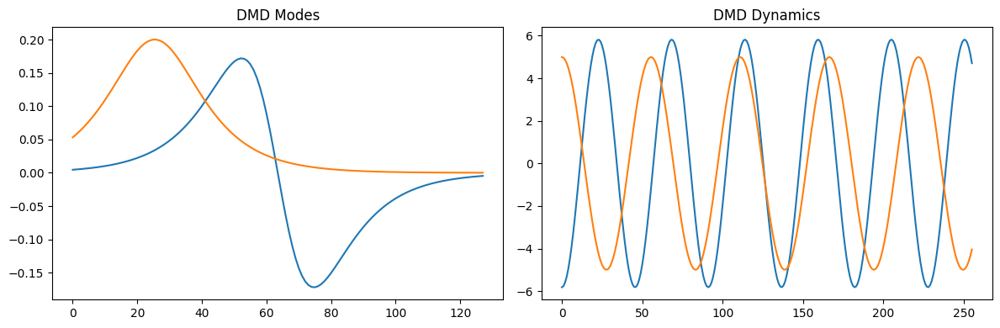

[[ 0.23885411+0.j          0.23740472+0.02635594j  0.23307355+0.05239655j
  ... -0.21935838-0.0946075j  -0.20755608-0.11822059j
  -0.19323704-0.14039492j]
 [ 0.25754297+0.j          0.25598047+0.02841572j  0.25131132+0.05649155j
  ... -0.23652003-0.10201446j -0.2237949 -0.12747274j
  -0.20835664-0.15137996j]
 [ 0.27753608+0.j          0.27585267+0.0306186j   0.2708222 +0.06087107j
  ... -0.25487888-0.10993956j -0.24116666-0.13737116j
  -0.22453141-0.16313162j]
 ...
 [ 0.03232809+0.j          0.03202325+0.00442741j  0.03111449+0.00877121j
  ... -0.03032774-0.01119258j -0.02850972-0.01524095j
  -0.02615398-0.01900198j]
 [ 0.029881  +0.j          0.02959924+0.00409228j  0.02875926+0.00810727j
  ... -0.02803207-0.01034536j -0.02635167-0.01408728j
  -0.02417424-0.01756361j]
 [ 0.02761904+0.j          0.02735861+0.00378249j  0.02658222+0.00749356j
  ... -0.02591007-0.00956222j -0.02435687-0.01302088j
  -0.02234427-0.01623407j]]


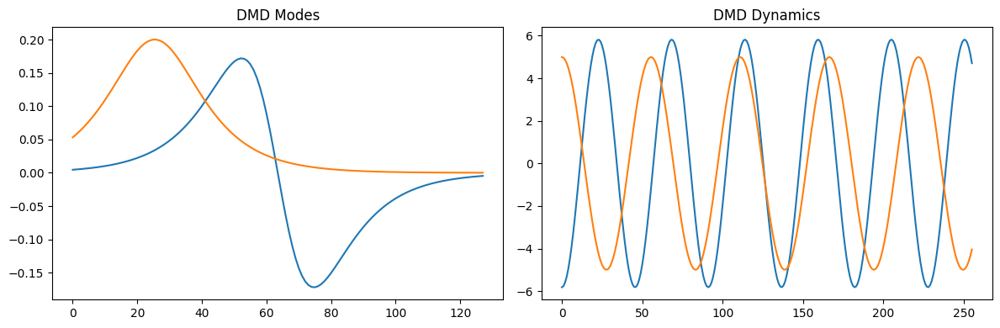

[[ 0.23885411+0.j          0.23740472+0.02635594j  0.23307355+0.05239655j
  ... -0.21935838-0.0946075j  -0.20755608-0.11822059j
  -0.19323704-0.14039492j]
 [ 0.25754297+0.j          0.25598047+0.02841572j  0.25131132+0.05649155j
  ... -0.23652003-0.10201446j -0.2237949 -0.12747274j
  -0.20835664-0.15137996j]
 [ 0.27753608+0.j          0.27585267+0.0306186j   0.2708222 +0.06087107j
  ... -0.25487888-0.10993956j -0.24116666-0.13737116j
  -0.22453141-0.16313162j]
 ...
 [ 0.03232809+0.j          0.03202325+0.00442741j  0.03111449+0.00877121j
  ... -0.03032774-0.01119258j -0.02850972-0.01524095j
  -0.02615398-0.01900198j]
 [ 0.029881  +0.j          0.02959924+0.00409228j  0.02875926+0.00810727j
  ... -0.02803207-0.01034536j -0.02635167-0.01408728j
  -0.02417424-0.01756361j]
 [ 0.02761904+0.j          0.02735861+0.00378249j  0.02658222+0.00749356j
  ... -0.02591007-0.00956222j -0.02435687-0.01302088j
  -0.02234427-0.01623407j]]


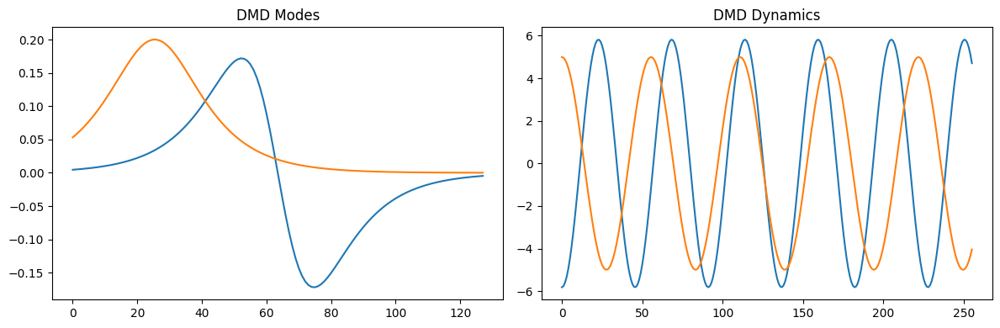

[[ 0.23885411+0.j          0.23740472+0.02635594j  0.23307355+0.05239655j
  ... -0.21935838-0.0946075j  -0.20755608-0.11822059j
  -0.19323704-0.14039492j]
 [ 0.25754297+0.j          0.25598047+0.02841572j  0.25131132+0.05649155j
  ... -0.23652003-0.10201446j -0.2237949 -0.12747274j
  -0.20835664-0.15137996j]
 [ 0.27753608+0.j          0.27585267+0.0306186j   0.2708222 +0.06087107j
  ... -0.25487888-0.10993956j -0.24116666-0.13737116j
  -0.22453141-0.16313162j]
 ...
 [ 0.03232809+0.j          0.03202325+0.00442741j  0.03111449+0.00877121j
  ... -0.03032774-0.01119258j -0.02850972-0.01524095j
  -0.02615398-0.01900198j]
 [ 0.029881  +0.j          0.02959924+0.00409228j  0.02875926+0.00810727j
  ... -0.02803207-0.01034536j -0.02635167-0.01408728j
  -0.02417424-0.01756361j]
 [ 0.02761904+0.j          0.02735861+0.00378249j  0.02658222+0.00749356j
  ... -0.02591007-0.00956222j -0.02435687-0.01302088j
  -0.02234427-0.01623407j]]


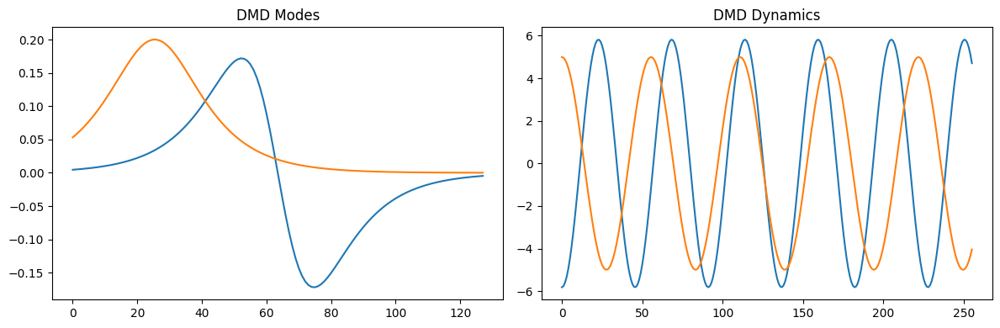

[[ 0.23885411+0.j          0.23740472+0.02635594j  0.23307355+0.05239655j
  ... -0.21935838-0.0946075j  -0.20755608-0.11822059j
  -0.19323704-0.14039492j]
 [ 0.25754297+0.j          0.25598047+0.02841572j  0.25131132+0.05649155j
  ... -0.23652003-0.10201446j -0.2237949 -0.12747274j
  -0.20835664-0.15137996j]
 [ 0.27753608+0.j          0.27585267+0.0306186j   0.2708222 +0.06087107j
  ... -0.25487888-0.10993956j -0.24116666-0.13737116j
  -0.22453141-0.16313162j]
 ...
 [ 0.03232809+0.j          0.03202325+0.00442741j  0.03111449+0.00877121j
  ... -0.03032774-0.01119258j -0.02850972-0.01524095j
  -0.02615398-0.01900198j]
 [ 0.029881  +0.j          0.02959924+0.00409228j  0.02875926+0.00810727j
  ... -0.02803207-0.01034536j -0.02635167-0.01408728j
  -0.02417424-0.01756361j]
 [ 0.02761904+0.j          0.02735861+0.00378249j  0.02658222+0.00749356j
  ... -0.02591007-0.00956222j -0.02435687-0.01302088j
  -0.02234427-0.01623407j]]


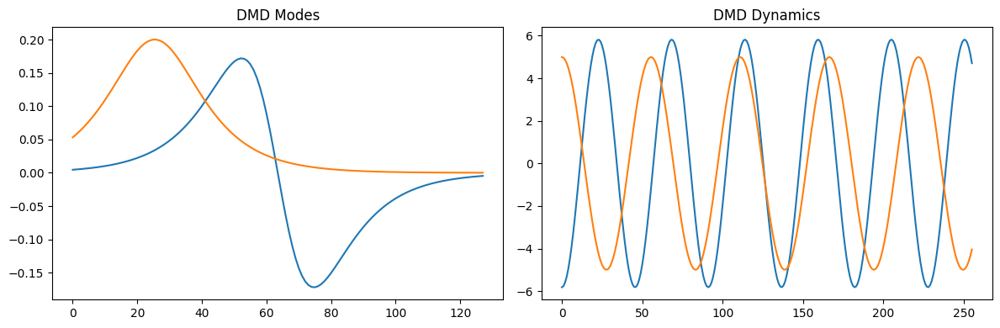

[[ 0.23885411+0.j          0.23740472+0.02635594j  0.23307355+0.05239655j
  ... -0.21935838-0.0946075j  -0.20755608-0.11822059j
  -0.19323704-0.14039492j]
 [ 0.25754297+0.j          0.25598047+0.02841572j  0.25131132+0.05649155j
  ... -0.23652003-0.10201446j -0.2237949 -0.12747274j
  -0.20835664-0.15137996j]
 [ 0.27753608+0.j          0.27585267+0.0306186j   0.2708222 +0.06087107j
  ... -0.25487888-0.10993956j -0.24116666-0.13737116j
  -0.22453141-0.16313162j]
 ...
 [ 0.03232809+0.j          0.03202325+0.00442741j  0.03111449+0.00877121j
  ... -0.03032774-0.01119258j -0.02850972-0.01524095j
  -0.02615398-0.01900198j]
 [ 0.029881  +0.j          0.02959924+0.00409228j  0.02875926+0.00810727j
  ... -0.02803207-0.01034536j -0.02635167-0.01408728j
  -0.02417424-0.01756361j]
 [ 0.02761904+0.j          0.02735861+0.00378249j  0.02658222+0.00749356j
  ... -0.02591007-0.00956222j -0.02435687-0.01302088j
  -0.02234427-0.01623407j]]


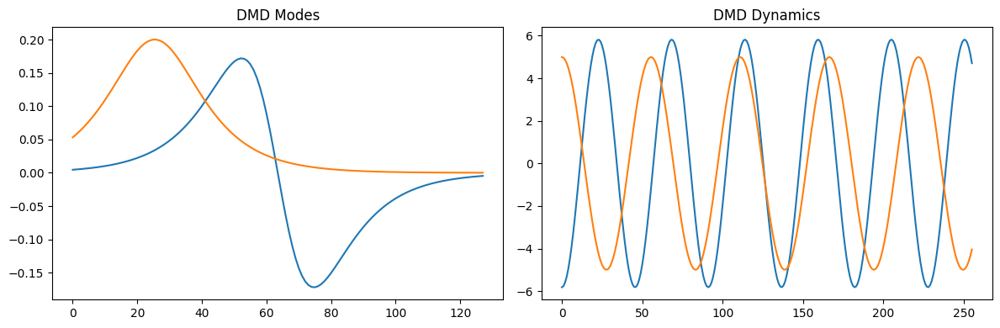

[[ 0.23885411+0.j          0.23740472+0.02635594j  0.23307355+0.05239655j
  ... -0.21935838-0.0946075j  -0.20755608-0.11822059j
  -0.19323704-0.14039492j]
 [ 0.25754297+0.j          0.25598047+0.02841572j  0.25131132+0.05649155j
  ... -0.23652003-0.10201446j -0.2237949 -0.12747274j
  -0.20835664-0.15137996j]
 [ 0.27753608+0.j          0.27585267+0.0306186j   0.2708222 +0.06087107j
  ... -0.25487888-0.10993956j -0.24116666-0.13737116j
  -0.22453141-0.16313162j]
 ...
 [ 0.03232809+0.j          0.03202325+0.00442741j  0.03111449+0.00877121j
  ... -0.03032774-0.01119258j -0.02850972-0.01524095j
  -0.02615398-0.01900198j]
 [ 0.029881  +0.j          0.02959924+0.00409228j  0.02875926+0.00810727j
  ... -0.02803207-0.01034536j -0.02635167-0.01408728j
  -0.02417424-0.01756361j]
 [ 0.02761904+0.j          0.02735861+0.00378249j  0.02658222+0.00749356j
  ... -0.02591007-0.00956222j -0.02435687-0.01302088j
  -0.02234427-0.01623407j]]


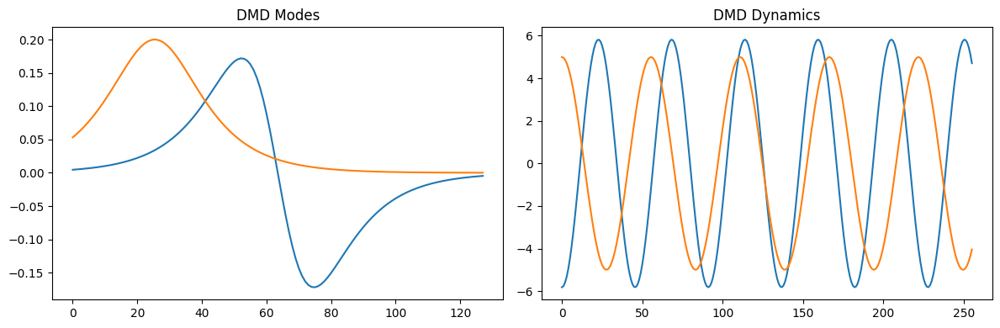

[[ 0.23885411+0.j          0.23740472+0.02635594j  0.23307355+0.05239655j
  ... -0.21935838-0.0946075j  -0.20755608-0.11822059j
  -0.19323704-0.14039492j]
 [ 0.25754297+0.j          0.25598047+0.02841572j  0.25131132+0.05649155j
  ... -0.23652003-0.10201446j -0.2237949 -0.12747274j
  -0.20835664-0.15137996j]
 [ 0.27753608+0.j          0.27585267+0.0306186j   0.2708222 +0.06087107j
  ... -0.25487888-0.10993956j -0.24116666-0.13737116j
  -0.22453141-0.16313162j]
 ...
 [ 0.03232809+0.j          0.03202325+0.00442741j  0.03111449+0.00877121j
  ... -0.03032774-0.01119258j -0.02850972-0.01524095j
  -0.02615398-0.01900198j]
 [ 0.029881  +0.j          0.02959924+0.00409228j  0.02875926+0.00810727j
  ... -0.02803207-0.01034536j -0.02635167-0.01408728j
  -0.02417424-0.01756361j]
 [ 0.02761904+0.j          0.02735861+0.00378249j  0.02658222+0.00749356j
  ... -0.02591007-0.00956222j -0.02435687-0.01302088j
  -0.02234427-0.01623407j]]


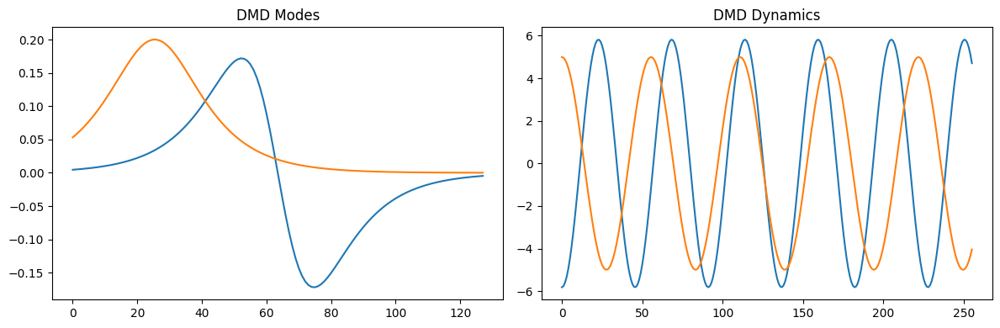

[[ 0.23885411+0.j          0.23740472+0.02635594j  0.23307355+0.05239655j
  ... -0.21935838-0.0946075j  -0.20755608-0.11822059j
  -0.19323704-0.14039492j]
 [ 0.25754297+0.j          0.25598047+0.02841572j  0.25131132+0.05649155j
  ... -0.23652003-0.10201446j -0.2237949 -0.12747274j
  -0.20835664-0.15137996j]
 [ 0.27753608+0.j          0.27585267+0.0306186j   0.2708222 +0.06087107j
  ... -0.25487888-0.10993956j -0.24116666-0.13737116j
  -0.22453141-0.16313162j]
 ...
 [ 0.03232809+0.j          0.03202325+0.00442741j  0.03111449+0.00877121j
  ... -0.03032774-0.01119258j -0.02850972-0.01524095j
  -0.02615398-0.01900198j]
 [ 0.029881  +0.j          0.02959924+0.00409228j  0.02875926+0.00810727j
  ... -0.02803207-0.01034536j -0.02635167-0.01408728j
  -0.02417424-0.01756361j]
 [ 0.02761904+0.j          0.02735861+0.00378249j  0.02658222+0.00749356j
  ... -0.02591007-0.00956222j -0.02435687-0.01302088j
  -0.02234427-0.01623407j]]


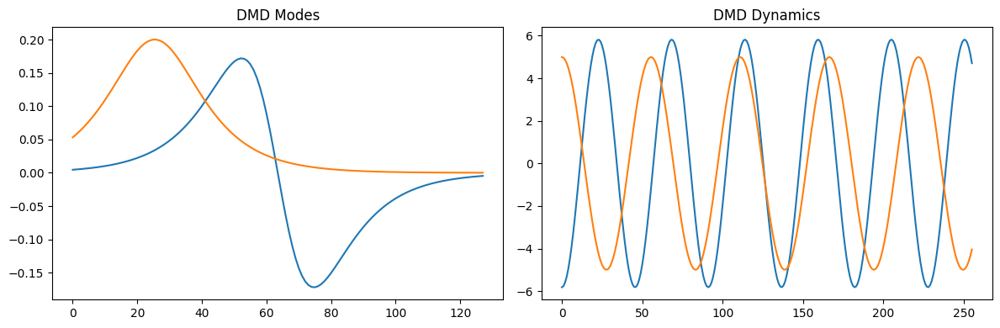

[[ 0.23885411+0.j          0.23740472+0.02635594j  0.23307355+0.05239655j
  ... -0.21935838-0.0946075j  -0.20755608-0.11822059j
  -0.19323704-0.14039492j]
 [ 0.25754297+0.j          0.25598047+0.02841572j  0.25131132+0.05649155j
  ... -0.23652003-0.10201446j -0.2237949 -0.12747274j
  -0.20835664-0.15137996j]
 [ 0.27753608+0.j          0.27585267+0.0306186j   0.2708222 +0.06087107j
  ... -0.25487888-0.10993956j -0.24116666-0.13737116j
  -0.22453141-0.16313162j]
 ...
 [ 0.03232809+0.j          0.03202325+0.00442741j  0.03111449+0.00877121j
  ... -0.03032774-0.01119258j -0.02850972-0.01524095j
  -0.02615398-0.01900198j]
 [ 0.029881  +0.j          0.02959924+0.00409228j  0.02875926+0.00810727j
  ... -0.02803207-0.01034536j -0.02635167-0.01408728j
  -0.02417424-0.01756361j]
 [ 0.02761904+0.j          0.02735861+0.00378249j  0.02658222+0.00749356j
  ... -0.02591007-0.00956222j -0.02435687-0.01302088j
  -0.02234427-0.01623407j]]


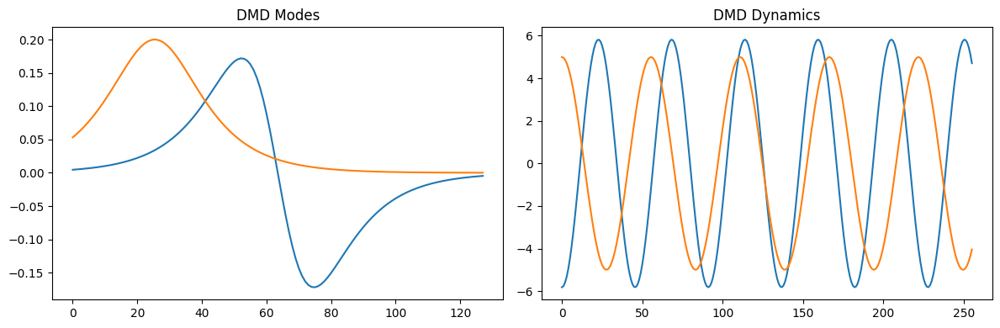

[[ 0.23885411+0.j          0.23740472+0.02635594j  0.23307355+0.05239655j
  ... -0.21935838-0.0946075j  -0.20755608-0.11822059j
  -0.19323704-0.14039492j]
 [ 0.25754297+0.j          0.25598047+0.02841572j  0.25131132+0.05649155j
  ... -0.23652003-0.10201446j -0.2237949 -0.12747274j
  -0.20835664-0.15137996j]
 [ 0.27753608+0.j          0.27585267+0.0306186j   0.2708222 +0.06087107j
  ... -0.25487888-0.10993956j -0.24116666-0.13737116j
  -0.22453141-0.16313162j]
 ...
 [ 0.03232809+0.j          0.03202325+0.00442741j  0.03111449+0.00877121j
  ... -0.03032774-0.01119258j -0.02850972-0.01524095j
  -0.02615398-0.01900198j]
 [ 0.029881  +0.j          0.02959924+0.00409228j  0.02875926+0.00810727j
  ... -0.02803207-0.01034536j -0.02635167-0.01408728j
  -0.02417424-0.01756361j]
 [ 0.02761904+0.j          0.02735861+0.00378249j  0.02658222+0.00749356j
  ... -0.02591007-0.00956222j -0.02435687-0.01302088j
  -0.02234427-0.01623407j]]


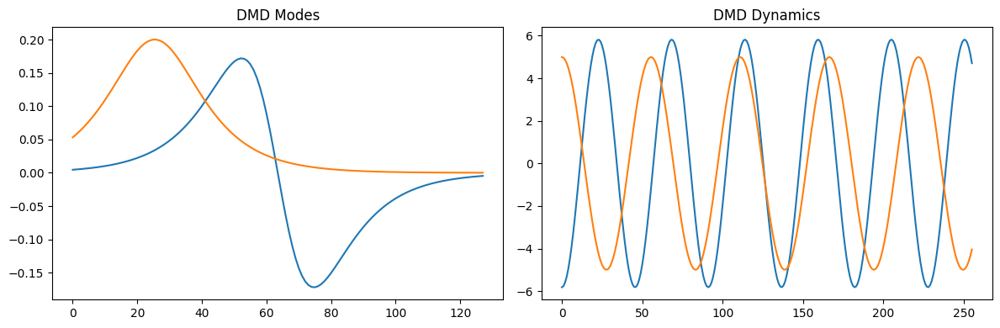

[[ 0.23885411+0.j          0.23740472+0.02635594j  0.23307355+0.05239655j
  ... -0.21935838-0.0946075j  -0.20755608-0.11822059j
  -0.19323704-0.14039492j]
 [ 0.25754297+0.j          0.25598047+0.02841572j  0.25131132+0.05649155j
  ... -0.23652003-0.10201446j -0.2237949 -0.12747274j
  -0.20835664-0.15137996j]
 [ 0.27753608+0.j          0.27585267+0.0306186j   0.2708222 +0.06087107j
  ... -0.25487888-0.10993956j -0.24116666-0.13737116j
  -0.22453141-0.16313162j]
 ...
 [ 0.03232809+0.j          0.03202325+0.00442741j  0.03111449+0.00877121j
  ... -0.03032774-0.01119258j -0.02850972-0.01524095j
  -0.02615398-0.01900198j]
 [ 0.029881  +0.j          0.02959924+0.00409228j  0.02875926+0.00810727j
  ... -0.02803207-0.01034536j -0.02635167-0.01408728j
  -0.02417424-0.01756361j]
 [ 0.02761904+0.j          0.02735861+0.00378249j  0.02658222+0.00749356j
  ... -0.02591007-0.00956222j -0.02435687-0.01302088j
  -0.02234427-0.01623407j]]


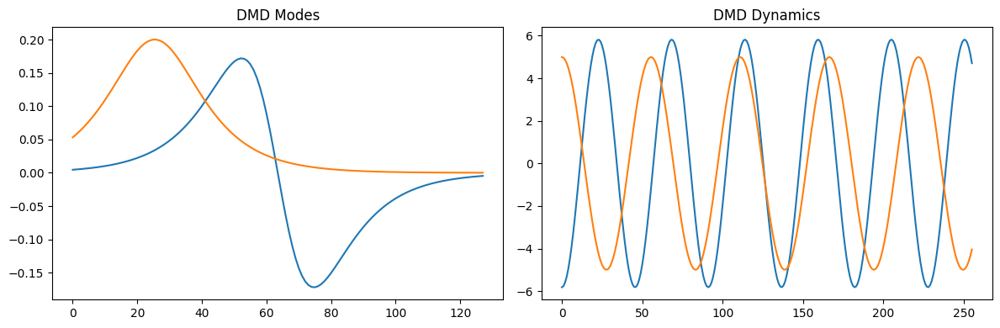

[[ 0.23885411+0.j          0.23740472+0.02635594j  0.23307355+0.05239655j
  ... -0.21935838-0.0946075j  -0.20755608-0.11822059j
  -0.19323704-0.14039492j]
 [ 0.25754297+0.j          0.25598047+0.02841572j  0.25131132+0.05649155j
  ... -0.23652003-0.10201446j -0.2237949 -0.12747274j
  -0.20835664-0.15137996j]
 [ 0.27753608+0.j          0.27585267+0.0306186j   0.2708222 +0.06087107j
  ... -0.25487888-0.10993956j -0.24116666-0.13737116j
  -0.22453141-0.16313162j]
 ...
 [ 0.03232809+0.j          0.03202325+0.00442741j  0.03111449+0.00877121j
  ... -0.03032774-0.01119258j -0.02850972-0.01524095j
  -0.02615398-0.01900198j]
 [ 0.029881  +0.j          0.02959924+0.00409228j  0.02875926+0.00810727j
  ... -0.02803207-0.01034536j -0.02635167-0.01408728j
  -0.02417424-0.01756361j]
 [ 0.02761904+0.j          0.02735861+0.00378249j  0.02658222+0.00749356j
  ... -0.02591007-0.00956222j -0.02435687-0.01302088j
  -0.02234427-0.01623407j]]


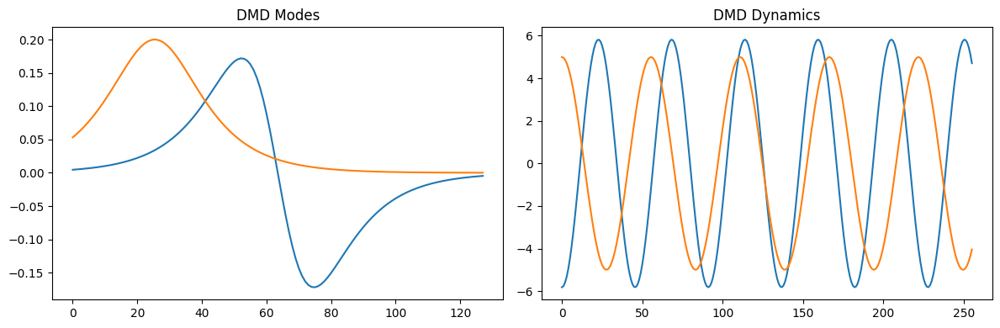

[[ 0.23885411+0.j          0.23740472+0.02635594j  0.23307355+0.05239655j
  ... -0.21935838-0.0946075j  -0.20755608-0.11822059j
  -0.19323704-0.14039492j]
 [ 0.25754297+0.j          0.25598047+0.02841572j  0.25131132+0.05649155j
  ... -0.23652003-0.10201446j -0.2237949 -0.12747274j
  -0.20835664-0.15137996j]
 [ 0.27753608+0.j          0.27585267+0.0306186j   0.2708222 +0.06087107j
  ... -0.25487888-0.10993956j -0.24116666-0.13737116j
  -0.22453141-0.16313162j]
 ...
 [ 0.03232809+0.j          0.03202325+0.00442741j  0.03111449+0.00877121j
  ... -0.03032774-0.01119258j -0.02850972-0.01524095j
  -0.02615398-0.01900198j]
 [ 0.029881  +0.j          0.02959924+0.00409228j  0.02875926+0.00810727j
  ... -0.02803207-0.01034536j -0.02635167-0.01408728j
  -0.02417424-0.01756361j]
 [ 0.02761904+0.j          0.02735861+0.00378249j  0.02658222+0.00749356j
  ... -0.02591007-0.00956222j -0.02435687-0.01302088j
  -0.02234427-0.01623407j]]


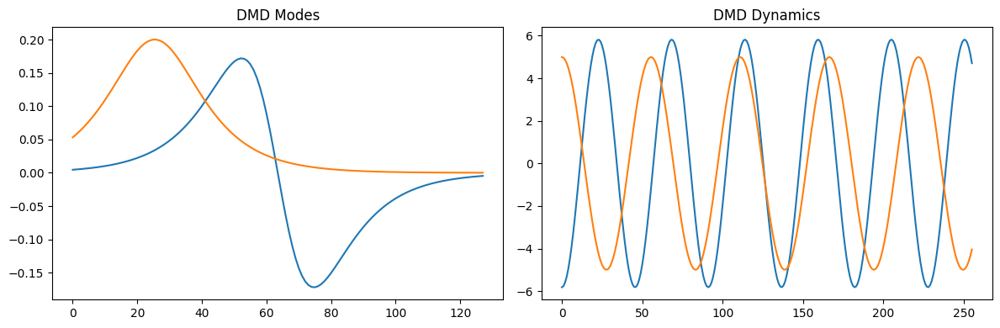

[[ 0.23885411+0.j          0.23740472+0.02635594j  0.23307355+0.05239655j
  ... -0.21935838-0.0946075j  -0.20755608-0.11822059j
  -0.19323704-0.14039492j]
 [ 0.25754297+0.j          0.25598047+0.02841572j  0.25131132+0.05649155j
  ... -0.23652003-0.10201446j -0.2237949 -0.12747274j
  -0.20835664-0.15137996j]
 [ 0.27753608+0.j          0.27585267+0.0306186j   0.2708222 +0.06087107j
  ... -0.25487888-0.10993956j -0.24116666-0.13737116j
  -0.22453141-0.16313162j]
 ...
 [ 0.03232809+0.j          0.03202325+0.00442741j  0.03111449+0.00877121j
  ... -0.03032774-0.01119258j -0.02850972-0.01524095j
  -0.02615398-0.01900198j]
 [ 0.029881  +0.j          0.02959924+0.00409228j  0.02875926+0.00810727j
  ... -0.02803207-0.01034536j -0.02635167-0.01408728j
  -0.02417424-0.01756361j]
 [ 0.02761904+0.j          0.02735861+0.00378249j  0.02658222+0.00749356j
  ... -0.02591007-0.00956222j -0.02435687-0.01302088j
  -0.02234427-0.01623407j]]


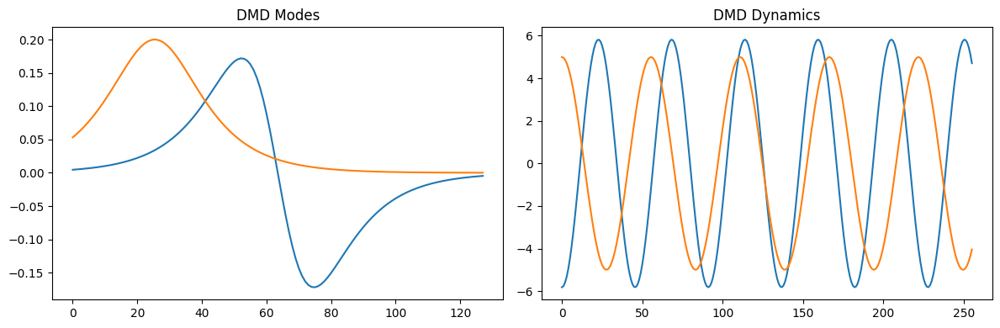

[[ 0.23885411+0.j          0.23740472+0.02635594j  0.23307355+0.05239655j
  ... -0.21935838-0.0946075j  -0.20755608-0.11822059j
  -0.19323704-0.14039492j]
 [ 0.25754297+0.j          0.25598047+0.02841572j  0.25131132+0.05649155j
  ... -0.23652003-0.10201446j -0.2237949 -0.12747274j
  -0.20835664-0.15137996j]
 [ 0.27753608+0.j          0.27585267+0.0306186j   0.2708222 +0.06087107j
  ... -0.25487888-0.10993956j -0.24116666-0.13737116j
  -0.22453141-0.16313162j]
 ...
 [ 0.03232809+0.j          0.03202325+0.00442741j  0.03111449+0.00877121j
  ... -0.03032774-0.01119258j -0.02850972-0.01524095j
  -0.02615398-0.01900198j]
 [ 0.029881  +0.j          0.02959924+0.00409228j  0.02875926+0.00810727j
  ... -0.02803207-0.01034536j -0.02635167-0.01408728j
  -0.02417424-0.01756361j]
 [ 0.02761904+0.j          0.02735861+0.00378249j  0.02658222+0.00749356j
  ... -0.02591007-0.00956222j -0.02435687-0.01302088j
  -0.02234427-0.01623407j]]


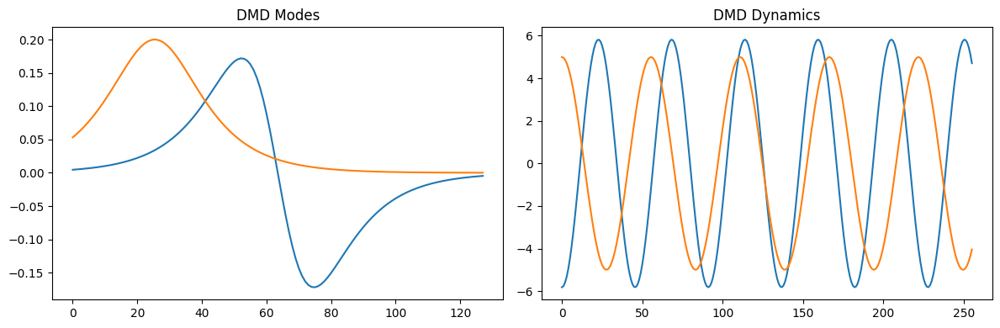

[[ 0.23885411+0.j          0.23740472+0.02635594j  0.23307355+0.05239655j
  ... -0.21935838-0.0946075j  -0.20755608-0.11822059j
  -0.19323704-0.14039492j]
 [ 0.25754297+0.j          0.25598047+0.02841572j  0.25131132+0.05649155j
  ... -0.23652003-0.10201446j -0.2237949 -0.12747274j
  -0.20835664-0.15137996j]
 [ 0.27753608+0.j          0.27585267+0.0306186j   0.2708222 +0.06087107j
  ... -0.25487888-0.10993956j -0.24116666-0.13737116j
  -0.22453141-0.16313162j]
 ...
 [ 0.03232809+0.j          0.03202325+0.00442741j  0.03111449+0.00877121j
  ... -0.03032774-0.01119258j -0.02850972-0.01524095j
  -0.02615398-0.01900198j]
 [ 0.029881  +0.j          0.02959924+0.00409228j  0.02875926+0.00810727j
  ... -0.02803207-0.01034536j -0.02635167-0.01408728j
  -0.02417424-0.01756361j]
 [ 0.02761904+0.j          0.02735861+0.00378249j  0.02658222+0.00749356j
  ... -0.02591007-0.00956222j -0.02435687-0.01302088j
  -0.02234427-0.01623407j]]


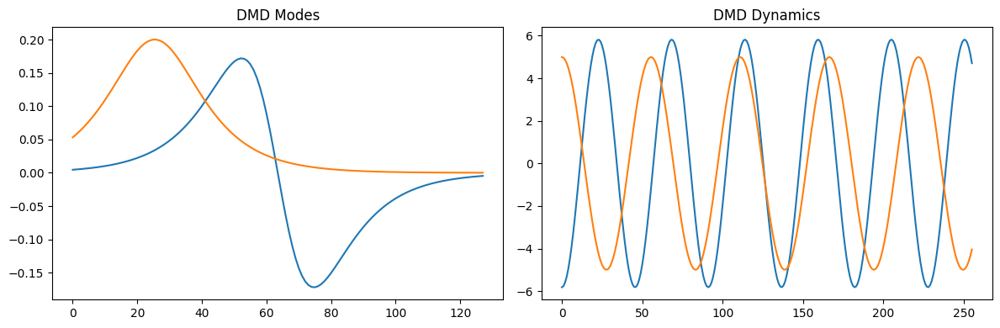

[[ 0.23885411+0.j          0.23740472+0.02635594j  0.23307355+0.05239655j
  ... -0.21935838-0.0946075j  -0.20755608-0.11822059j
  -0.19323704-0.14039492j]
 [ 0.25754297+0.j          0.25598047+0.02841572j  0.25131132+0.05649155j
  ... -0.23652003-0.10201446j -0.2237949 -0.12747274j
  -0.20835664-0.15137996j]
 [ 0.27753608+0.j          0.27585267+0.0306186j   0.2708222 +0.06087107j
  ... -0.25487888-0.10993956j -0.24116666-0.13737116j
  -0.22453141-0.16313162j]
 ...
 [ 0.03232809+0.j          0.03202325+0.00442741j  0.03111449+0.00877121j
  ... -0.03032774-0.01119258j -0.02850972-0.01524095j
  -0.02615398-0.01900198j]
 [ 0.029881  +0.j          0.02959924+0.00409228j  0.02875926+0.00810727j
  ... -0.02803207-0.01034536j -0.02635167-0.01408728j
  -0.02417424-0.01756361j]
 [ 0.02761904+0.j          0.02735861+0.00378249j  0.02658222+0.00749356j
  ... -0.02591007-0.00956222j -0.02435687-0.01302088j
  -0.02234427-0.01623407j]]


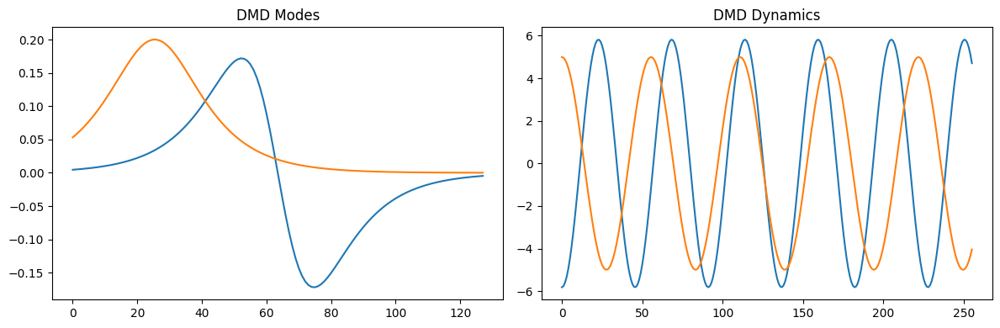

[[ 0.23885411+0.j          0.23740472+0.02635594j  0.23307355+0.05239655j
  ... -0.21935838-0.0946075j  -0.20755608-0.11822059j
  -0.19323704-0.14039492j]
 [ 0.25754297+0.j          0.25598047+0.02841572j  0.25131132+0.05649155j
  ... -0.23652003-0.10201446j -0.2237949 -0.12747274j
  -0.20835664-0.15137996j]
 [ 0.27753608+0.j          0.27585267+0.0306186j   0.2708222 +0.06087107j
  ... -0.25487888-0.10993956j -0.24116666-0.13737116j
  -0.22453141-0.16313162j]
 ...
 [ 0.03232809+0.j          0.03202325+0.00442741j  0.03111449+0.00877121j
  ... -0.03032774-0.01119258j -0.02850972-0.01524095j
  -0.02615398-0.01900198j]
 [ 0.029881  +0.j          0.02959924+0.00409228j  0.02875926+0.00810727j
  ... -0.02803207-0.01034536j -0.02635167-0.01408728j
  -0.02417424-0.01756361j]
 [ 0.02761904+0.j          0.02735861+0.00378249j  0.02658222+0.00749356j
  ... -0.02591007-0.00956222j -0.02435687-0.01302088j
  -0.02234427-0.01623407j]]


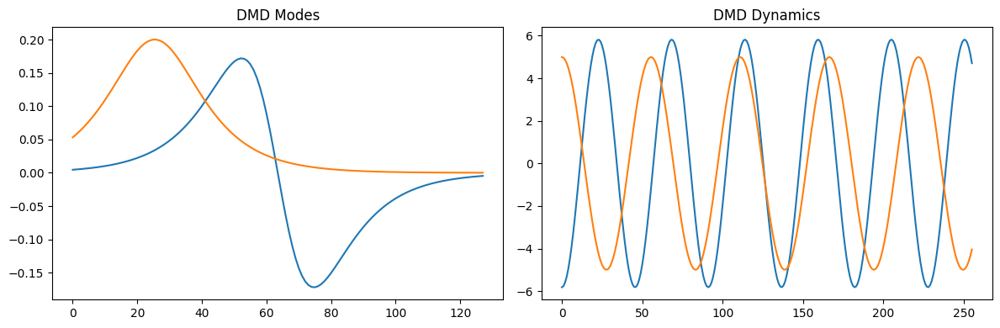

[[ 0.23885411+0.j          0.23740472+0.02635594j  0.23307355+0.05239655j
  ... -0.21935838-0.0946075j  -0.20755608-0.11822059j
  -0.19323704-0.14039492j]
 [ 0.25754297+0.j          0.25598047+0.02841572j  0.25131132+0.05649155j
  ... -0.23652003-0.10201446j -0.2237949 -0.12747274j
  -0.20835664-0.15137996j]
 [ 0.27753608+0.j          0.27585267+0.0306186j   0.2708222 +0.06087107j
  ... -0.25487888-0.10993956j -0.24116666-0.13737116j
  -0.22453141-0.16313162j]
 ...
 [ 0.03232809+0.j          0.03202325+0.00442741j  0.03111449+0.00877121j
  ... -0.03032774-0.01119258j -0.02850972-0.01524095j
  -0.02615398-0.01900198j]
 [ 0.029881  +0.j          0.02959924+0.00409228j  0.02875926+0.00810727j
  ... -0.02803207-0.01034536j -0.02635167-0.01408728j
  -0.02417424-0.01756361j]
 [ 0.02761904+0.j          0.02735861+0.00378249j  0.02658222+0.00749356j
  ... -0.02591007-0.00956222j -0.02435687-0.01302088j
  -0.02234427-0.01623407j]]


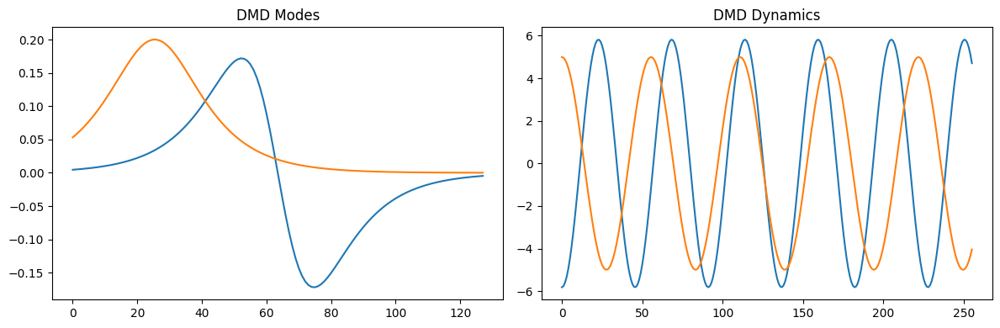

[[ 0.23885411+0.j          0.23740472+0.02635594j  0.23307355+0.05239655j
  ... -0.21935838-0.0946075j  -0.20755608-0.11822059j
  -0.19323704-0.14039492j]
 [ 0.25754297+0.j          0.25598047+0.02841572j  0.25131132+0.05649155j
  ... -0.23652003-0.10201446j -0.2237949 -0.12747274j
  -0.20835664-0.15137996j]
 [ 0.27753608+0.j          0.27585267+0.0306186j   0.2708222 +0.06087107j
  ... -0.25487888-0.10993956j -0.24116666-0.13737116j
  -0.22453141-0.16313162j]
 ...
 [ 0.03232809+0.j          0.03202325+0.00442741j  0.03111449+0.00877121j
  ... -0.03032774-0.01119258j -0.02850972-0.01524095j
  -0.02615398-0.01900198j]
 [ 0.029881  +0.j          0.02959924+0.00409228j  0.02875926+0.00810727j
  ... -0.02803207-0.01034536j -0.02635167-0.01408728j
  -0.02417424-0.01756361j]
 [ 0.02761904+0.j          0.02735861+0.00378249j  0.02658222+0.00749356j
  ... -0.02591007-0.00956222j -0.02435687-0.01302088j
  -0.02234427-0.01623407j]]


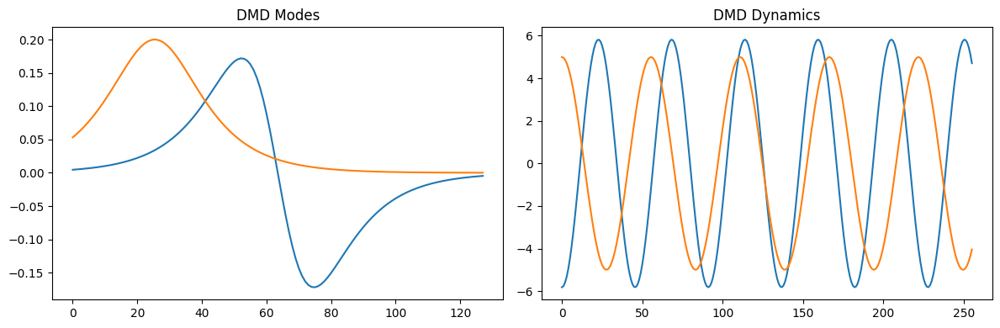

[[ 0.23885411+0.j          0.23740472+0.02635594j  0.23307355+0.05239655j
  ... -0.21935838-0.0946075j  -0.20755608-0.11822059j
  -0.19323704-0.14039492j]
 [ 0.25754297+0.j          0.25598047+0.02841572j  0.25131132+0.05649155j
  ... -0.23652003-0.10201446j -0.2237949 -0.12747274j
  -0.20835664-0.15137996j]
 [ 0.27753608+0.j          0.27585267+0.0306186j   0.2708222 +0.06087107j
  ... -0.25487888-0.10993956j -0.24116666-0.13737116j
  -0.22453141-0.16313162j]
 ...
 [ 0.03232809+0.j          0.03202325+0.00442741j  0.03111449+0.00877121j
  ... -0.03032774-0.01119258j -0.02850972-0.01524095j
  -0.02615398-0.01900198j]
 [ 0.029881  +0.j          0.02959924+0.00409228j  0.02875926+0.00810727j
  ... -0.02803207-0.01034536j -0.02635167-0.01408728j
  -0.02417424-0.01756361j]
 [ 0.02761904+0.j          0.02735861+0.00378249j  0.02658222+0.00749356j
  ... -0.02591007-0.00956222j -0.02435687-0.01302088j
  -0.02234427-0.01623407j]]


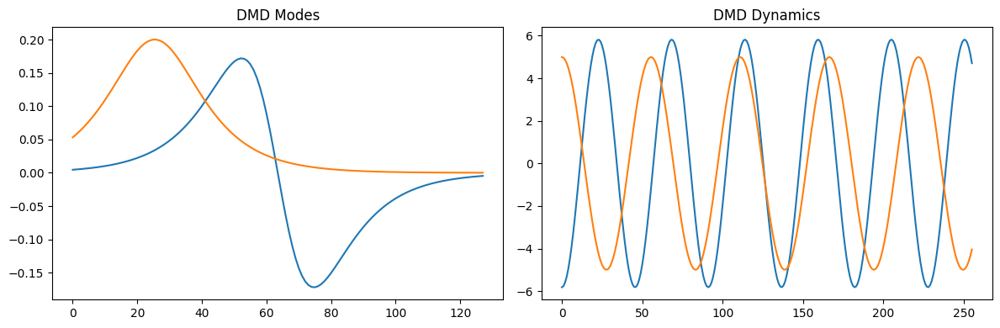

[[ 0.23885411+0.j          0.23740472+0.02635594j  0.23307355+0.05239655j
  ... -0.21935838-0.0946075j  -0.20755608-0.11822059j
  -0.19323704-0.14039492j]
 [ 0.25754297+0.j          0.25598047+0.02841572j  0.25131132+0.05649155j
  ... -0.23652003-0.10201446j -0.2237949 -0.12747274j
  -0.20835664-0.15137996j]
 [ 0.27753608+0.j          0.27585267+0.0306186j   0.2708222 +0.06087107j
  ... -0.25487888-0.10993956j -0.24116666-0.13737116j
  -0.22453141-0.16313162j]
 ...
 [ 0.03232809+0.j          0.03202325+0.00442741j  0.03111449+0.00877121j
  ... -0.03032774-0.01119258j -0.02850972-0.01524095j
  -0.02615398-0.01900198j]
 [ 0.029881  +0.j          0.02959924+0.00409228j  0.02875926+0.00810727j
  ... -0.02803207-0.01034536j -0.02635167-0.01408728j
  -0.02417424-0.01756361j]
 [ 0.02761904+0.j          0.02735861+0.00378249j  0.02658222+0.00749356j
  ... -0.02591007-0.00956222j -0.02435687-0.01302088j
  -0.02234427-0.01623407j]]


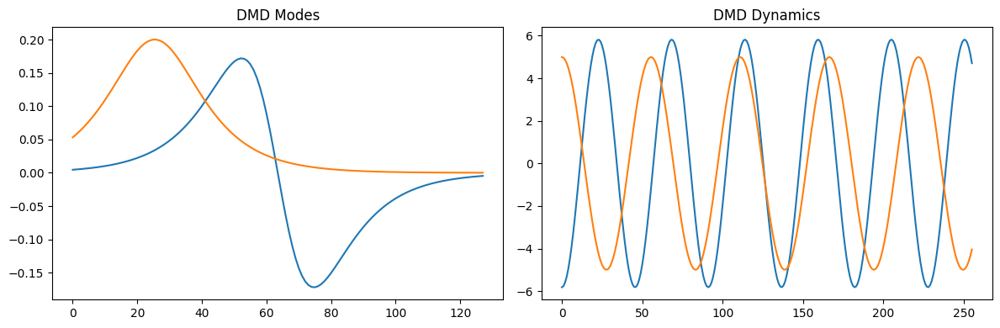

[[ 0.23885411+0.j          0.23740472+0.02635594j  0.23307355+0.05239655j
  ... -0.21935838-0.0946075j  -0.20755608-0.11822059j
  -0.19323704-0.14039492j]
 [ 0.25754297+0.j          0.25598047+0.02841572j  0.25131132+0.05649155j
  ... -0.23652003-0.10201446j -0.2237949 -0.12747274j
  -0.20835664-0.15137996j]
 [ 0.27753608+0.j          0.27585267+0.0306186j   0.2708222 +0.06087107j
  ... -0.25487888-0.10993956j -0.24116666-0.13737116j
  -0.22453141-0.16313162j]
 ...
 [ 0.03232809+0.j          0.03202325+0.00442741j  0.03111449+0.00877121j
  ... -0.03032774-0.01119258j -0.02850972-0.01524095j
  -0.02615398-0.01900198j]
 [ 0.029881  +0.j          0.02959924+0.00409228j  0.02875926+0.00810727j
  ... -0.02803207-0.01034536j -0.02635167-0.01408728j
  -0.02417424-0.01756361j]
 [ 0.02761904+0.j          0.02735861+0.00378249j  0.02658222+0.00749356j
  ... -0.02591007-0.00956222j -0.02435687-0.01302088j
  -0.02234427-0.01623407j]]


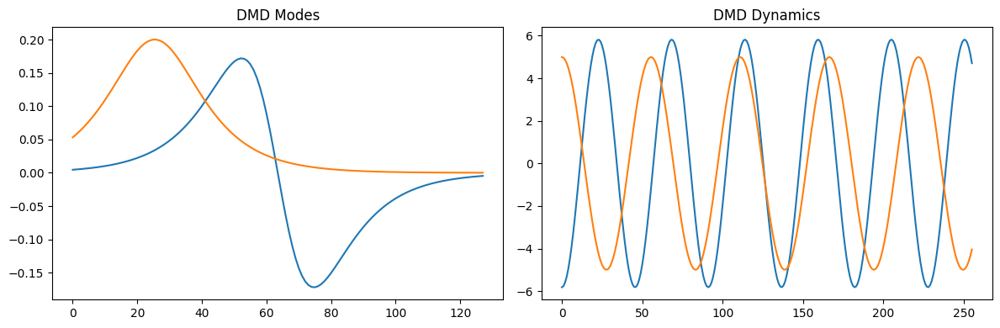

[[ 0.23885411+0.j          0.23740472+0.02635594j  0.23307355+0.05239655j
  ... -0.21935838-0.0946075j  -0.20755608-0.11822059j
  -0.19323704-0.14039492j]
 [ 0.25754297+0.j          0.25598047+0.02841572j  0.25131132+0.05649155j
  ... -0.23652003-0.10201446j -0.2237949 -0.12747274j
  -0.20835664-0.15137996j]
 [ 0.27753608+0.j          0.27585267+0.0306186j   0.2708222 +0.06087107j
  ... -0.25487888-0.10993956j -0.24116666-0.13737116j
  -0.22453141-0.16313162j]
 ...
 [ 0.03232809+0.j          0.03202325+0.00442741j  0.03111449+0.00877121j
  ... -0.03032774-0.01119258j -0.02850972-0.01524095j
  -0.02615398-0.01900198j]
 [ 0.029881  +0.j          0.02959924+0.00409228j  0.02875926+0.00810727j
  ... -0.02803207-0.01034536j -0.02635167-0.01408728j
  -0.02417424-0.01756361j]
 [ 0.02761904+0.j          0.02735861+0.00378249j  0.02658222+0.00749356j
  ... -0.02591007-0.00956222j -0.02435687-0.01302088j
  -0.02234427-0.01623407j]]


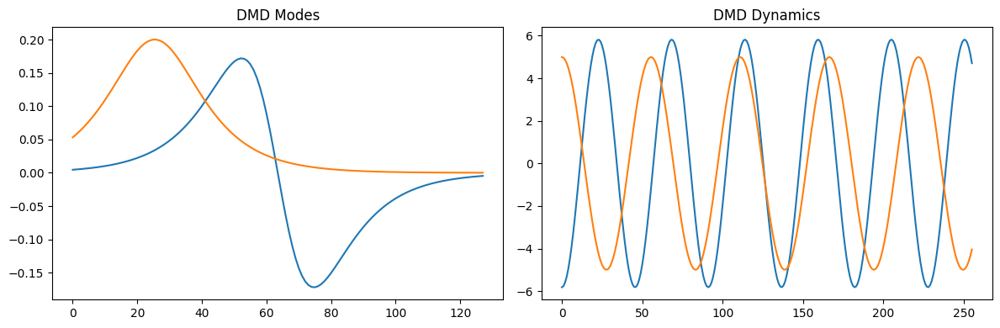

[[ 0.23885411+0.j          0.23740472+0.02635594j  0.23307355+0.05239655j
  ... -0.21935838-0.0946075j  -0.20755608-0.11822059j
  -0.19323704-0.14039492j]
 [ 0.25754297+0.j          0.25598047+0.02841572j  0.25131132+0.05649155j
  ... -0.23652003-0.10201446j -0.2237949 -0.12747274j
  -0.20835664-0.15137996j]
 [ 0.27753608+0.j          0.27585267+0.0306186j   0.2708222 +0.06087107j
  ... -0.25487888-0.10993956j -0.24116666-0.13737116j
  -0.22453141-0.16313162j]
 ...
 [ 0.03232809+0.j          0.03202325+0.00442741j  0.03111449+0.00877121j
  ... -0.03032774-0.01119258j -0.02850972-0.01524095j
  -0.02615398-0.01900198j]
 [ 0.029881  +0.j          0.02959924+0.00409228j  0.02875926+0.00810727j
  ... -0.02803207-0.01034536j -0.02635167-0.01408728j
  -0.02417424-0.01756361j]
 [ 0.02761904+0.j          0.02735861+0.00378249j  0.02658222+0.00749356j
  ... -0.02591007-0.00956222j -0.02435687-0.01302088j
  -0.02234427-0.01623407j]]


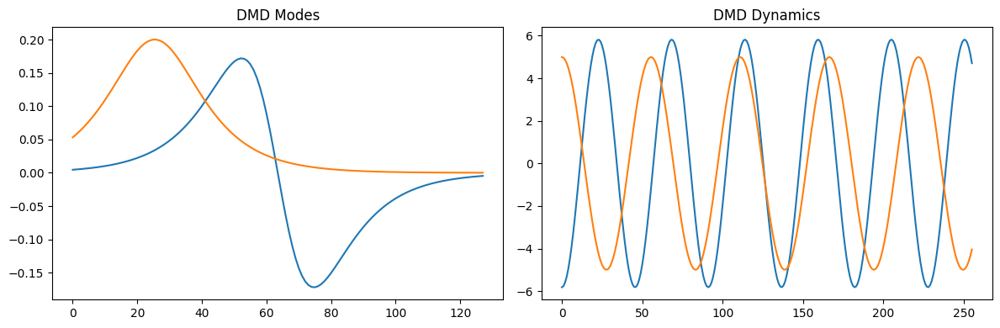

[[ 0.23885411+0.j          0.23740472+0.02635594j  0.23307355+0.05239655j
  ... -0.21935838-0.0946075j  -0.20755608-0.11822059j
  -0.19323704-0.14039492j]
 [ 0.25754297+0.j          0.25598047+0.02841572j  0.25131132+0.05649155j
  ... -0.23652003-0.10201446j -0.2237949 -0.12747274j
  -0.20835664-0.15137996j]
 [ 0.27753608+0.j          0.27585267+0.0306186j   0.2708222 +0.06087107j
  ... -0.25487888-0.10993956j -0.24116666-0.13737116j
  -0.22453141-0.16313162j]
 ...
 [ 0.03232809+0.j          0.03202325+0.00442741j  0.03111449+0.00877121j
  ... -0.03032774-0.01119258j -0.02850972-0.01524095j
  -0.02615398-0.01900198j]
 [ 0.029881  +0.j          0.02959924+0.00409228j  0.02875926+0.00810727j
  ... -0.02803207-0.01034536j -0.02635167-0.01408728j
  -0.02417424-0.01756361j]
 [ 0.02761904+0.j          0.02735861+0.00378249j  0.02658222+0.00749356j
  ... -0.02591007-0.00956222j -0.02435687-0.01302088j
  -0.02234427-0.01623407j]]


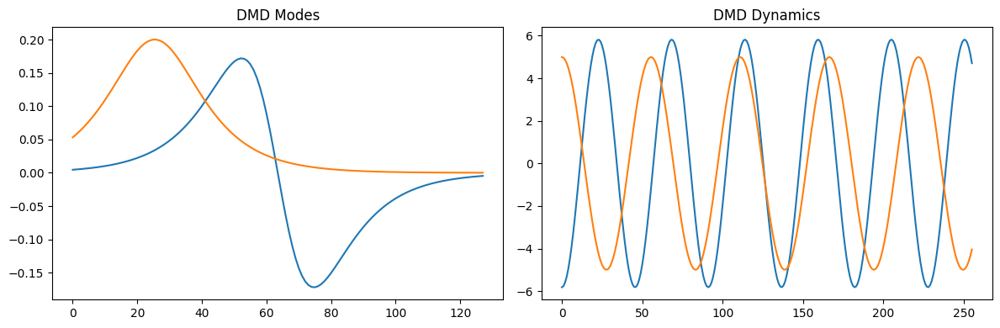

[[ 0.23885411+0.j          0.23740472+0.02635594j  0.23307355+0.05239655j
  ... -0.21935838-0.0946075j  -0.20755608-0.11822059j
  -0.19323704-0.14039492j]
 [ 0.25754297+0.j          0.25598047+0.02841572j  0.25131132+0.05649155j
  ... -0.23652003-0.10201446j -0.2237949 -0.12747274j
  -0.20835664-0.15137996j]
 [ 0.27753608+0.j          0.27585267+0.0306186j   0.2708222 +0.06087107j
  ... -0.25487888-0.10993956j -0.24116666-0.13737116j
  -0.22453141-0.16313162j]
 ...
 [ 0.03232809+0.j          0.03202325+0.00442741j  0.03111449+0.00877121j
  ... -0.03032774-0.01119258j -0.02850972-0.01524095j
  -0.02615398-0.01900198j]
 [ 0.029881  +0.j          0.02959924+0.00409228j  0.02875926+0.00810727j
  ... -0.02803207-0.01034536j -0.02635167-0.01408728j
  -0.02417424-0.01756361j]
 [ 0.02761904+0.j          0.02735861+0.00378249j  0.02658222+0.00749356j
  ... -0.02591007-0.00956222j -0.02435687-0.01302088j
  -0.02234427-0.01623407j]]


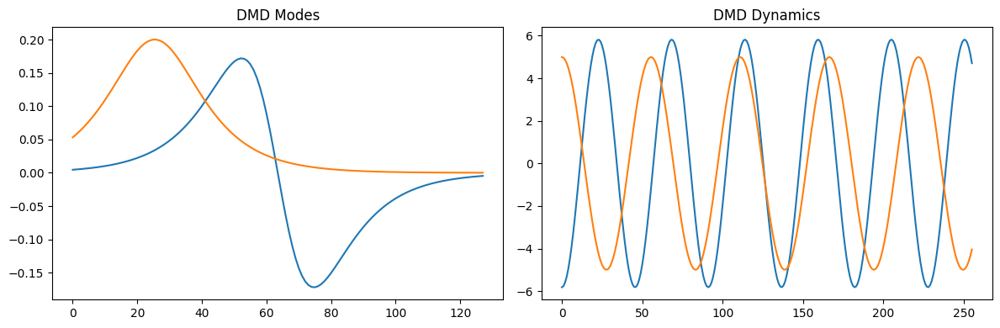

[[ 0.23885411+0.j          0.23740472+0.02635594j  0.23307355+0.05239655j
  ... -0.21935838-0.0946075j  -0.20755608-0.11822059j
  -0.19323704-0.14039492j]
 [ 0.25754297+0.j          0.25598047+0.02841572j  0.25131132+0.05649155j
  ... -0.23652003-0.10201446j -0.2237949 -0.12747274j
  -0.20835664-0.15137996j]
 [ 0.27753608+0.j          0.27585267+0.0306186j   0.2708222 +0.06087107j
  ... -0.25487888-0.10993956j -0.24116666-0.13737116j
  -0.22453141-0.16313162j]
 ...
 [ 0.03232809+0.j          0.03202325+0.00442741j  0.03111449+0.00877121j
  ... -0.03032774-0.01119258j -0.02850972-0.01524095j
  -0.02615398-0.01900198j]
 [ 0.029881  +0.j          0.02959924+0.00409228j  0.02875926+0.00810727j
  ... -0.02803207-0.01034536j -0.02635167-0.01408728j
  -0.02417424-0.01756361j]
 [ 0.02761904+0.j          0.02735861+0.00378249j  0.02658222+0.00749356j
  ... -0.02591007-0.00956222j -0.02435687-0.01302088j
  -0.02234427-0.01623407j]]


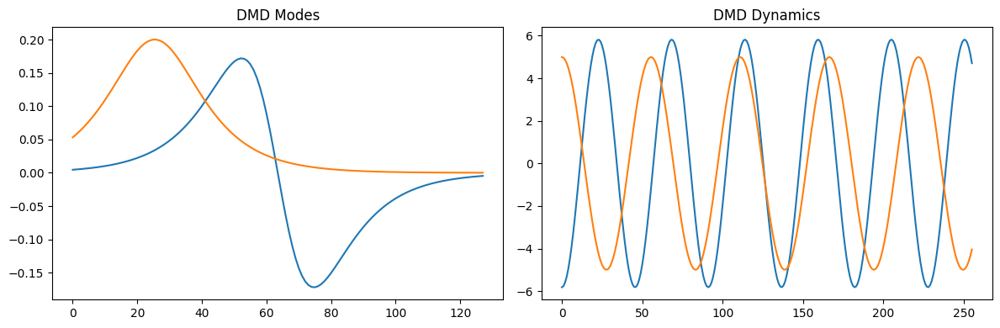

[[ 0.23885411+0.j          0.23740472+0.02635594j  0.23307355+0.05239655j
  ... -0.21935838-0.0946075j  -0.20755608-0.11822059j
  -0.19323704-0.14039492j]
 [ 0.25754297+0.j          0.25598047+0.02841572j  0.25131132+0.05649155j
  ... -0.23652003-0.10201446j -0.2237949 -0.12747274j
  -0.20835664-0.15137996j]
 [ 0.27753608+0.j          0.27585267+0.0306186j   0.2708222 +0.06087107j
  ... -0.25487888-0.10993956j -0.24116666-0.13737116j
  -0.22453141-0.16313162j]
 ...
 [ 0.03232809+0.j          0.03202325+0.00442741j  0.03111449+0.00877121j
  ... -0.03032774-0.01119258j -0.02850972-0.01524095j
  -0.02615398-0.01900198j]
 [ 0.029881  +0.j          0.02959924+0.00409228j  0.02875926+0.00810727j
  ... -0.02803207-0.01034536j -0.02635167-0.01408728j
  -0.02417424-0.01756361j]
 [ 0.02761904+0.j          0.02735861+0.00378249j  0.02658222+0.00749356j
  ... -0.02591007-0.00956222j -0.02435687-0.01302088j
  -0.02234427-0.01623407j]]


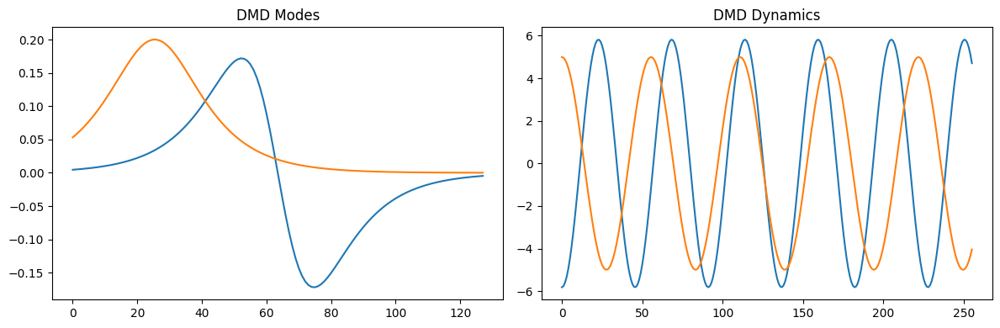

[[ 0.23885411+0.j          0.23740472+0.02635594j  0.23307355+0.05239655j
  ... -0.21935838-0.0946075j  -0.20755608-0.11822059j
  -0.19323704-0.14039492j]
 [ 0.25754297+0.j          0.25598047+0.02841572j  0.25131132+0.05649155j
  ... -0.23652003-0.10201446j -0.2237949 -0.12747274j
  -0.20835664-0.15137996j]
 [ 0.27753608+0.j          0.27585267+0.0306186j   0.2708222 +0.06087107j
  ... -0.25487888-0.10993956j -0.24116666-0.13737116j
  -0.22453141-0.16313162j]
 ...
 [ 0.03232809+0.j          0.03202325+0.00442741j  0.03111449+0.00877121j
  ... -0.03032774-0.01119258j -0.02850972-0.01524095j
  -0.02615398-0.01900198j]
 [ 0.029881  +0.j          0.02959924+0.00409228j  0.02875926+0.00810727j
  ... -0.02803207-0.01034536j -0.02635167-0.01408728j
  -0.02417424-0.01756361j]
 [ 0.02761904+0.j          0.02735861+0.00378249j  0.02658222+0.00749356j
  ... -0.02591007-0.00956222j -0.02435687-0.01302088j
  -0.02234427-0.01623407j]]


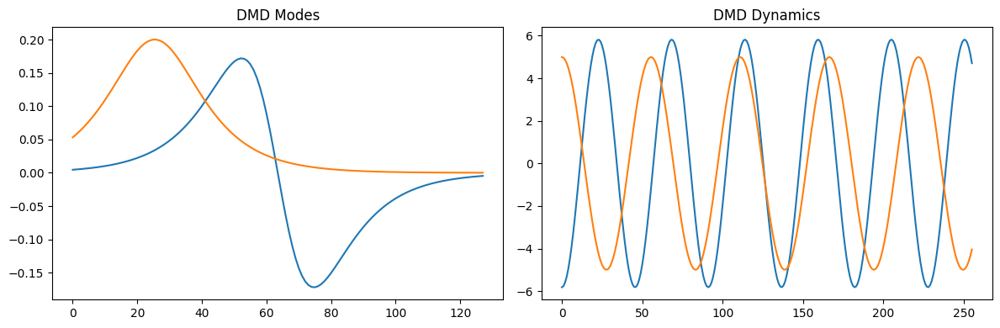

[[ 0.23885411+0.j          0.23740472+0.02635594j  0.23307355+0.05239655j
  ... -0.21935838-0.0946075j  -0.20755608-0.11822059j
  -0.19323704-0.14039492j]
 [ 0.25754297+0.j          0.25598047+0.02841572j  0.25131132+0.05649155j
  ... -0.23652003-0.10201446j -0.2237949 -0.12747274j
  -0.20835664-0.15137996j]
 [ 0.27753608+0.j          0.27585267+0.0306186j   0.2708222 +0.06087107j
  ... -0.25487888-0.10993956j -0.24116666-0.13737116j
  -0.22453141-0.16313162j]
 ...
 [ 0.03232809+0.j          0.03202325+0.00442741j  0.03111449+0.00877121j
  ... -0.03032774-0.01119258j -0.02850972-0.01524095j
  -0.02615398-0.01900198j]
 [ 0.029881  +0.j          0.02959924+0.00409228j  0.02875926+0.00810727j
  ... -0.02803207-0.01034536j -0.02635167-0.01408728j
  -0.02417424-0.01756361j]
 [ 0.02761904+0.j          0.02735861+0.00378249j  0.02658222+0.00749356j
  ... -0.02591007-0.00956222j -0.02435687-0.01302088j
  -0.02234427-0.01623407j]]


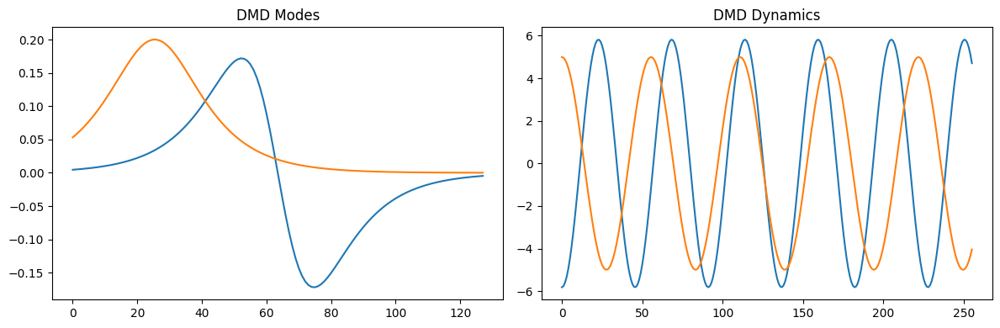

[[ 0.23885411+0.j          0.23740472+0.02635594j  0.23307355+0.05239655j
  ... -0.21935838-0.0946075j  -0.20755608-0.11822059j
  -0.19323704-0.14039492j]
 [ 0.25754297+0.j          0.25598047+0.02841572j  0.25131132+0.05649155j
  ... -0.23652003-0.10201446j -0.2237949 -0.12747274j
  -0.20835664-0.15137996j]
 [ 0.27753608+0.j          0.27585267+0.0306186j   0.2708222 +0.06087107j
  ... -0.25487888-0.10993956j -0.24116666-0.13737116j
  -0.22453141-0.16313162j]
 ...
 [ 0.03232809+0.j          0.03202325+0.00442741j  0.03111449+0.00877121j
  ... -0.03032774-0.01119258j -0.02850972-0.01524095j
  -0.02615398-0.01900198j]
 [ 0.029881  +0.j          0.02959924+0.00409228j  0.02875926+0.00810727j
  ... -0.02803207-0.01034536j -0.02635167-0.01408728j
  -0.02417424-0.01756361j]
 [ 0.02761904+0.j          0.02735861+0.00378249j  0.02658222+0.00749356j
  ... -0.02591007-0.00956222j -0.02435687-0.01302088j
  -0.02234427-0.01623407j]]


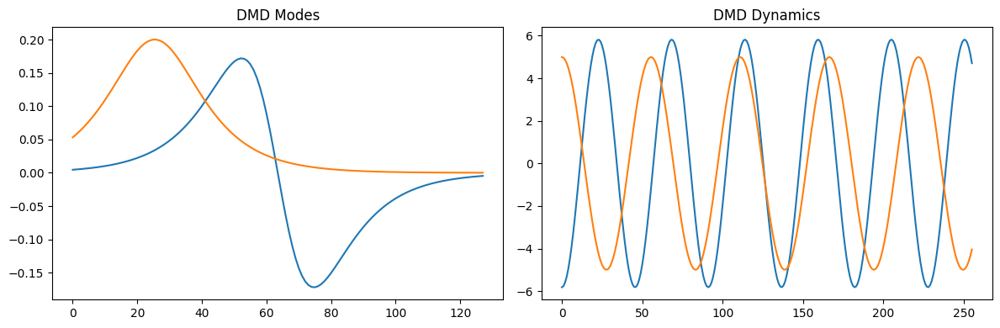

[[ 0.23885411+0.j          0.23740472+0.02635594j  0.23307355+0.05239655j
  ... -0.21935838-0.0946075j  -0.20755608-0.11822059j
  -0.19323704-0.14039492j]
 [ 0.25754297+0.j          0.25598047+0.02841572j  0.25131132+0.05649155j
  ... -0.23652003-0.10201446j -0.2237949 -0.12747274j
  -0.20835664-0.15137996j]
 [ 0.27753608+0.j          0.27585267+0.0306186j   0.2708222 +0.06087107j
  ... -0.25487888-0.10993956j -0.24116666-0.13737116j
  -0.22453141-0.16313162j]
 ...
 [ 0.03232809+0.j          0.03202325+0.00442741j  0.03111449+0.00877121j
  ... -0.03032774-0.01119258j -0.02850972-0.01524095j
  -0.02615398-0.01900198j]
 [ 0.029881  +0.j          0.02959924+0.00409228j  0.02875926+0.00810727j
  ... -0.02803207-0.01034536j -0.02635167-0.01408728j
  -0.02417424-0.01756361j]
 [ 0.02761904+0.j          0.02735861+0.00378249j  0.02658222+0.00749356j
  ... -0.02591007-0.00956222j -0.02435687-0.01302088j
  -0.02234427-0.01623407j]]


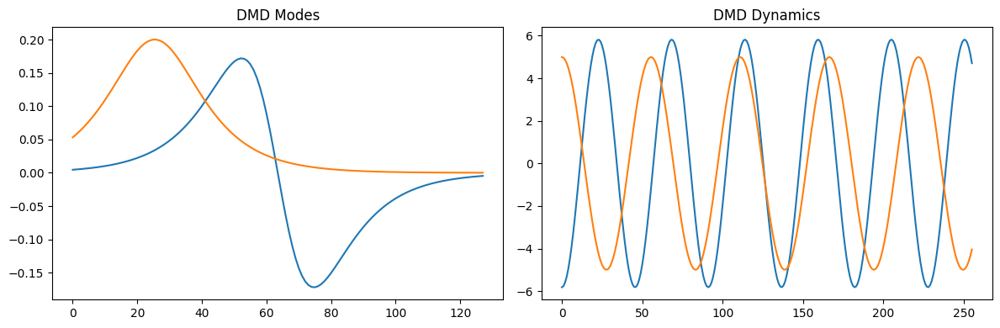

[[ 0.23885411+0.j          0.23740472+0.02635594j  0.23307355+0.05239655j
  ... -0.21935838-0.0946075j  -0.20755608-0.11822059j
  -0.19323704-0.14039492j]
 [ 0.25754297+0.j          0.25598047+0.02841572j  0.25131132+0.05649155j
  ... -0.23652003-0.10201446j -0.2237949 -0.12747274j
  -0.20835664-0.15137996j]
 [ 0.27753608+0.j          0.27585267+0.0306186j   0.2708222 +0.06087107j
  ... -0.25487888-0.10993956j -0.24116666-0.13737116j
  -0.22453141-0.16313162j]
 ...
 [ 0.03232809+0.j          0.03202325+0.00442741j  0.03111449+0.00877121j
  ... -0.03032774-0.01119258j -0.02850972-0.01524095j
  -0.02615398-0.01900198j]
 [ 0.029881  +0.j          0.02959924+0.00409228j  0.02875926+0.00810727j
  ... -0.02803207-0.01034536j -0.02635167-0.01408728j
  -0.02417424-0.01756361j]
 [ 0.02761904+0.j          0.02735861+0.00378249j  0.02658222+0.00749356j
  ... -0.02591007-0.00956222j -0.02435687-0.01302088j
  -0.02234427-0.01623407j]]


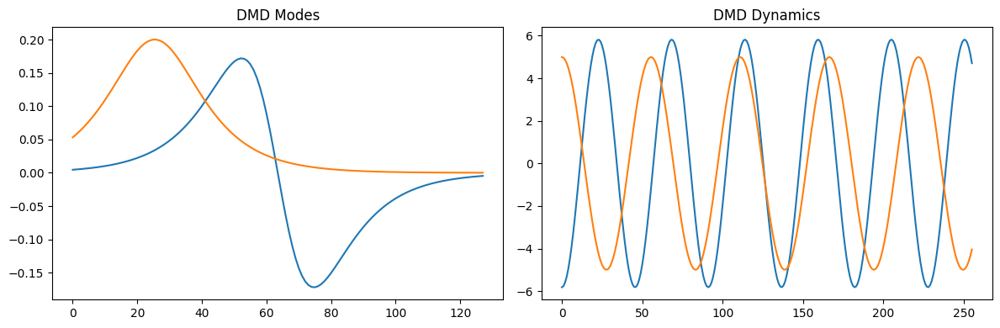

[[ 0.23885411+0.j          0.23740472+0.02635594j  0.23307355+0.05239655j
  ... -0.21935838-0.0946075j  -0.20755608-0.11822059j
  -0.19323704-0.14039492j]
 [ 0.25754297+0.j          0.25598047+0.02841572j  0.25131132+0.05649155j
  ... -0.23652003-0.10201446j -0.2237949 -0.12747274j
  -0.20835664-0.15137996j]
 [ 0.27753608+0.j          0.27585267+0.0306186j   0.2708222 +0.06087107j
  ... -0.25487888-0.10993956j -0.24116666-0.13737116j
  -0.22453141-0.16313162j]
 ...
 [ 0.03232809+0.j          0.03202325+0.00442741j  0.03111449+0.00877121j
  ... -0.03032774-0.01119258j -0.02850972-0.01524095j
  -0.02615398-0.01900198j]
 [ 0.029881  +0.j          0.02959924+0.00409228j  0.02875926+0.00810727j
  ... -0.02803207-0.01034536j -0.02635167-0.01408728j
  -0.02417424-0.01756361j]
 [ 0.02761904+0.j          0.02735861+0.00378249j  0.02658222+0.00749356j
  ... -0.02591007-0.00956222j -0.02435687-0.01302088j
  -0.02234427-0.01623407j]]


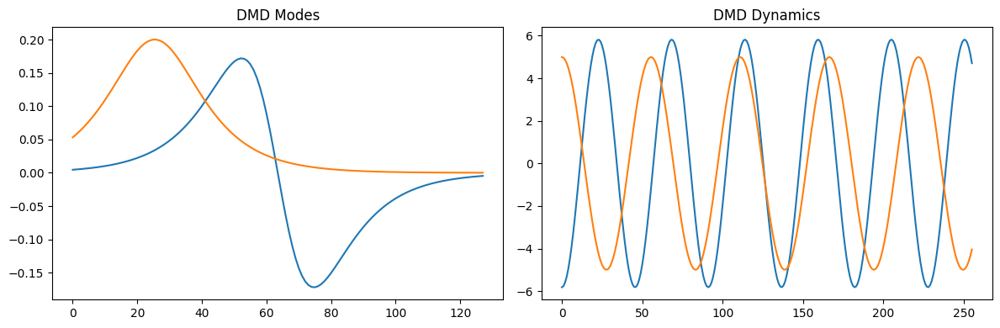

[[ 0.23885411+0.j          0.23740472+0.02635594j  0.23307355+0.05239655j
  ... -0.21935838-0.0946075j  -0.20755608-0.11822059j
  -0.19323704-0.14039492j]
 [ 0.25754297+0.j          0.25598047+0.02841572j  0.25131132+0.05649155j
  ... -0.23652003-0.10201446j -0.2237949 -0.12747274j
  -0.20835664-0.15137996j]
 [ 0.27753608+0.j          0.27585267+0.0306186j   0.2708222 +0.06087107j
  ... -0.25487888-0.10993956j -0.24116666-0.13737116j
  -0.22453141-0.16313162j]
 ...
 [ 0.03232809+0.j          0.03202325+0.00442741j  0.03111449+0.00877121j
  ... -0.03032774-0.01119258j -0.02850972-0.01524095j
  -0.02615398-0.01900198j]
 [ 0.029881  +0.j          0.02959924+0.00409228j  0.02875926+0.00810727j
  ... -0.02803207-0.01034536j -0.02635167-0.01408728j
  -0.02417424-0.01756361j]
 [ 0.02761904+0.j          0.02735861+0.00378249j  0.02658222+0.00749356j
  ... -0.02591007-0.00956222j -0.02435687-0.01302088j
  -0.02234427-0.01623407j]]


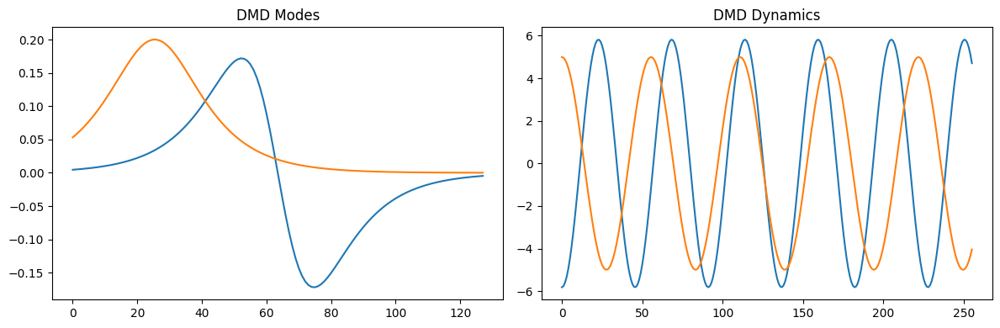

[[ 0.23885411+0.j          0.23740472+0.02635594j  0.23307355+0.05239655j
  ... -0.21935838-0.0946075j  -0.20755608-0.11822059j
  -0.19323704-0.14039492j]
 [ 0.25754297+0.j          0.25598047+0.02841572j  0.25131132+0.05649155j
  ... -0.23652003-0.10201446j -0.2237949 -0.12747274j
  -0.20835664-0.15137996j]
 [ 0.27753608+0.j          0.27585267+0.0306186j   0.2708222 +0.06087107j
  ... -0.25487888-0.10993956j -0.24116666-0.13737116j
  -0.22453141-0.16313162j]
 ...
 [ 0.03232809+0.j          0.03202325+0.00442741j  0.03111449+0.00877121j
  ... -0.03032774-0.01119258j -0.02850972-0.01524095j
  -0.02615398-0.01900198j]
 [ 0.029881  +0.j          0.02959924+0.00409228j  0.02875926+0.00810727j
  ... -0.02803207-0.01034536j -0.02635167-0.01408728j
  -0.02417424-0.01756361j]
 [ 0.02761904+0.j          0.02735861+0.00378249j  0.02658222+0.00749356j
  ... -0.02591007-0.00956222j -0.02435687-0.01302088j
  -0.02234427-0.01623407j]]


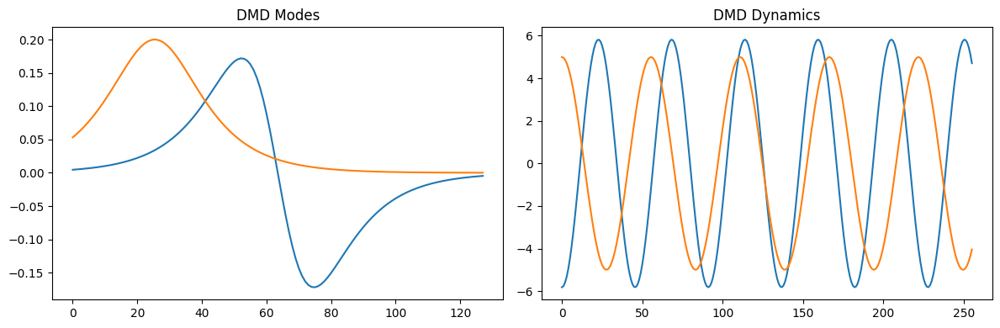

[[ 0.23885411+0.j          0.23740472+0.02635594j  0.23307355+0.05239655j
  ... -0.21935838-0.0946075j  -0.20755608-0.11822059j
  -0.19323704-0.14039492j]
 [ 0.25754297+0.j          0.25598047+0.02841572j  0.25131132+0.05649155j
  ... -0.23652003-0.10201446j -0.2237949 -0.12747274j
  -0.20835664-0.15137996j]
 [ 0.27753608+0.j          0.27585267+0.0306186j   0.2708222 +0.06087107j
  ... -0.25487888-0.10993956j -0.24116666-0.13737116j
  -0.22453141-0.16313162j]
 ...
 [ 0.03232809+0.j          0.03202325+0.00442741j  0.03111449+0.00877121j
  ... -0.03032774-0.01119258j -0.02850972-0.01524095j
  -0.02615398-0.01900198j]
 [ 0.029881  +0.j          0.02959924+0.00409228j  0.02875926+0.00810727j
  ... -0.02803207-0.01034536j -0.02635167-0.01408728j
  -0.02417424-0.01756361j]
 [ 0.02761904+0.j          0.02735861+0.00378249j  0.02658222+0.00749356j
  ... -0.02591007-0.00956222j -0.02435687-0.01302088j
  -0.02234427-0.01623407j]]


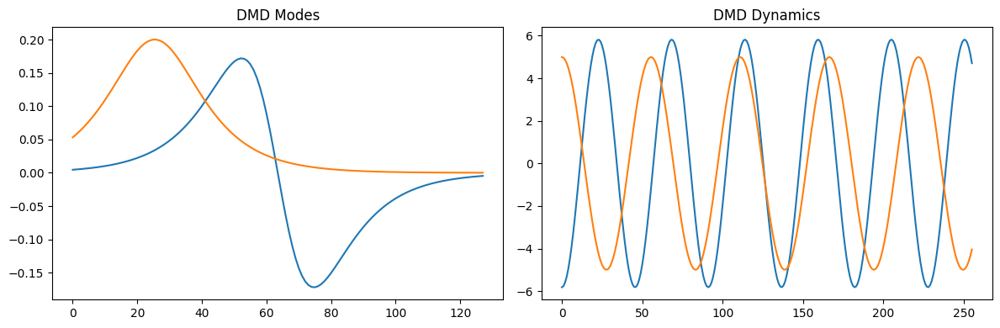

[[ 0.23885411+0.j          0.23740472+0.02635594j  0.23307355+0.05239655j
  ... -0.21935838-0.0946075j  -0.20755608-0.11822059j
  -0.19323704-0.14039492j]
 [ 0.25754297+0.j          0.25598047+0.02841572j  0.25131132+0.05649155j
  ... -0.23652003-0.10201446j -0.2237949 -0.12747274j
  -0.20835664-0.15137996j]
 [ 0.27753608+0.j          0.27585267+0.0306186j   0.2708222 +0.06087107j
  ... -0.25487888-0.10993956j -0.24116666-0.13737116j
  -0.22453141-0.16313162j]
 ...
 [ 0.03232809+0.j          0.03202325+0.00442741j  0.03111449+0.00877121j
  ... -0.03032774-0.01119258j -0.02850972-0.01524095j
  -0.02615398-0.01900198j]
 [ 0.029881  +0.j          0.02959924+0.00409228j  0.02875926+0.00810727j
  ... -0.02803207-0.01034536j -0.02635167-0.01408728j
  -0.02417424-0.01756361j]
 [ 0.02761904+0.j          0.02735861+0.00378249j  0.02658222+0.00749356j
  ... -0.02591007-0.00956222j -0.02435687-0.01302088j
  -0.02234427-0.01623407j]]


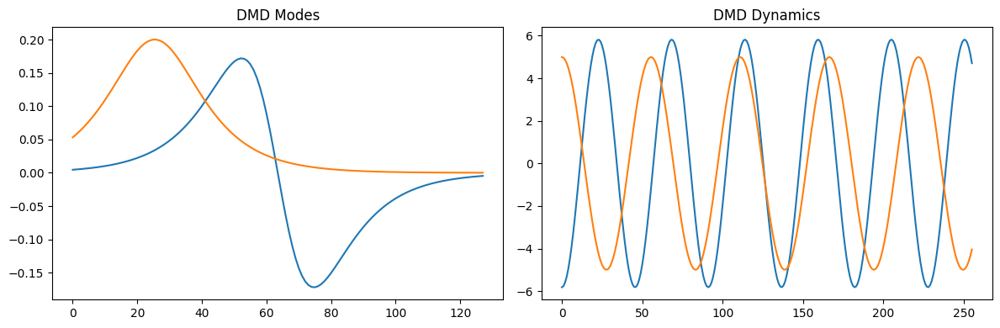

[[ 0.23885411+0.j          0.23740472+0.02635594j  0.23307355+0.05239655j
  ... -0.21935838-0.0946075j  -0.20755608-0.11822059j
  -0.19323704-0.14039492j]
 [ 0.25754297+0.j          0.25598047+0.02841572j  0.25131132+0.05649155j
  ... -0.23652003-0.10201446j -0.2237949 -0.12747274j
  -0.20835664-0.15137996j]
 [ 0.27753608+0.j          0.27585267+0.0306186j   0.2708222 +0.06087107j
  ... -0.25487888-0.10993956j -0.24116666-0.13737116j
  -0.22453141-0.16313162j]
 ...
 [ 0.03232809+0.j          0.03202325+0.00442741j  0.03111449+0.00877121j
  ... -0.03032774-0.01119258j -0.02850972-0.01524095j
  -0.02615398-0.01900198j]
 [ 0.029881  +0.j          0.02959924+0.00409228j  0.02875926+0.00810727j
  ... -0.02803207-0.01034536j -0.02635167-0.01408728j
  -0.02417424-0.01756361j]
 [ 0.02761904+0.j          0.02735861+0.00378249j  0.02658222+0.00749356j
  ... -0.02591007-0.00956222j -0.02435687-0.01302088j
  -0.02234427-0.01623407j]]


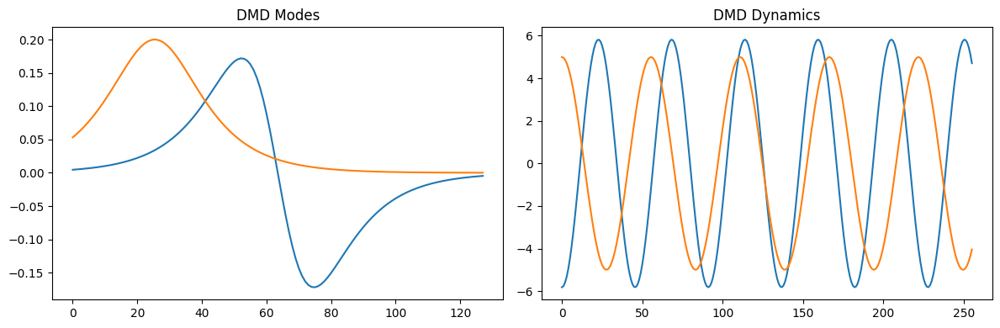

[[ 0.23885411+0.j          0.23740472+0.02635594j  0.23307355+0.05239655j
  ... -0.21935838-0.0946075j  -0.20755608-0.11822059j
  -0.19323704-0.14039492j]
 [ 0.25754297+0.j          0.25598047+0.02841572j  0.25131132+0.05649155j
  ... -0.23652003-0.10201446j -0.2237949 -0.12747274j
  -0.20835664-0.15137996j]
 [ 0.27753608+0.j          0.27585267+0.0306186j   0.2708222 +0.06087107j
  ... -0.25487888-0.10993956j -0.24116666-0.13737116j
  -0.22453141-0.16313162j]
 ...
 [ 0.03232809+0.j          0.03202325+0.00442741j  0.03111449+0.00877121j
  ... -0.03032774-0.01119258j -0.02850972-0.01524095j
  -0.02615398-0.01900198j]
 [ 0.029881  +0.j          0.02959924+0.00409228j  0.02875926+0.00810727j
  ... -0.02803207-0.01034536j -0.02635167-0.01408728j
  -0.02417424-0.01756361j]
 [ 0.02761904+0.j          0.02735861+0.00378249j  0.02658222+0.00749356j
  ... -0.02591007-0.00956222j -0.02435687-0.01302088j
  -0.02234427-0.01623407j]]


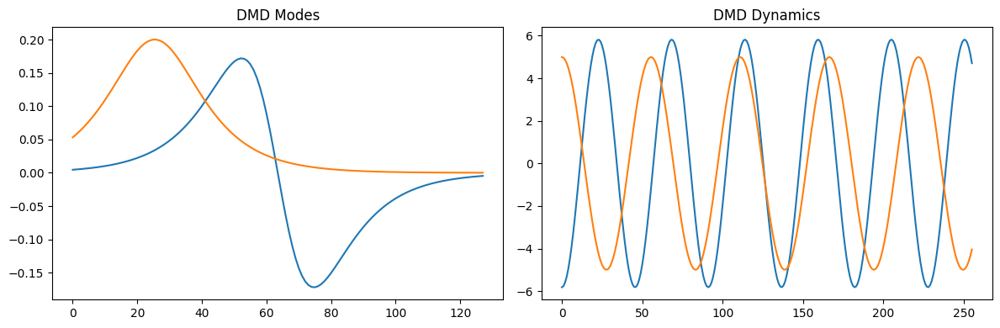

[[ 0.23885411+0.j          0.23740472+0.02635594j  0.23307355+0.05239655j
  ... -0.21935838-0.0946075j  -0.20755608-0.11822059j
  -0.19323704-0.14039492j]
 [ 0.25754297+0.j          0.25598047+0.02841572j  0.25131132+0.05649155j
  ... -0.23652003-0.10201446j -0.2237949 -0.12747274j
  -0.20835664-0.15137996j]
 [ 0.27753608+0.j          0.27585267+0.0306186j   0.2708222 +0.06087107j
  ... -0.25487888-0.10993956j -0.24116666-0.13737116j
  -0.22453141-0.16313162j]
 ...
 [ 0.03232809+0.j          0.03202325+0.00442741j  0.03111449+0.00877121j
  ... -0.03032774-0.01119258j -0.02850972-0.01524095j
  -0.02615398-0.01900198j]
 [ 0.029881  +0.j          0.02959924+0.00409228j  0.02875926+0.00810727j
  ... -0.02803207-0.01034536j -0.02635167-0.01408728j
  -0.02417424-0.01756361j]
 [ 0.02761904+0.j          0.02735861+0.00378249j  0.02658222+0.00749356j
  ... -0.02591007-0.00956222j -0.02435687-0.01302088j
  -0.02234427-0.01623407j]]


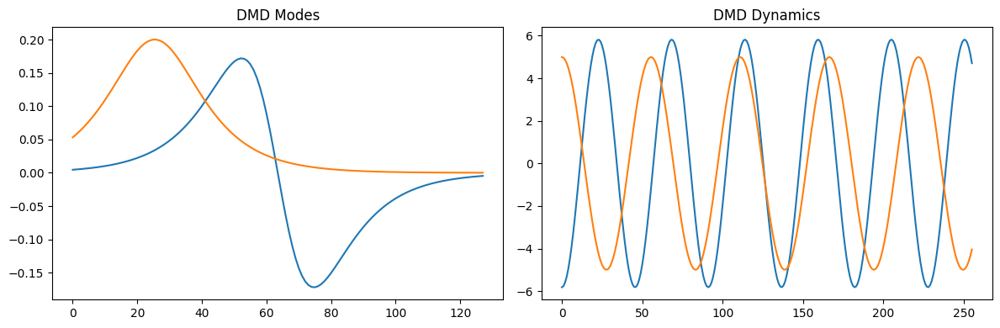

[[ 0.23885411+0.j          0.23740472+0.02635594j  0.23307355+0.05239655j
  ... -0.21935838-0.0946075j  -0.20755608-0.11822059j
  -0.19323704-0.14039492j]
 [ 0.25754297+0.j          0.25598047+0.02841572j  0.25131132+0.05649155j
  ... -0.23652003-0.10201446j -0.2237949 -0.12747274j
  -0.20835664-0.15137996j]
 [ 0.27753608+0.j          0.27585267+0.0306186j   0.2708222 +0.06087107j
  ... -0.25487888-0.10993956j -0.24116666-0.13737116j
  -0.22453141-0.16313162j]
 ...
 [ 0.03232809+0.j          0.03202325+0.00442741j  0.03111449+0.00877121j
  ... -0.03032774-0.01119258j -0.02850972-0.01524095j
  -0.02615398-0.01900198j]
 [ 0.029881  +0.j          0.02959924+0.00409228j  0.02875926+0.00810727j
  ... -0.02803207-0.01034536j -0.02635167-0.01408728j
  -0.02417424-0.01756361j]
 [ 0.02761904+0.j          0.02735861+0.00378249j  0.02658222+0.00749356j
  ... -0.02591007-0.00956222j -0.02435687-0.01302088j
  -0.02234427-0.01623407j]]


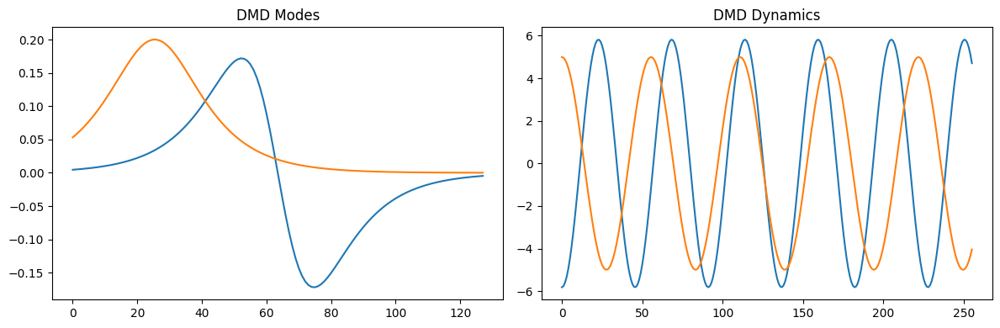

[[ 0.23885411+0.j          0.23740472+0.02635594j  0.23307355+0.05239655j
  ... -0.21935838-0.0946075j  -0.20755608-0.11822059j
  -0.19323704-0.14039492j]
 [ 0.25754297+0.j          0.25598047+0.02841572j  0.25131132+0.05649155j
  ... -0.23652003-0.10201446j -0.2237949 -0.12747274j
  -0.20835664-0.15137996j]
 [ 0.27753608+0.j          0.27585267+0.0306186j   0.2708222 +0.06087107j
  ... -0.25487888-0.10993956j -0.24116666-0.13737116j
  -0.22453141-0.16313162j]
 ...
 [ 0.03232809+0.j          0.03202325+0.00442741j  0.03111449+0.00877121j
  ... -0.03032774-0.01119258j -0.02850972-0.01524095j
  -0.02615398-0.01900198j]
 [ 0.029881  +0.j          0.02959924+0.00409228j  0.02875926+0.00810727j
  ... -0.02803207-0.01034536j -0.02635167-0.01408728j
  -0.02417424-0.01756361j]
 [ 0.02761904+0.j          0.02735861+0.00378249j  0.02658222+0.00749356j
  ... -0.02591007-0.00956222j -0.02435687-0.01302088j
  -0.02234427-0.01623407j]]


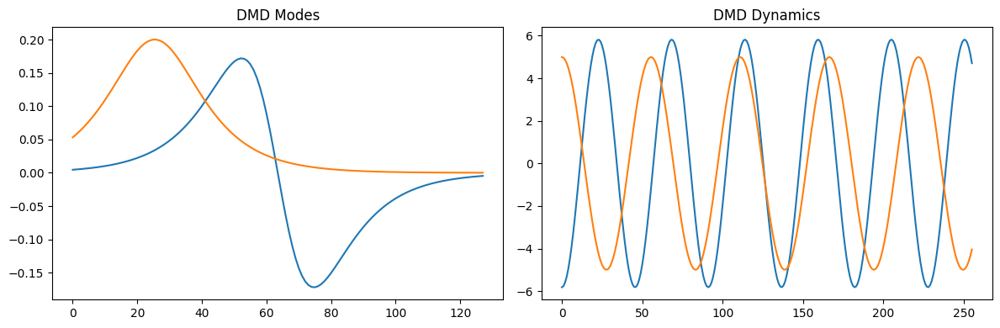

[[ 0.23885411+0.j          0.23740472+0.02635594j  0.23307355+0.05239655j
  ... -0.21935838-0.0946075j  -0.20755608-0.11822059j
  -0.19323704-0.14039492j]
 [ 0.25754297+0.j          0.25598047+0.02841572j  0.25131132+0.05649155j
  ... -0.23652003-0.10201446j -0.2237949 -0.12747274j
  -0.20835664-0.15137996j]
 [ 0.27753608+0.j          0.27585267+0.0306186j   0.2708222 +0.06087107j
  ... -0.25487888-0.10993956j -0.24116666-0.13737116j
  -0.22453141-0.16313162j]
 ...
 [ 0.03232809+0.j          0.03202325+0.00442741j  0.03111449+0.00877121j
  ... -0.03032774-0.01119258j -0.02850972-0.01524095j
  -0.02615398-0.01900198j]
 [ 0.029881  +0.j          0.02959924+0.00409228j  0.02875926+0.00810727j
  ... -0.02803207-0.01034536j -0.02635167-0.01408728j
  -0.02417424-0.01756361j]
 [ 0.02761904+0.j          0.02735861+0.00378249j  0.02658222+0.00749356j
  ... -0.02591007-0.00956222j -0.02435687-0.01302088j
  -0.02234427-0.01623407j]]


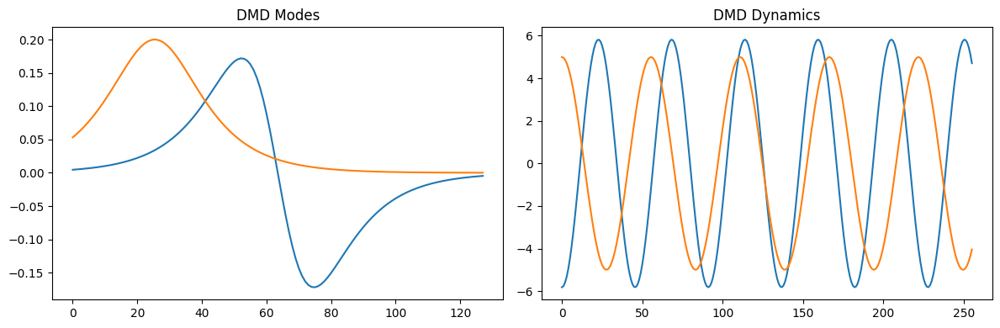

[[ 0.23885411+0.j          0.23740472+0.02635594j  0.23307355+0.05239655j
  ... -0.21935838-0.0946075j  -0.20755608-0.11822059j
  -0.19323704-0.14039492j]
 [ 0.25754297+0.j          0.25598047+0.02841572j  0.25131132+0.05649155j
  ... -0.23652003-0.10201446j -0.2237949 -0.12747274j
  -0.20835664-0.15137996j]
 [ 0.27753608+0.j          0.27585267+0.0306186j   0.2708222 +0.06087107j
  ... -0.25487888-0.10993956j -0.24116666-0.13737116j
  -0.22453141-0.16313162j]
 ...
 [ 0.03232809+0.j          0.03202325+0.00442741j  0.03111449+0.00877121j
  ... -0.03032774-0.01119258j -0.02850972-0.01524095j
  -0.02615398-0.01900198j]
 [ 0.029881  +0.j          0.02959924+0.00409228j  0.02875926+0.00810727j
  ... -0.02803207-0.01034536j -0.02635167-0.01408728j
  -0.02417424-0.01756361j]
 [ 0.02761904+0.j          0.02735861+0.00378249j  0.02658222+0.00749356j
  ... -0.02591007-0.00956222j -0.02435687-0.01302088j
  -0.02234427-0.01623407j]]


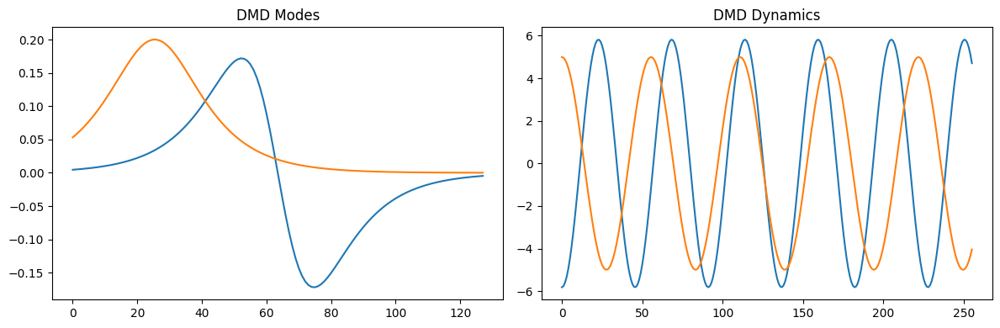

[[ 0.23885411+0.j          0.23740472+0.02635594j  0.23307355+0.05239655j
  ... -0.21935838-0.0946075j  -0.20755608-0.11822059j
  -0.19323704-0.14039492j]
 [ 0.25754297+0.j          0.25598047+0.02841572j  0.25131132+0.05649155j
  ... -0.23652003-0.10201446j -0.2237949 -0.12747274j
  -0.20835664-0.15137996j]
 [ 0.27753608+0.j          0.27585267+0.0306186j   0.2708222 +0.06087107j
  ... -0.25487888-0.10993956j -0.24116666-0.13737116j
  -0.22453141-0.16313162j]
 ...
 [ 0.03232809+0.j          0.03202325+0.00442741j  0.03111449+0.00877121j
  ... -0.03032774-0.01119258j -0.02850972-0.01524095j
  -0.02615398-0.01900198j]
 [ 0.029881  +0.j          0.02959924+0.00409228j  0.02875926+0.00810727j
  ... -0.02803207-0.01034536j -0.02635167-0.01408728j
  -0.02417424-0.01756361j]
 [ 0.02761904+0.j          0.02735861+0.00378249j  0.02658222+0.00749356j
  ... -0.02591007-0.00956222j -0.02435687-0.01302088j
  -0.02234427-0.01623407j]]


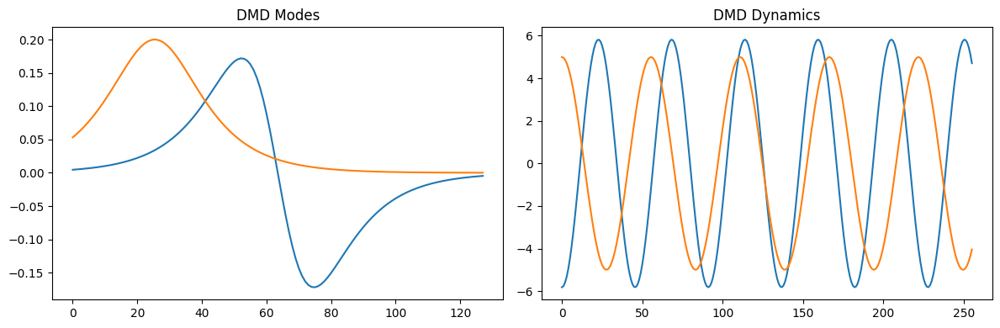

[[ 0.23885411+0.j          0.23740472+0.02635594j  0.23307355+0.05239655j
  ... -0.21935838-0.0946075j  -0.20755608-0.11822059j
  -0.19323704-0.14039492j]
 [ 0.25754297+0.j          0.25598047+0.02841572j  0.25131132+0.05649155j
  ... -0.23652003-0.10201446j -0.2237949 -0.12747274j
  -0.20835664-0.15137996j]
 [ 0.27753608+0.j          0.27585267+0.0306186j   0.2708222 +0.06087107j
  ... -0.25487888-0.10993956j -0.24116666-0.13737116j
  -0.22453141-0.16313162j]
 ...
 [ 0.03232809+0.j          0.03202325+0.00442741j  0.03111449+0.00877121j
  ... -0.03032774-0.01119258j -0.02850972-0.01524095j
  -0.02615398-0.01900198j]
 [ 0.029881  +0.j          0.02959924+0.00409228j  0.02875926+0.00810727j
  ... -0.02803207-0.01034536j -0.02635167-0.01408728j
  -0.02417424-0.01756361j]
 [ 0.02761904+0.j          0.02735861+0.00378249j  0.02658222+0.00749356j
  ... -0.02591007-0.00956222j -0.02435687-0.01302088j
  -0.02234427-0.01623407j]]


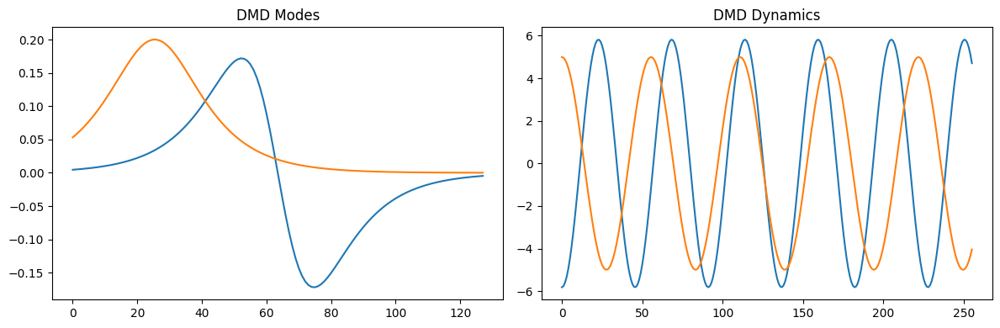

[[ 0.23885411+0.j          0.23740472+0.02635594j  0.23307355+0.05239655j
  ... -0.21935838-0.0946075j  -0.20755608-0.11822059j
  -0.19323704-0.14039492j]
 [ 0.25754297+0.j          0.25598047+0.02841572j  0.25131132+0.05649155j
  ... -0.23652003-0.10201446j -0.2237949 -0.12747274j
  -0.20835664-0.15137996j]
 [ 0.27753608+0.j          0.27585267+0.0306186j   0.2708222 +0.06087107j
  ... -0.25487888-0.10993956j -0.24116666-0.13737116j
  -0.22453141-0.16313162j]
 ...
 [ 0.03232809+0.j          0.03202325+0.00442741j  0.03111449+0.00877121j
  ... -0.03032774-0.01119258j -0.02850972-0.01524095j
  -0.02615398-0.01900198j]
 [ 0.029881  +0.j          0.02959924+0.00409228j  0.02875926+0.00810727j
  ... -0.02803207-0.01034536j -0.02635167-0.01408728j
  -0.02417424-0.01756361j]
 [ 0.02761904+0.j          0.02735861+0.00378249j  0.02658222+0.00749356j
  ... -0.02591007-0.00956222j -0.02435687-0.01302088j
  -0.02234427-0.01623407j]]


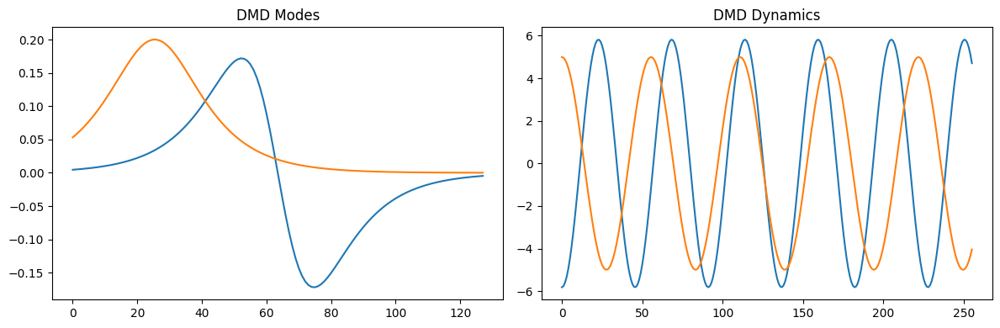

[[ 0.23885411+0.j          0.23740472+0.02635594j  0.23307355+0.05239655j
  ... -0.21935838-0.0946075j  -0.20755608-0.11822059j
  -0.19323704-0.14039492j]
 [ 0.25754297+0.j          0.25598047+0.02841572j  0.25131132+0.05649155j
  ... -0.23652003-0.10201446j -0.2237949 -0.12747274j
  -0.20835664-0.15137996j]
 [ 0.27753608+0.j          0.27585267+0.0306186j   0.2708222 +0.06087107j
  ... -0.25487888-0.10993956j -0.24116666-0.13737116j
  -0.22453141-0.16313162j]
 ...
 [ 0.03232809+0.j          0.03202325+0.00442741j  0.03111449+0.00877121j
  ... -0.03032774-0.01119258j -0.02850972-0.01524095j
  -0.02615398-0.01900198j]
 [ 0.029881  +0.j          0.02959924+0.00409228j  0.02875926+0.00810727j
  ... -0.02803207-0.01034536j -0.02635167-0.01408728j
  -0.02417424-0.01756361j]
 [ 0.02761904+0.j          0.02735861+0.00378249j  0.02658222+0.00749356j
  ... -0.02591007-0.00956222j -0.02435687-0.01302088j
  -0.02234427-0.01623407j]]


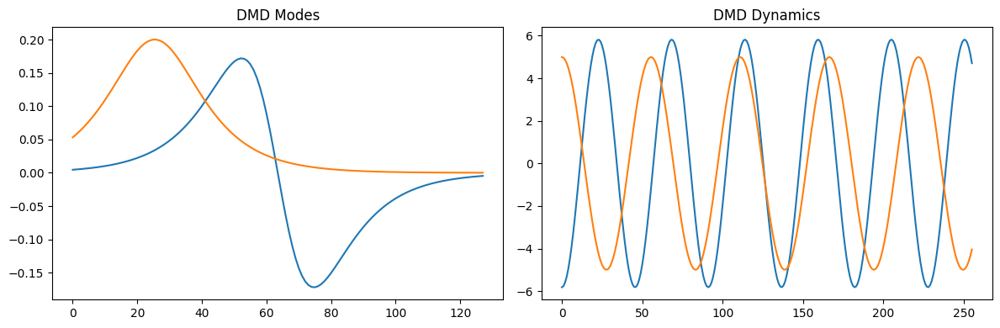

[[ 0.23885411+0.j          0.23740472+0.02635594j  0.23307355+0.05239655j
  ... -0.21935838-0.0946075j  -0.20755608-0.11822059j
  -0.19323704-0.14039492j]
 [ 0.25754297+0.j          0.25598047+0.02841572j  0.25131132+0.05649155j
  ... -0.23652003-0.10201446j -0.2237949 -0.12747274j
  -0.20835664-0.15137996j]
 [ 0.27753608+0.j          0.27585267+0.0306186j   0.2708222 +0.06087107j
  ... -0.25487888-0.10993956j -0.24116666-0.13737116j
  -0.22453141-0.16313162j]
 ...
 [ 0.03232809+0.j          0.03202325+0.00442741j  0.03111449+0.00877121j
  ... -0.03032774-0.01119258j -0.02850972-0.01524095j
  -0.02615398-0.01900198j]
 [ 0.029881  +0.j          0.02959924+0.00409228j  0.02875926+0.00810727j
  ... -0.02803207-0.01034536j -0.02635167-0.01408728j
  -0.02417424-0.01756361j]
 [ 0.02761904+0.j          0.02735861+0.00378249j  0.02658222+0.00749356j
  ... -0.02591007-0.00956222j -0.02435687-0.01302088j
  -0.02234427-0.01623407j]]


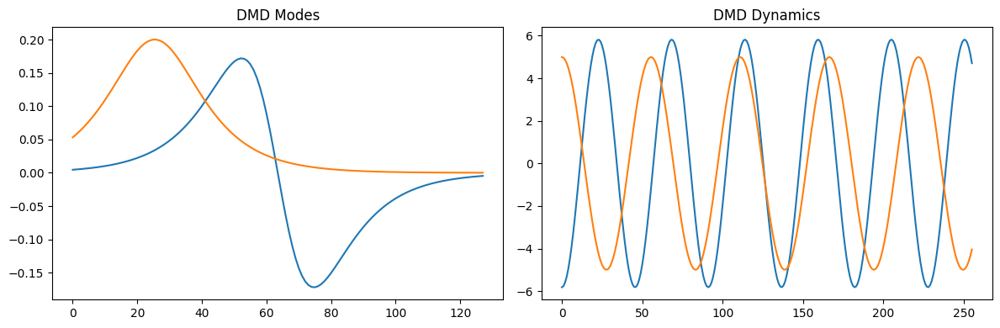

[[ 0.23885411+0.j          0.23740472+0.02635594j  0.23307355+0.05239655j
  ... -0.21935838-0.0946075j  -0.20755608-0.11822059j
  -0.19323704-0.14039492j]
 [ 0.25754297+0.j          0.25598047+0.02841572j  0.25131132+0.05649155j
  ... -0.23652003-0.10201446j -0.2237949 -0.12747274j
  -0.20835664-0.15137996j]
 [ 0.27753608+0.j          0.27585267+0.0306186j   0.2708222 +0.06087107j
  ... -0.25487888-0.10993956j -0.24116666-0.13737116j
  -0.22453141-0.16313162j]
 ...
 [ 0.03232809+0.j          0.03202325+0.00442741j  0.03111449+0.00877121j
  ... -0.03032774-0.01119258j -0.02850972-0.01524095j
  -0.02615398-0.01900198j]
 [ 0.029881  +0.j          0.02959924+0.00409228j  0.02875926+0.00810727j
  ... -0.02803207-0.01034536j -0.02635167-0.01408728j
  -0.02417424-0.01756361j]
 [ 0.02761904+0.j          0.02735861+0.00378249j  0.02658222+0.00749356j
  ... -0.02591007-0.00956222j -0.02435687-0.01302088j
  -0.02234427-0.01623407j]]


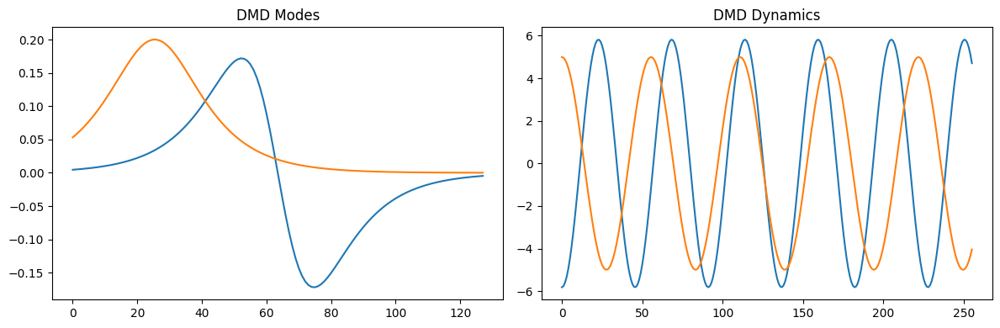

[[ 0.23885411+0.j          0.23740472+0.02635594j  0.23307355+0.05239655j
  ... -0.21935838-0.0946075j  -0.20755608-0.11822059j
  -0.19323704-0.14039492j]
 [ 0.25754297+0.j          0.25598047+0.02841572j  0.25131132+0.05649155j
  ... -0.23652003-0.10201446j -0.2237949 -0.12747274j
  -0.20835664-0.15137996j]
 [ 0.27753608+0.j          0.27585267+0.0306186j   0.2708222 +0.06087107j
  ... -0.25487888-0.10993956j -0.24116666-0.13737116j
  -0.22453141-0.16313162j]
 ...
 [ 0.03232809+0.j          0.03202325+0.00442741j  0.03111449+0.00877121j
  ... -0.03032774-0.01119258j -0.02850972-0.01524095j
  -0.02615398-0.01900198j]
 [ 0.029881  +0.j          0.02959924+0.00409228j  0.02875926+0.00810727j
  ... -0.02803207-0.01034536j -0.02635167-0.01408728j
  -0.02417424-0.01756361j]
 [ 0.02761904+0.j          0.02735861+0.00378249j  0.02658222+0.00749356j
  ... -0.02591007-0.00956222j -0.02435687-0.01302088j
  -0.02234427-0.01623407j]]


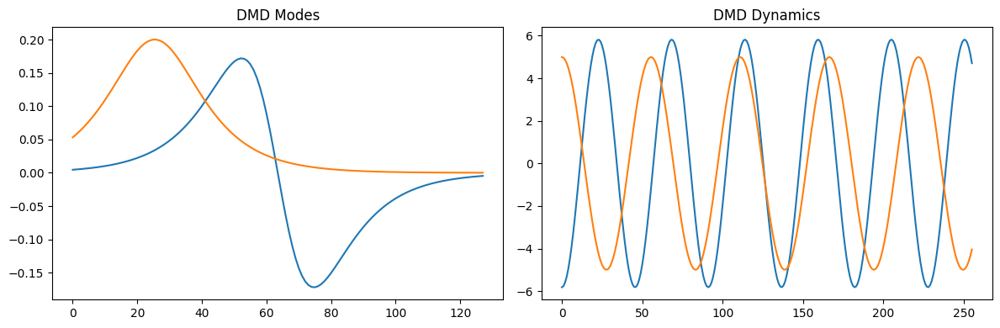

[[ 0.23885411+0.j          0.23740472+0.02635594j  0.23307355+0.05239655j
  ... -0.21935838-0.0946075j  -0.20755608-0.11822059j
  -0.19323704-0.14039492j]
 [ 0.25754297+0.j          0.25598047+0.02841572j  0.25131132+0.05649155j
  ... -0.23652003-0.10201446j -0.2237949 -0.12747274j
  -0.20835664-0.15137996j]
 [ 0.27753608+0.j          0.27585267+0.0306186j   0.2708222 +0.06087107j
  ... -0.25487888-0.10993956j -0.24116666-0.13737116j
  -0.22453141-0.16313162j]
 ...
 [ 0.03232809+0.j          0.03202325+0.00442741j  0.03111449+0.00877121j
  ... -0.03032774-0.01119258j -0.02850972-0.01524095j
  -0.02615398-0.01900198j]
 [ 0.029881  +0.j          0.02959924+0.00409228j  0.02875926+0.00810727j
  ... -0.02803207-0.01034536j -0.02635167-0.01408728j
  -0.02417424-0.01756361j]
 [ 0.02761904+0.j          0.02735861+0.00378249j  0.02658222+0.00749356j
  ... -0.02591007-0.00956222j -0.02435687-0.01302088j
  -0.02234427-0.01623407j]]


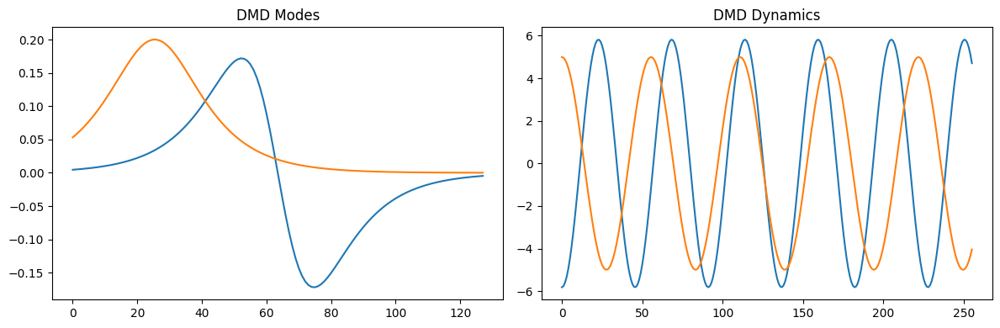

[[ 0.23885411+0.j          0.23740472+0.02635594j  0.23307355+0.05239655j
  ... -0.21935838-0.0946075j  -0.20755608-0.11822059j
  -0.19323704-0.14039492j]
 [ 0.25754297+0.j          0.25598047+0.02841572j  0.25131132+0.05649155j
  ... -0.23652003-0.10201446j -0.2237949 -0.12747274j
  -0.20835664-0.15137996j]
 [ 0.27753608+0.j          0.27585267+0.0306186j   0.2708222 +0.06087107j
  ... -0.25487888-0.10993956j -0.24116666-0.13737116j
  -0.22453141-0.16313162j]
 ...
 [ 0.03232809+0.j          0.03202325+0.00442741j  0.03111449+0.00877121j
  ... -0.03032774-0.01119258j -0.02850972-0.01524095j
  -0.02615398-0.01900198j]
 [ 0.029881  +0.j          0.02959924+0.00409228j  0.02875926+0.00810727j
  ... -0.02803207-0.01034536j -0.02635167-0.01408728j
  -0.02417424-0.01756361j]
 [ 0.02761904+0.j          0.02735861+0.00378249j  0.02658222+0.00749356j
  ... -0.02591007-0.00956222j -0.02435687-0.01302088j
  -0.02234427-0.01623407j]]


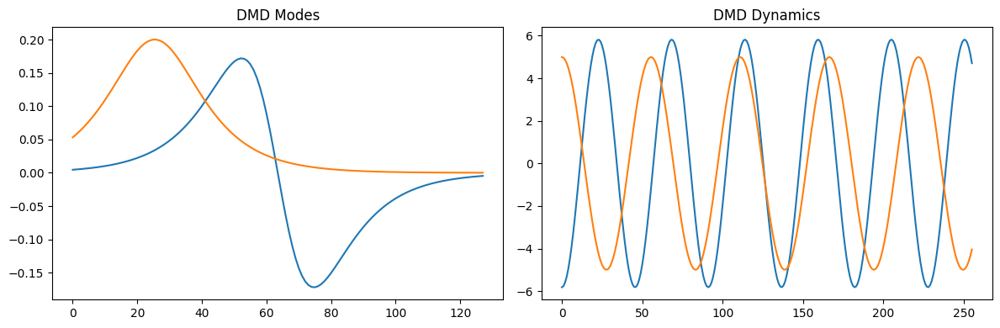

[[ 0.23885411+0.j          0.23740472+0.02635594j  0.23307355+0.05239655j
  ... -0.21935838-0.0946075j  -0.20755608-0.11822059j
  -0.19323704-0.14039492j]
 [ 0.25754297+0.j          0.25598047+0.02841572j  0.25131132+0.05649155j
  ... -0.23652003-0.10201446j -0.2237949 -0.12747274j
  -0.20835664-0.15137996j]
 [ 0.27753608+0.j          0.27585267+0.0306186j   0.2708222 +0.06087107j
  ... -0.25487888-0.10993956j -0.24116666-0.13737116j
  -0.22453141-0.16313162j]
 ...
 [ 0.03232809+0.j          0.03202325+0.00442741j  0.03111449+0.00877121j
  ... -0.03032774-0.01119258j -0.02850972-0.01524095j
  -0.02615398-0.01900198j]
 [ 0.029881  +0.j          0.02959924+0.00409228j  0.02875926+0.00810727j
  ... -0.02803207-0.01034536j -0.02635167-0.01408728j
  -0.02417424-0.01756361j]
 [ 0.02761904+0.j          0.02735861+0.00378249j  0.02658222+0.00749356j
  ... -0.02591007-0.00956222j -0.02435687-0.01302088j
  -0.02234427-0.01623407j]]


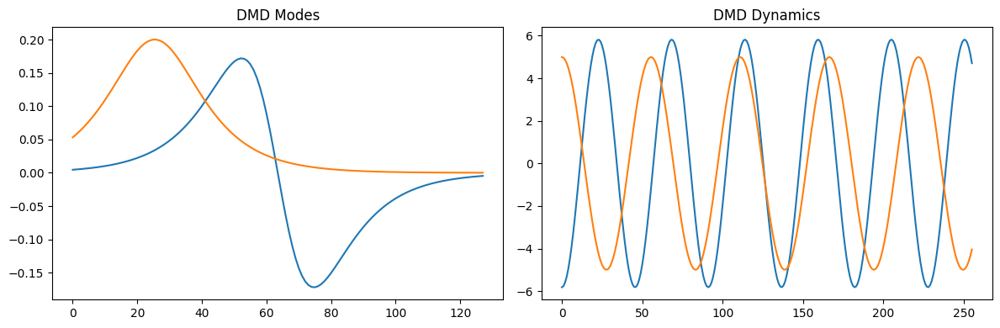

[[ 0.23885411+0.j          0.23740472+0.02635594j  0.23307355+0.05239655j
  ... -0.21935838-0.0946075j  -0.20755608-0.11822059j
  -0.19323704-0.14039492j]
 [ 0.25754297+0.j          0.25598047+0.02841572j  0.25131132+0.05649155j
  ... -0.23652003-0.10201446j -0.2237949 -0.12747274j
  -0.20835664-0.15137996j]
 [ 0.27753608+0.j          0.27585267+0.0306186j   0.2708222 +0.06087107j
  ... -0.25487888-0.10993956j -0.24116666-0.13737116j
  -0.22453141-0.16313162j]
 ...
 [ 0.03232809+0.j          0.03202325+0.00442741j  0.03111449+0.00877121j
  ... -0.03032774-0.01119258j -0.02850972-0.01524095j
  -0.02615398-0.01900198j]
 [ 0.029881  +0.j          0.02959924+0.00409228j  0.02875926+0.00810727j
  ... -0.02803207-0.01034536j -0.02635167-0.01408728j
  -0.02417424-0.01756361j]
 [ 0.02761904+0.j          0.02735861+0.00378249j  0.02658222+0.00749356j
  ... -0.02591007-0.00956222j -0.02435687-0.01302088j
  -0.02234427-0.01623407j]]


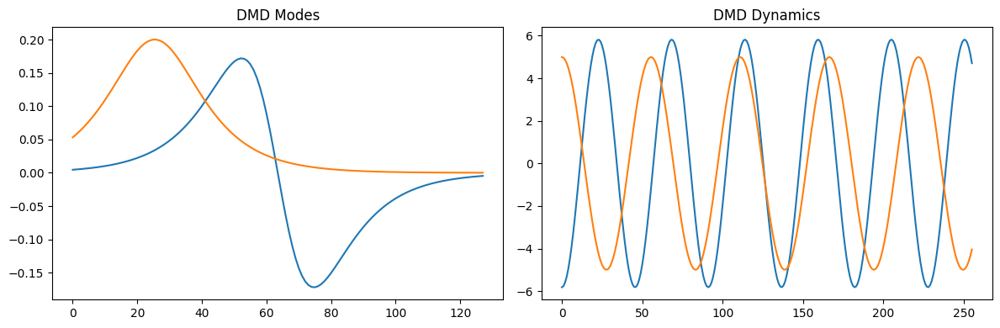

[[ 0.23885411+0.j          0.23740472+0.02635594j  0.23307355+0.05239655j
  ... -0.21935838-0.0946075j  -0.20755608-0.11822059j
  -0.19323704-0.14039492j]
 [ 0.25754297+0.j          0.25598047+0.02841572j  0.25131132+0.05649155j
  ... -0.23652003-0.10201446j -0.2237949 -0.12747274j
  -0.20835664-0.15137996j]
 [ 0.27753608+0.j          0.27585267+0.0306186j   0.2708222 +0.06087107j
  ... -0.25487888-0.10993956j -0.24116666-0.13737116j
  -0.22453141-0.16313162j]
 ...
 [ 0.03232809+0.j          0.03202325+0.00442741j  0.03111449+0.00877121j
  ... -0.03032774-0.01119258j -0.02850972-0.01524095j
  -0.02615398-0.01900198j]
 [ 0.029881  +0.j          0.02959924+0.00409228j  0.02875926+0.00810727j
  ... -0.02803207-0.01034536j -0.02635167-0.01408728j
  -0.02417424-0.01756361j]
 [ 0.02761904+0.j          0.02735861+0.00378249j  0.02658222+0.00749356j
  ... -0.02591007-0.00956222j -0.02435687-0.01302088j
  -0.02234427-0.01623407j]]


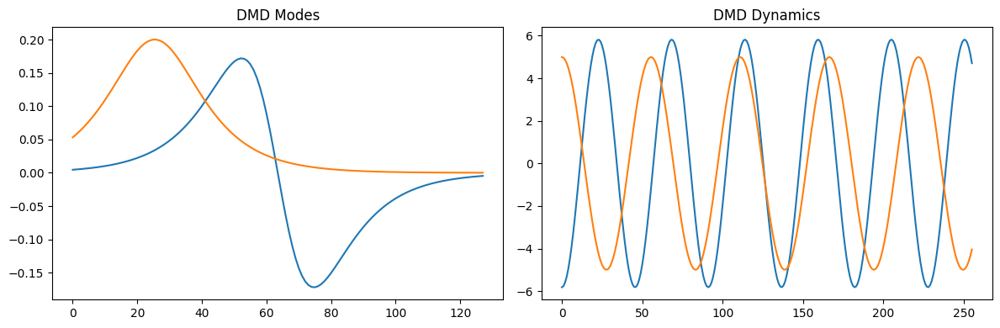

[[ 0.23885411+0.j          0.23740472+0.02635594j  0.23307355+0.05239655j
  ... -0.21935838-0.0946075j  -0.20755608-0.11822059j
  -0.19323704-0.14039492j]
 [ 0.25754297+0.j          0.25598047+0.02841572j  0.25131132+0.05649155j
  ... -0.23652003-0.10201446j -0.2237949 -0.12747274j
  -0.20835664-0.15137996j]
 [ 0.27753608+0.j          0.27585267+0.0306186j   0.2708222 +0.06087107j
  ... -0.25487888-0.10993956j -0.24116666-0.13737116j
  -0.22453141-0.16313162j]
 ...
 [ 0.03232809+0.j          0.03202325+0.00442741j  0.03111449+0.00877121j
  ... -0.03032774-0.01119258j -0.02850972-0.01524095j
  -0.02615398-0.01900198j]
 [ 0.029881  +0.j          0.02959924+0.00409228j  0.02875926+0.00810727j
  ... -0.02803207-0.01034536j -0.02635167-0.01408728j
  -0.02417424-0.01756361j]
 [ 0.02761904+0.j          0.02735861+0.00378249j  0.02658222+0.00749356j
  ... -0.02591007-0.00956222j -0.02435687-0.01302088j
  -0.02234427-0.01623407j]]


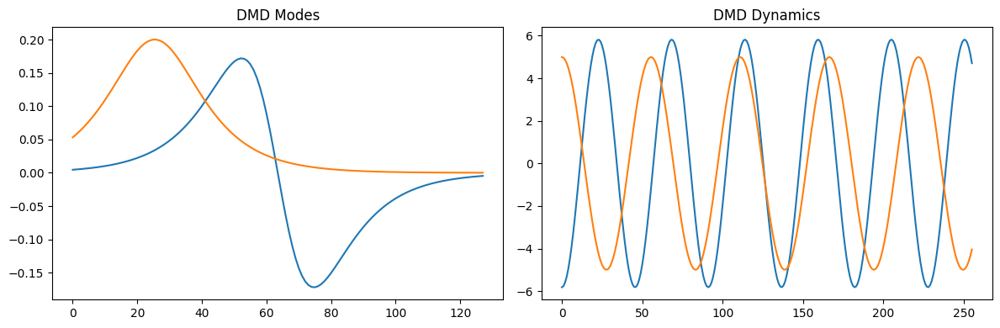

[[ 0.23885411+0.j          0.23740472+0.02635594j  0.23307355+0.05239655j
  ... -0.21935838-0.0946075j  -0.20755608-0.11822059j
  -0.19323704-0.14039492j]
 [ 0.25754297+0.j          0.25598047+0.02841572j  0.25131132+0.05649155j
  ... -0.23652003-0.10201446j -0.2237949 -0.12747274j
  -0.20835664-0.15137996j]
 [ 0.27753608+0.j          0.27585267+0.0306186j   0.2708222 +0.06087107j
  ... -0.25487888-0.10993956j -0.24116666-0.13737116j
  -0.22453141-0.16313162j]
 ...
 [ 0.03232809+0.j          0.03202325+0.00442741j  0.03111449+0.00877121j
  ... -0.03032774-0.01119258j -0.02850972-0.01524095j
  -0.02615398-0.01900198j]
 [ 0.029881  +0.j          0.02959924+0.00409228j  0.02875926+0.00810727j
  ... -0.02803207-0.01034536j -0.02635167-0.01408728j
  -0.02417424-0.01756361j]
 [ 0.02761904+0.j          0.02735861+0.00378249j  0.02658222+0.00749356j
  ... -0.02591007-0.00956222j -0.02435687-0.01302088j
  -0.02234427-0.01623407j]]


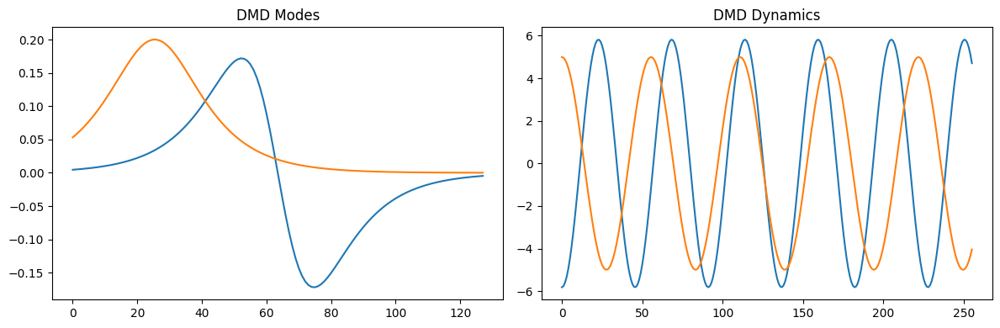

[[ 0.23885411+0.j          0.23740472+0.02635594j  0.23307355+0.05239655j
  ... -0.21935838-0.0946075j  -0.20755608-0.11822059j
  -0.19323704-0.14039492j]
 [ 0.25754297+0.j          0.25598047+0.02841572j  0.25131132+0.05649155j
  ... -0.23652003-0.10201446j -0.2237949 -0.12747274j
  -0.20835664-0.15137996j]
 [ 0.27753608+0.j          0.27585267+0.0306186j   0.2708222 +0.06087107j
  ... -0.25487888-0.10993956j -0.24116666-0.13737116j
  -0.22453141-0.16313162j]
 ...
 [ 0.03232809+0.j          0.03202325+0.00442741j  0.03111449+0.00877121j
  ... -0.03032774-0.01119258j -0.02850972-0.01524095j
  -0.02615398-0.01900198j]
 [ 0.029881  +0.j          0.02959924+0.00409228j  0.02875926+0.00810727j
  ... -0.02803207-0.01034536j -0.02635167-0.01408728j
  -0.02417424-0.01756361j]
 [ 0.02761904+0.j          0.02735861+0.00378249j  0.02658222+0.00749356j
  ... -0.02591007-0.00956222j -0.02435687-0.01302088j
  -0.02234427-0.01623407j]]


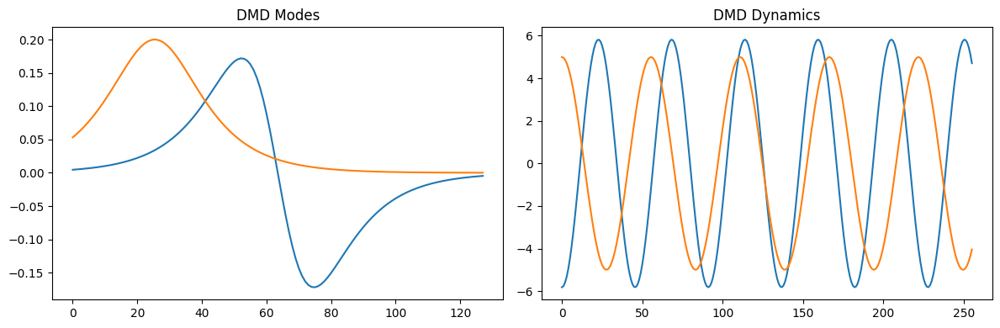

[[ 0.23885411+0.j          0.23740472+0.02635594j  0.23307355+0.05239655j
  ... -0.21935838-0.0946075j  -0.20755608-0.11822059j
  -0.19323704-0.14039492j]
 [ 0.25754297+0.j          0.25598047+0.02841572j  0.25131132+0.05649155j
  ... -0.23652003-0.10201446j -0.2237949 -0.12747274j
  -0.20835664-0.15137996j]
 [ 0.27753608+0.j          0.27585267+0.0306186j   0.2708222 +0.06087107j
  ... -0.25487888-0.10993956j -0.24116666-0.13737116j
  -0.22453141-0.16313162j]
 ...
 [ 0.03232809+0.j          0.03202325+0.00442741j  0.03111449+0.00877121j
  ... -0.03032774-0.01119258j -0.02850972-0.01524095j
  -0.02615398-0.01900198j]
 [ 0.029881  +0.j          0.02959924+0.00409228j  0.02875926+0.00810727j
  ... -0.02803207-0.01034536j -0.02635167-0.01408728j
  -0.02417424-0.01756361j]
 [ 0.02761904+0.j          0.02735861+0.00378249j  0.02658222+0.00749356j
  ... -0.02591007-0.00956222j -0.02435687-0.01302088j
  -0.02234427-0.01623407j]]


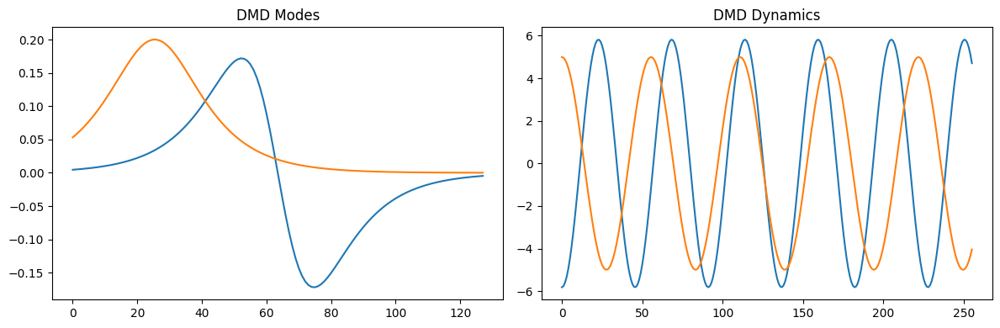

[[ 0.23885411+0.j          0.23740472+0.02635594j  0.23307355+0.05239655j
  ... -0.21935838-0.0946075j  -0.20755608-0.11822059j
  -0.19323704-0.14039492j]
 [ 0.25754297+0.j          0.25598047+0.02841572j  0.25131132+0.05649155j
  ... -0.23652003-0.10201446j -0.2237949 -0.12747274j
  -0.20835664-0.15137996j]
 [ 0.27753608+0.j          0.27585267+0.0306186j   0.2708222 +0.06087107j
  ... -0.25487888-0.10993956j -0.24116666-0.13737116j
  -0.22453141-0.16313162j]
 ...
 [ 0.03232809+0.j          0.03202325+0.00442741j  0.03111449+0.00877121j
  ... -0.03032774-0.01119258j -0.02850972-0.01524095j
  -0.02615398-0.01900198j]
 [ 0.029881  +0.j          0.02959924+0.00409228j  0.02875926+0.00810727j
  ... -0.02803207-0.01034536j -0.02635167-0.01408728j
  -0.02417424-0.01756361j]
 [ 0.02761904+0.j          0.02735861+0.00378249j  0.02658222+0.00749356j
  ... -0.02591007-0.00956222j -0.02435687-0.01302088j
  -0.02234427-0.01623407j]]


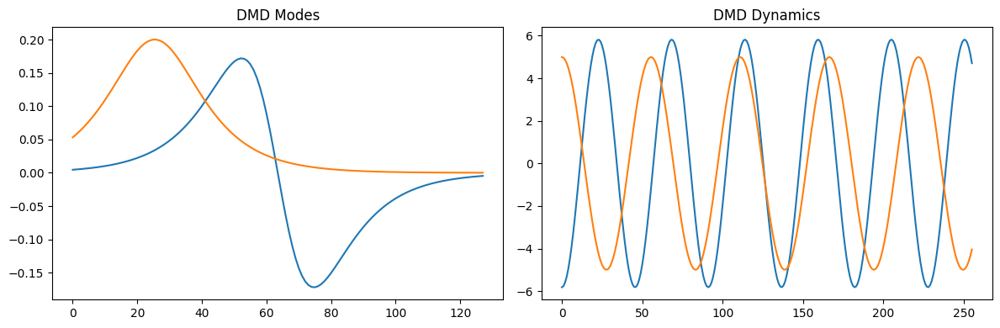

[[ 0.23885411+0.j          0.23740472+0.02635594j  0.23307355+0.05239655j
  ... -0.21935838-0.0946075j  -0.20755608-0.11822059j
  -0.19323704-0.14039492j]
 [ 0.25754297+0.j          0.25598047+0.02841572j  0.25131132+0.05649155j
  ... -0.23652003-0.10201446j -0.2237949 -0.12747274j
  -0.20835664-0.15137996j]
 [ 0.27753608+0.j          0.27585267+0.0306186j   0.2708222 +0.06087107j
  ... -0.25487888-0.10993956j -0.24116666-0.13737116j
  -0.22453141-0.16313162j]
 ...
 [ 0.03232809+0.j          0.03202325+0.00442741j  0.03111449+0.00877121j
  ... -0.03032774-0.01119258j -0.02850972-0.01524095j
  -0.02615398-0.01900198j]
 [ 0.029881  +0.j          0.02959924+0.00409228j  0.02875926+0.00810727j
  ... -0.02803207-0.01034536j -0.02635167-0.01408728j
  -0.02417424-0.01756361j]
 [ 0.02761904+0.j          0.02735861+0.00378249j  0.02658222+0.00749356j
  ... -0.02591007-0.00956222j -0.02435687-0.01302088j
  -0.02234427-0.01623407j]]


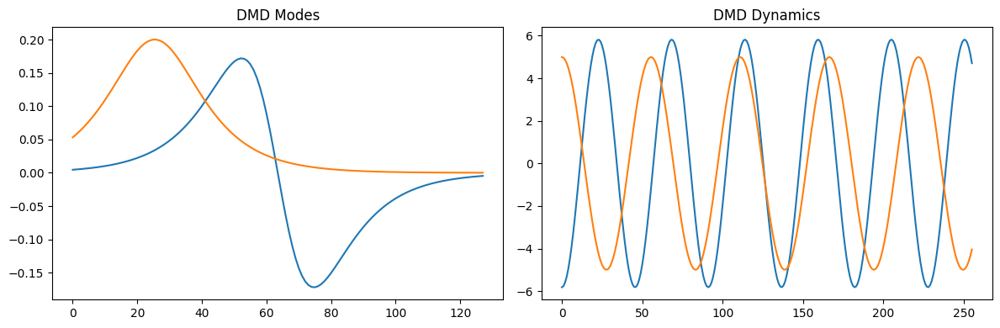

[[ 0.23885411+0.j          0.23740472+0.02635594j  0.23307355+0.05239655j
  ... -0.21935838-0.0946075j  -0.20755608-0.11822059j
  -0.19323704-0.14039492j]
 [ 0.25754297+0.j          0.25598047+0.02841572j  0.25131132+0.05649155j
  ... -0.23652003-0.10201446j -0.2237949 -0.12747274j
  -0.20835664-0.15137996j]
 [ 0.27753608+0.j          0.27585267+0.0306186j   0.2708222 +0.06087107j
  ... -0.25487888-0.10993956j -0.24116666-0.13737116j
  -0.22453141-0.16313162j]
 ...
 [ 0.03232809+0.j          0.03202325+0.00442741j  0.03111449+0.00877121j
  ... -0.03032774-0.01119258j -0.02850972-0.01524095j
  -0.02615398-0.01900198j]
 [ 0.029881  +0.j          0.02959924+0.00409228j  0.02875926+0.00810727j
  ... -0.02803207-0.01034536j -0.02635167-0.01408728j
  -0.02417424-0.01756361j]
 [ 0.02761904+0.j          0.02735861+0.00378249j  0.02658222+0.00749356j
  ... -0.02591007-0.00956222j -0.02435687-0.01302088j
  -0.02234427-0.01623407j]]


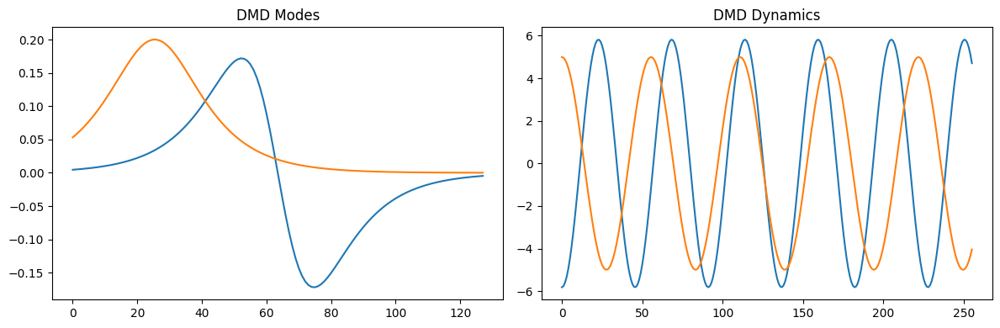

[[ 0.23885411+0.j          0.23740472+0.02635594j  0.23307355+0.05239655j
  ... -0.21935838-0.0946075j  -0.20755608-0.11822059j
  -0.19323704-0.14039492j]
 [ 0.25754297+0.j          0.25598047+0.02841572j  0.25131132+0.05649155j
  ... -0.23652003-0.10201446j -0.2237949 -0.12747274j
  -0.20835664-0.15137996j]
 [ 0.27753608+0.j          0.27585267+0.0306186j   0.2708222 +0.06087107j
  ... -0.25487888-0.10993956j -0.24116666-0.13737116j
  -0.22453141-0.16313162j]
 ...
 [ 0.03232809+0.j          0.03202325+0.00442741j  0.03111449+0.00877121j
  ... -0.03032774-0.01119258j -0.02850972-0.01524095j
  -0.02615398-0.01900198j]
 [ 0.029881  +0.j          0.02959924+0.00409228j  0.02875926+0.00810727j
  ... -0.02803207-0.01034536j -0.02635167-0.01408728j
  -0.02417424-0.01756361j]
 [ 0.02761904+0.j          0.02735861+0.00378249j  0.02658222+0.00749356j
  ... -0.02591007-0.00956222j -0.02435687-0.01302088j
  -0.02234427-0.01623407j]]


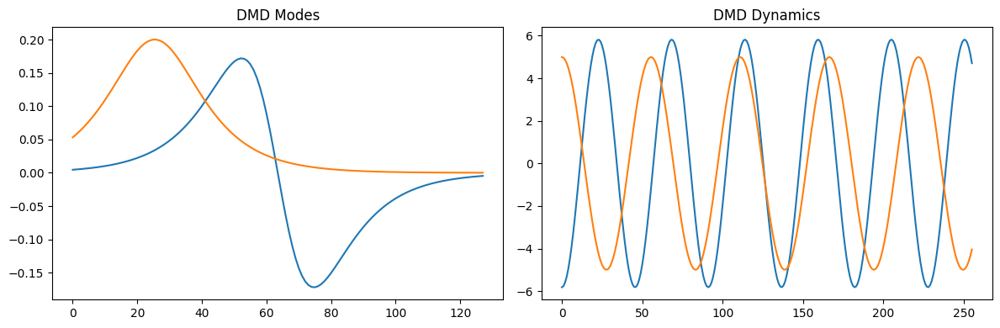

[[ 0.23885411+0.j          0.23740472+0.02635594j  0.23307355+0.05239655j
  ... -0.21935838-0.0946075j  -0.20755608-0.11822059j
  -0.19323704-0.14039492j]
 [ 0.25754297+0.j          0.25598047+0.02841572j  0.25131132+0.05649155j
  ... -0.23652003-0.10201446j -0.2237949 -0.12747274j
  -0.20835664-0.15137996j]
 [ 0.27753608+0.j          0.27585267+0.0306186j   0.2708222 +0.06087107j
  ... -0.25487888-0.10993956j -0.24116666-0.13737116j
  -0.22453141-0.16313162j]
 ...
 [ 0.03232809+0.j          0.03202325+0.00442741j  0.03111449+0.00877121j
  ... -0.03032774-0.01119258j -0.02850972-0.01524095j
  -0.02615398-0.01900198j]
 [ 0.029881  +0.j          0.02959924+0.00409228j  0.02875926+0.00810727j
  ... -0.02803207-0.01034536j -0.02635167-0.01408728j
  -0.02417424-0.01756361j]
 [ 0.02761904+0.j          0.02735861+0.00378249j  0.02658222+0.00749356j
  ... -0.02591007-0.00956222j -0.02435687-0.01302088j
  -0.02234427-0.01623407j]]


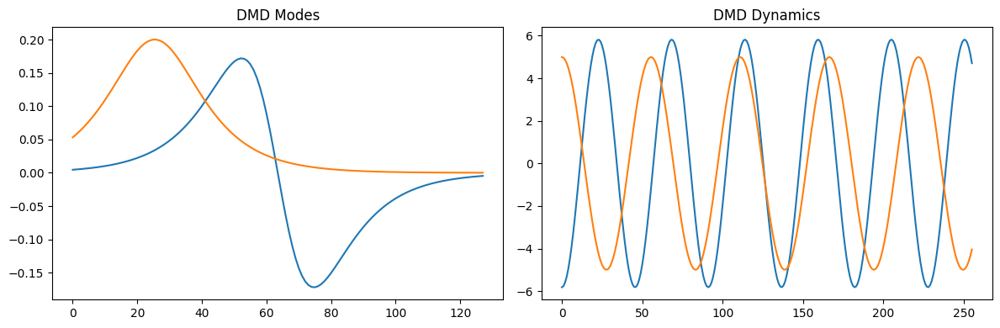

[[ 0.23885411+0.j          0.23740472+0.02635594j  0.23307355+0.05239655j
  ... -0.21935838-0.0946075j  -0.20755608-0.11822059j
  -0.19323704-0.14039492j]
 [ 0.25754297+0.j          0.25598047+0.02841572j  0.25131132+0.05649155j
  ... -0.23652003-0.10201446j -0.2237949 -0.12747274j
  -0.20835664-0.15137996j]
 [ 0.27753608+0.j          0.27585267+0.0306186j   0.2708222 +0.06087107j
  ... -0.25487888-0.10993956j -0.24116666-0.13737116j
  -0.22453141-0.16313162j]
 ...
 [ 0.03232809+0.j          0.03202325+0.00442741j  0.03111449+0.00877121j
  ... -0.03032774-0.01119258j -0.02850972-0.01524095j
  -0.02615398-0.01900198j]
 [ 0.029881  +0.j          0.02959924+0.00409228j  0.02875926+0.00810727j
  ... -0.02803207-0.01034536j -0.02635167-0.01408728j
  -0.02417424-0.01756361j]
 [ 0.02761904+0.j          0.02735861+0.00378249j  0.02658222+0.00749356j
  ... -0.02591007-0.00956222j -0.02435687-0.01302088j
  -0.02234427-0.01623407j]]


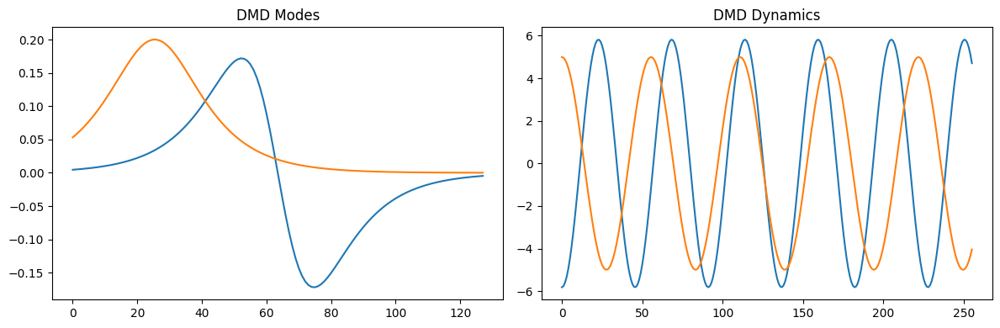

[[ 0.23885411+0.j          0.23740472+0.02635594j  0.23307355+0.05239655j
  ... -0.21935838-0.0946075j  -0.20755608-0.11822059j
  -0.19323704-0.14039492j]
 [ 0.25754297+0.j          0.25598047+0.02841572j  0.25131132+0.05649155j
  ... -0.23652003-0.10201446j -0.2237949 -0.12747274j
  -0.20835664-0.15137996j]
 [ 0.27753608+0.j          0.27585267+0.0306186j   0.2708222 +0.06087107j
  ... -0.25487888-0.10993956j -0.24116666-0.13737116j
  -0.22453141-0.16313162j]
 ...
 [ 0.03232809+0.j          0.03202325+0.00442741j  0.03111449+0.00877121j
  ... -0.03032774-0.01119258j -0.02850972-0.01524095j
  -0.02615398-0.01900198j]
 [ 0.029881  +0.j          0.02959924+0.00409228j  0.02875926+0.00810727j
  ... -0.02803207-0.01034536j -0.02635167-0.01408728j
  -0.02417424-0.01756361j]
 [ 0.02761904+0.j          0.02735861+0.00378249j  0.02658222+0.00749356j
  ... -0.02591007-0.00956222j -0.02435687-0.01302088j
  -0.02234427-0.01623407j]]


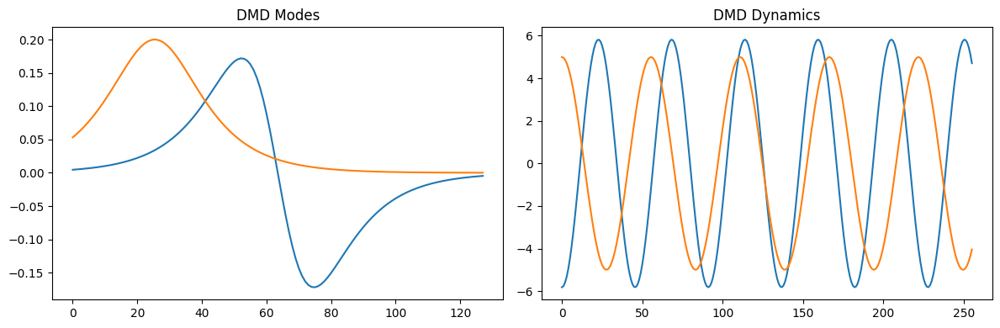

[[ 0.23885411+0.j          0.23740472+0.02635594j  0.23307355+0.05239655j
  ... -0.21935838-0.0946075j  -0.20755608-0.11822059j
  -0.19323704-0.14039492j]
 [ 0.25754297+0.j          0.25598047+0.02841572j  0.25131132+0.05649155j
  ... -0.23652003-0.10201446j -0.2237949 -0.12747274j
  -0.20835664-0.15137996j]
 [ 0.27753608+0.j          0.27585267+0.0306186j   0.2708222 +0.06087107j
  ... -0.25487888-0.10993956j -0.24116666-0.13737116j
  -0.22453141-0.16313162j]
 ...
 [ 0.03232809+0.j          0.03202325+0.00442741j  0.03111449+0.00877121j
  ... -0.03032774-0.01119258j -0.02850972-0.01524095j
  -0.02615398-0.01900198j]
 [ 0.029881  +0.j          0.02959924+0.00409228j  0.02875926+0.00810727j
  ... -0.02803207-0.01034536j -0.02635167-0.01408728j
  -0.02417424-0.01756361j]
 [ 0.02761904+0.j          0.02735861+0.00378249j  0.02658222+0.00749356j
  ... -0.02591007-0.00956222j -0.02435687-0.01302088j
  -0.02234427-0.01623407j]]


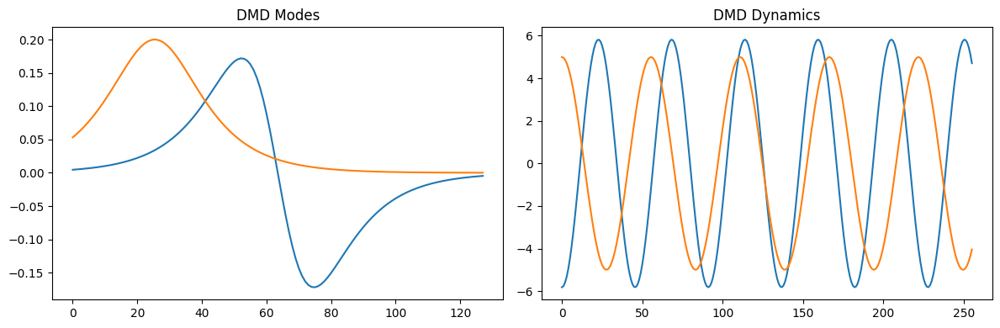

[[ 0.23885411+0.j          0.23740472+0.02635594j  0.23307355+0.05239655j
  ... -0.21935838-0.0946075j  -0.20755608-0.11822059j
  -0.19323704-0.14039492j]
 [ 0.25754297+0.j          0.25598047+0.02841572j  0.25131132+0.05649155j
  ... -0.23652003-0.10201446j -0.2237949 -0.12747274j
  -0.20835664-0.15137996j]
 [ 0.27753608+0.j          0.27585267+0.0306186j   0.2708222 +0.06087107j
  ... -0.25487888-0.10993956j -0.24116666-0.13737116j
  -0.22453141-0.16313162j]
 ...
 [ 0.03232809+0.j          0.03202325+0.00442741j  0.03111449+0.00877121j
  ... -0.03032774-0.01119258j -0.02850972-0.01524095j
  -0.02615398-0.01900198j]
 [ 0.029881  +0.j          0.02959924+0.00409228j  0.02875926+0.00810727j
  ... -0.02803207-0.01034536j -0.02635167-0.01408728j
  -0.02417424-0.01756361j]
 [ 0.02761904+0.j          0.02735861+0.00378249j  0.02658222+0.00749356j
  ... -0.02591007-0.00956222j -0.02435687-0.01302088j
  -0.02234427-0.01623407j]]


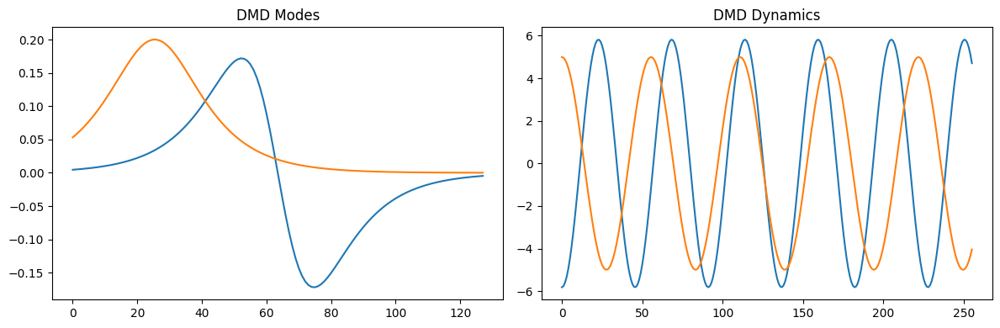

[[ 0.23885411+0.j          0.23740472+0.02635594j  0.23307355+0.05239655j
  ... -0.21935838-0.0946075j  -0.20755608-0.11822059j
  -0.19323704-0.14039492j]
 [ 0.25754297+0.j          0.25598047+0.02841572j  0.25131132+0.05649155j
  ... -0.23652003-0.10201446j -0.2237949 -0.12747274j
  -0.20835664-0.15137996j]
 [ 0.27753608+0.j          0.27585267+0.0306186j   0.2708222 +0.06087107j
  ... -0.25487888-0.10993956j -0.24116666-0.13737116j
  -0.22453141-0.16313162j]
 ...
 [ 0.03232809+0.j          0.03202325+0.00442741j  0.03111449+0.00877121j
  ... -0.03032774-0.01119258j -0.02850972-0.01524095j
  -0.02615398-0.01900198j]
 [ 0.029881  +0.j          0.02959924+0.00409228j  0.02875926+0.00810727j
  ... -0.02803207-0.01034536j -0.02635167-0.01408728j
  -0.02417424-0.01756361j]
 [ 0.02761904+0.j          0.02735861+0.00378249j  0.02658222+0.00749356j
  ... -0.02591007-0.00956222j -0.02435687-0.01302088j
  -0.02234427-0.01623407j]]


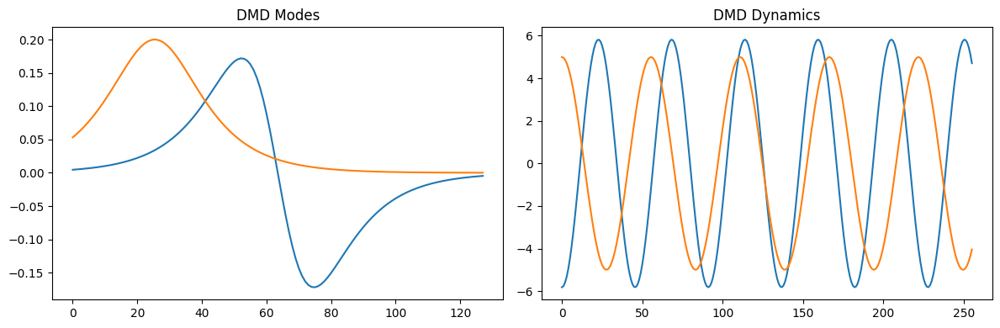

[[ 0.23885411+0.j          0.23740472+0.02635594j  0.23307355+0.05239655j
  ... -0.21935838-0.0946075j  -0.20755608-0.11822059j
  -0.19323704-0.14039492j]
 [ 0.25754297+0.j          0.25598047+0.02841572j  0.25131132+0.05649155j
  ... -0.23652003-0.10201446j -0.2237949 -0.12747274j
  -0.20835664-0.15137996j]
 [ 0.27753608+0.j          0.27585267+0.0306186j   0.2708222 +0.06087107j
  ... -0.25487888-0.10993956j -0.24116666-0.13737116j
  -0.22453141-0.16313162j]
 ...
 [ 0.03232809+0.j          0.03202325+0.00442741j  0.03111449+0.00877121j
  ... -0.03032774-0.01119258j -0.02850972-0.01524095j
  -0.02615398-0.01900198j]
 [ 0.029881  +0.j          0.02959924+0.00409228j  0.02875926+0.00810727j
  ... -0.02803207-0.01034536j -0.02635167-0.01408728j
  -0.02417424-0.01756361j]
 [ 0.02761904+0.j          0.02735861+0.00378249j  0.02658222+0.00749356j
  ... -0.02591007-0.00956222j -0.02435687-0.01302088j
  -0.02234427-0.01623407j]]


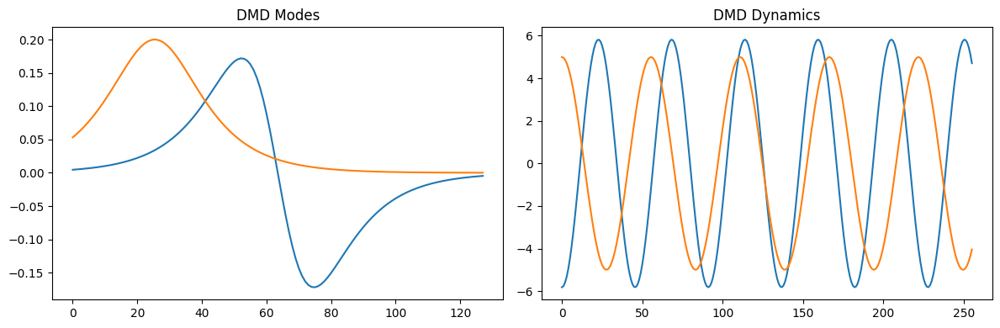

[[ 0.23885411+0.j          0.23740472+0.02635594j  0.23307355+0.05239655j
  ... -0.21935838-0.0946075j  -0.20755608-0.11822059j
  -0.19323704-0.14039492j]
 [ 0.25754297+0.j          0.25598047+0.02841572j  0.25131132+0.05649155j
  ... -0.23652003-0.10201446j -0.2237949 -0.12747274j
  -0.20835664-0.15137996j]
 [ 0.27753608+0.j          0.27585267+0.0306186j   0.2708222 +0.06087107j
  ... -0.25487888-0.10993956j -0.24116666-0.13737116j
  -0.22453141-0.16313162j]
 ...
 [ 0.03232809+0.j          0.03202325+0.00442741j  0.03111449+0.00877121j
  ... -0.03032774-0.01119258j -0.02850972-0.01524095j
  -0.02615398-0.01900198j]
 [ 0.029881  +0.j          0.02959924+0.00409228j  0.02875926+0.00810727j
  ... -0.02803207-0.01034536j -0.02635167-0.01408728j
  -0.02417424-0.01756361j]
 [ 0.02761904+0.j          0.02735861+0.00378249j  0.02658222+0.00749356j
  ... -0.02591007-0.00956222j -0.02435687-0.01302088j
  -0.02234427-0.01623407j]]


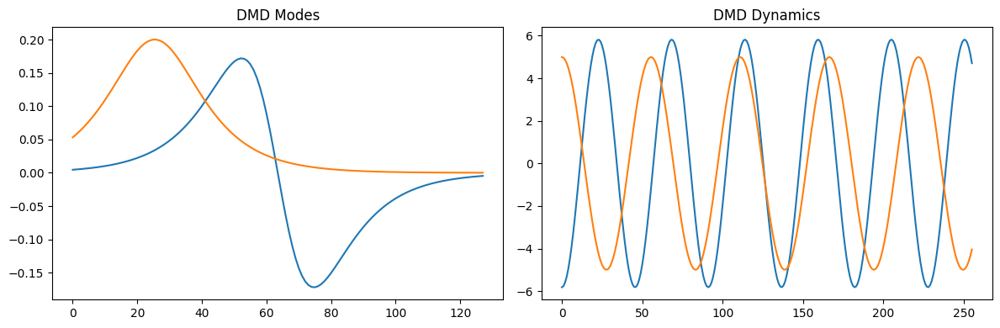

[[ 0.23885411+0.j          0.23740472+0.02635594j  0.23307355+0.05239655j
  ... -0.21935838-0.0946075j  -0.20755608-0.11822059j
  -0.19323704-0.14039492j]
 [ 0.25754297+0.j          0.25598047+0.02841572j  0.25131132+0.05649155j
  ... -0.23652003-0.10201446j -0.2237949 -0.12747274j
  -0.20835664-0.15137996j]
 [ 0.27753608+0.j          0.27585267+0.0306186j   0.2708222 +0.06087107j
  ... -0.25487888-0.10993956j -0.24116666-0.13737116j
  -0.22453141-0.16313162j]
 ...
 [ 0.03232809+0.j          0.03202325+0.00442741j  0.03111449+0.00877121j
  ... -0.03032774-0.01119258j -0.02850972-0.01524095j
  -0.02615398-0.01900198j]
 [ 0.029881  +0.j          0.02959924+0.00409228j  0.02875926+0.00810727j
  ... -0.02803207-0.01034536j -0.02635167-0.01408728j
  -0.02417424-0.01756361j]
 [ 0.02761904+0.j          0.02735861+0.00378249j  0.02658222+0.00749356j
  ... -0.02591007-0.00956222j -0.02435687-0.01302088j
  -0.02234427-0.01623407j]]


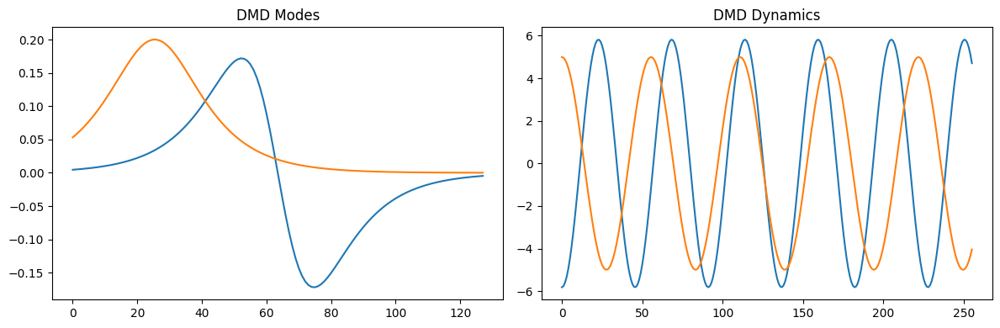

[[ 0.23885411+0.j          0.23740472+0.02635594j  0.23307355+0.05239655j
  ... -0.21935838-0.0946075j  -0.20755608-0.11822059j
  -0.19323704-0.14039492j]
 [ 0.25754297+0.j          0.25598047+0.02841572j  0.25131132+0.05649155j
  ... -0.23652003-0.10201446j -0.2237949 -0.12747274j
  -0.20835664-0.15137996j]
 [ 0.27753608+0.j          0.27585267+0.0306186j   0.2708222 +0.06087107j
  ... -0.25487888-0.10993956j -0.24116666-0.13737116j
  -0.22453141-0.16313162j]
 ...
 [ 0.03232809+0.j          0.03202325+0.00442741j  0.03111449+0.00877121j
  ... -0.03032774-0.01119258j -0.02850972-0.01524095j
  -0.02615398-0.01900198j]
 [ 0.029881  +0.j          0.02959924+0.00409228j  0.02875926+0.00810727j
  ... -0.02803207-0.01034536j -0.02635167-0.01408728j
  -0.02417424-0.01756361j]
 [ 0.02761904+0.j          0.02735861+0.00378249j  0.02658222+0.00749356j
  ... -0.02591007-0.00956222j -0.02435687-0.01302088j
  -0.02234427-0.01623407j]]


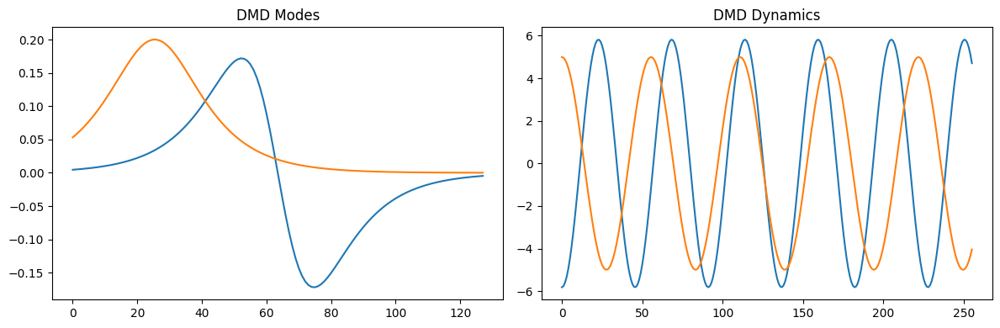

[[ 0.23885411+0.j          0.23740472+0.02635594j  0.23307355+0.05239655j
  ... -0.21935838-0.0946075j  -0.20755608-0.11822059j
  -0.19323704-0.14039492j]
 [ 0.25754297+0.j          0.25598047+0.02841572j  0.25131132+0.05649155j
  ... -0.23652003-0.10201446j -0.2237949 -0.12747274j
  -0.20835664-0.15137996j]
 [ 0.27753608+0.j          0.27585267+0.0306186j   0.2708222 +0.06087107j
  ... -0.25487888-0.10993956j -0.24116666-0.13737116j
  -0.22453141-0.16313162j]
 ...
 [ 0.03232809+0.j          0.03202325+0.00442741j  0.03111449+0.00877121j
  ... -0.03032774-0.01119258j -0.02850972-0.01524095j
  -0.02615398-0.01900198j]
 [ 0.029881  +0.j          0.02959924+0.00409228j  0.02875926+0.00810727j
  ... -0.02803207-0.01034536j -0.02635167-0.01408728j
  -0.02417424-0.01756361j]
 [ 0.02761904+0.j          0.02735861+0.00378249j  0.02658222+0.00749356j
  ... -0.02591007-0.00956222j -0.02435687-0.01302088j
  -0.02234427-0.01623407j]]


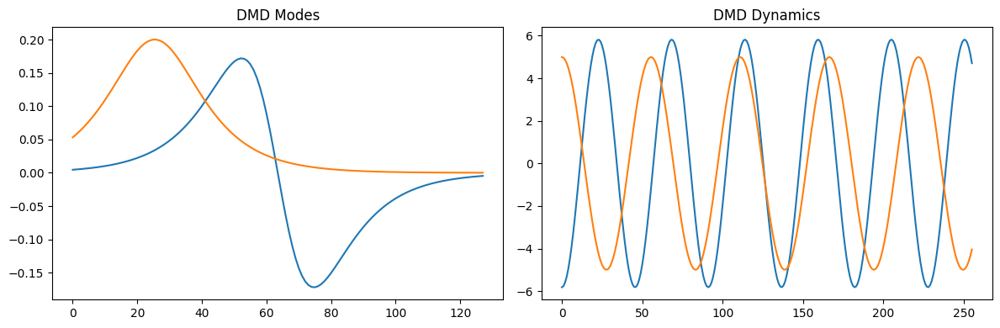

[[ 0.23885411+0.j          0.23740472+0.02635594j  0.23307355+0.05239655j
  ... -0.21935838-0.0946075j  -0.20755608-0.11822059j
  -0.19323704-0.14039492j]
 [ 0.25754297+0.j          0.25598047+0.02841572j  0.25131132+0.05649155j
  ... -0.23652003-0.10201446j -0.2237949 -0.12747274j
  -0.20835664-0.15137996j]
 [ 0.27753608+0.j          0.27585267+0.0306186j   0.2708222 +0.06087107j
  ... -0.25487888-0.10993956j -0.24116666-0.13737116j
  -0.22453141-0.16313162j]
 ...
 [ 0.03232809+0.j          0.03202325+0.00442741j  0.03111449+0.00877121j
  ... -0.03032774-0.01119258j -0.02850972-0.01524095j
  -0.02615398-0.01900198j]
 [ 0.029881  +0.j          0.02959924+0.00409228j  0.02875926+0.00810727j
  ... -0.02803207-0.01034536j -0.02635167-0.01408728j
  -0.02417424-0.01756361j]
 [ 0.02761904+0.j          0.02735861+0.00378249j  0.02658222+0.00749356j
  ... -0.02591007-0.00956222j -0.02435687-0.01302088j
  -0.02234427-0.01623407j]]


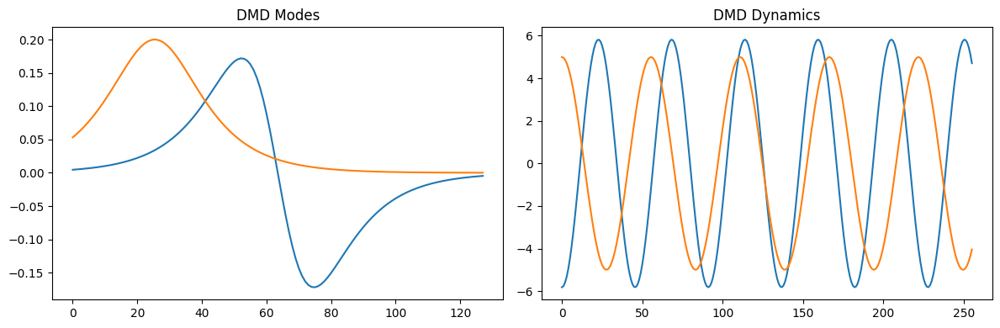

[[ 0.23885411+0.j          0.23740472+0.02635594j  0.23307355+0.05239655j
  ... -0.21935838-0.0946075j  -0.20755608-0.11822059j
  -0.19323704-0.14039492j]
 [ 0.25754297+0.j          0.25598047+0.02841572j  0.25131132+0.05649155j
  ... -0.23652003-0.10201446j -0.2237949 -0.12747274j
  -0.20835664-0.15137996j]
 [ 0.27753608+0.j          0.27585267+0.0306186j   0.2708222 +0.06087107j
  ... -0.25487888-0.10993956j -0.24116666-0.13737116j
  -0.22453141-0.16313162j]
 ...
 [ 0.03232809+0.j          0.03202325+0.00442741j  0.03111449+0.00877121j
  ... -0.03032774-0.01119258j -0.02850972-0.01524095j
  -0.02615398-0.01900198j]
 [ 0.029881  +0.j          0.02959924+0.00409228j  0.02875926+0.00810727j
  ... -0.02803207-0.01034536j -0.02635167-0.01408728j
  -0.02417424-0.01756361j]
 [ 0.02761904+0.j          0.02735861+0.00378249j  0.02658222+0.00749356j
  ... -0.02591007-0.00956222j -0.02435687-0.01302088j
  -0.02234427-0.01623407j]]


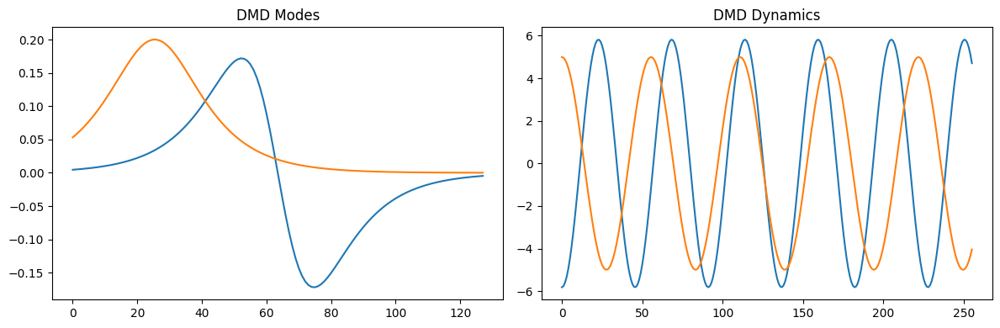

[[ 0.23885411+0.j          0.23740472+0.02635594j  0.23307355+0.05239655j
  ... -0.21935838-0.0946075j  -0.20755608-0.11822059j
  -0.19323704-0.14039492j]
 [ 0.25754297+0.j          0.25598047+0.02841572j  0.25131132+0.05649155j
  ... -0.23652003-0.10201446j -0.2237949 -0.12747274j
  -0.20835664-0.15137996j]
 [ 0.27753608+0.j          0.27585267+0.0306186j   0.2708222 +0.06087107j
  ... -0.25487888-0.10993956j -0.24116666-0.13737116j
  -0.22453141-0.16313162j]
 ...
 [ 0.03232809+0.j          0.03202325+0.00442741j  0.03111449+0.00877121j
  ... -0.03032774-0.01119258j -0.02850972-0.01524095j
  -0.02615398-0.01900198j]
 [ 0.029881  +0.j          0.02959924+0.00409228j  0.02875926+0.00810727j
  ... -0.02803207-0.01034536j -0.02635167-0.01408728j
  -0.02417424-0.01756361j]
 [ 0.02761904+0.j          0.02735861+0.00378249j  0.02658222+0.00749356j
  ... -0.02591007-0.00956222j -0.02435687-0.01302088j
  -0.02234427-0.01623407j]]


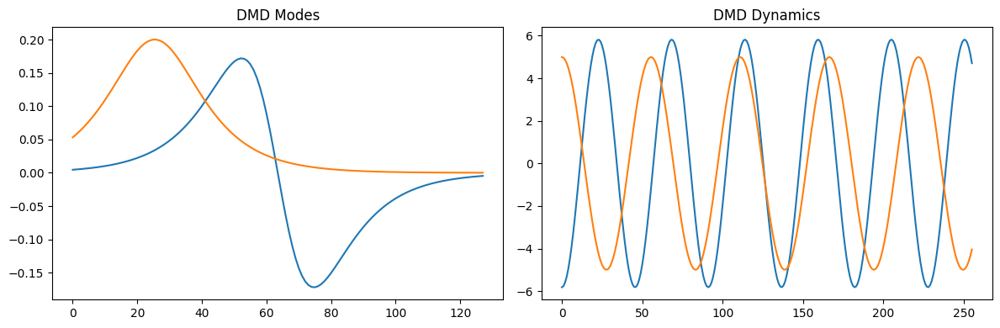

[[ 0.23885411+0.j          0.23740472+0.02635594j  0.23307355+0.05239655j
  ... -0.21935838-0.0946075j  -0.20755608-0.11822059j
  -0.19323704-0.14039492j]
 [ 0.25754297+0.j          0.25598047+0.02841572j  0.25131132+0.05649155j
  ... -0.23652003-0.10201446j -0.2237949 -0.12747274j
  -0.20835664-0.15137996j]
 [ 0.27753608+0.j          0.27585267+0.0306186j   0.2708222 +0.06087107j
  ... -0.25487888-0.10993956j -0.24116666-0.13737116j
  -0.22453141-0.16313162j]
 ...
 [ 0.03232809+0.j          0.03202325+0.00442741j  0.03111449+0.00877121j
  ... -0.03032774-0.01119258j -0.02850972-0.01524095j
  -0.02615398-0.01900198j]
 [ 0.029881  +0.j          0.02959924+0.00409228j  0.02875926+0.00810727j
  ... -0.02803207-0.01034536j -0.02635167-0.01408728j
  -0.02417424-0.01756361j]
 [ 0.02761904+0.j          0.02735861+0.00378249j  0.02658222+0.00749356j
  ... -0.02591007-0.00956222j -0.02435687-0.01302088j
  -0.02234427-0.01623407j]]


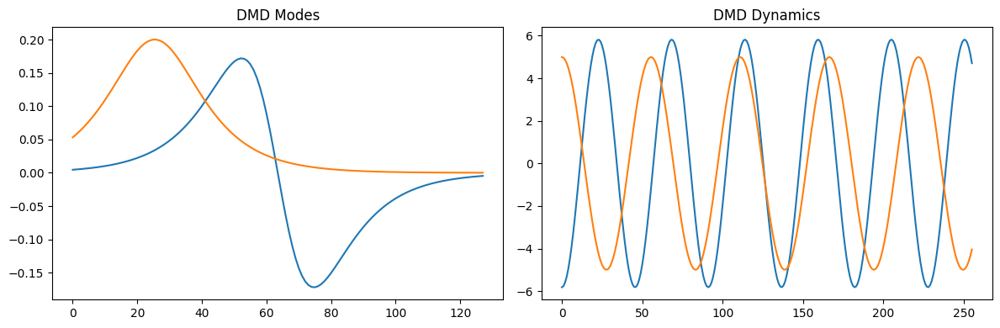

[[ 0.23885411+0.j          0.23740472+0.02635594j  0.23307355+0.05239655j
  ... -0.21935838-0.0946075j  -0.20755608-0.11822059j
  -0.19323704-0.14039492j]
 [ 0.25754297+0.j          0.25598047+0.02841572j  0.25131132+0.05649155j
  ... -0.23652003-0.10201446j -0.2237949 -0.12747274j
  -0.20835664-0.15137996j]
 [ 0.27753608+0.j          0.27585267+0.0306186j   0.2708222 +0.06087107j
  ... -0.25487888-0.10993956j -0.24116666-0.13737116j
  -0.22453141-0.16313162j]
 ...
 [ 0.03232809+0.j          0.03202325+0.00442741j  0.03111449+0.00877121j
  ... -0.03032774-0.01119258j -0.02850972-0.01524095j
  -0.02615398-0.01900198j]
 [ 0.029881  +0.j          0.02959924+0.00409228j  0.02875926+0.00810727j
  ... -0.02803207-0.01034536j -0.02635167-0.01408728j
  -0.02417424-0.01756361j]
 [ 0.02761904+0.j          0.02735861+0.00378249j  0.02658222+0.00749356j
  ... -0.02591007-0.00956222j -0.02435687-0.01302088j
  -0.02234427-0.01623407j]]


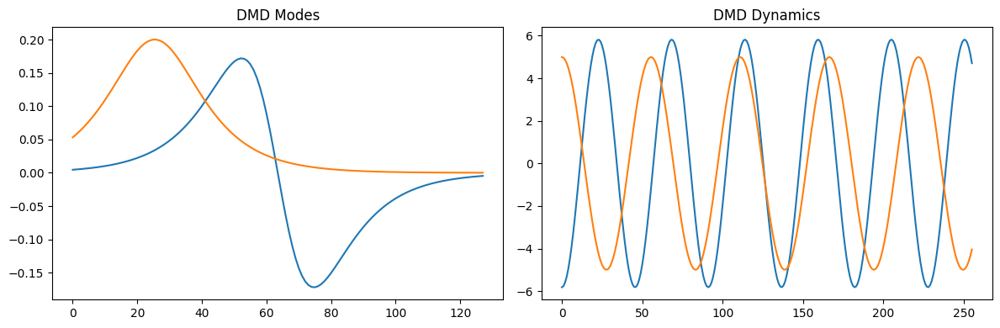

[[ 0.23885411+0.j          0.23740472+0.02635594j  0.23307355+0.05239655j
  ... -0.21935838-0.0946075j  -0.20755608-0.11822059j
  -0.19323704-0.14039492j]
 [ 0.25754297+0.j          0.25598047+0.02841572j  0.25131132+0.05649155j
  ... -0.23652003-0.10201446j -0.2237949 -0.12747274j
  -0.20835664-0.15137996j]
 [ 0.27753608+0.j          0.27585267+0.0306186j   0.2708222 +0.06087107j
  ... -0.25487888-0.10993956j -0.24116666-0.13737116j
  -0.22453141-0.16313162j]
 ...
 [ 0.03232809+0.j          0.03202325+0.00442741j  0.03111449+0.00877121j
  ... -0.03032774-0.01119258j -0.02850972-0.01524095j
  -0.02615398-0.01900198j]
 [ 0.029881  +0.j          0.02959924+0.00409228j  0.02875926+0.00810727j
  ... -0.02803207-0.01034536j -0.02635167-0.01408728j
  -0.02417424-0.01756361j]
 [ 0.02761904+0.j          0.02735861+0.00378249j  0.02658222+0.00749356j
  ... -0.02591007-0.00956222j -0.02435687-0.01302088j
  -0.02234427-0.01623407j]]


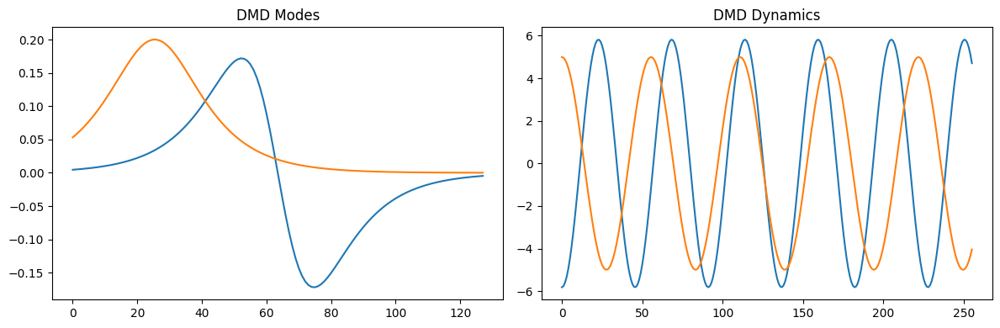

[[ 0.23885411+0.j          0.23740472+0.02635594j  0.23307355+0.05239655j
  ... -0.21935838-0.0946075j  -0.20755608-0.11822059j
  -0.19323704-0.14039492j]
 [ 0.25754297+0.j          0.25598047+0.02841572j  0.25131132+0.05649155j
  ... -0.23652003-0.10201446j -0.2237949 -0.12747274j
  -0.20835664-0.15137996j]
 [ 0.27753608+0.j          0.27585267+0.0306186j   0.2708222 +0.06087107j
  ... -0.25487888-0.10993956j -0.24116666-0.13737116j
  -0.22453141-0.16313162j]
 ...
 [ 0.03232809+0.j          0.03202325+0.00442741j  0.03111449+0.00877121j
  ... -0.03032774-0.01119258j -0.02850972-0.01524095j
  -0.02615398-0.01900198j]
 [ 0.029881  +0.j          0.02959924+0.00409228j  0.02875926+0.00810727j
  ... -0.02803207-0.01034536j -0.02635167-0.01408728j
  -0.02417424-0.01756361j]
 [ 0.02761904+0.j          0.02735861+0.00378249j  0.02658222+0.00749356j
  ... -0.02591007-0.00956222j -0.02435687-0.01302088j
  -0.02234427-0.01623407j]]


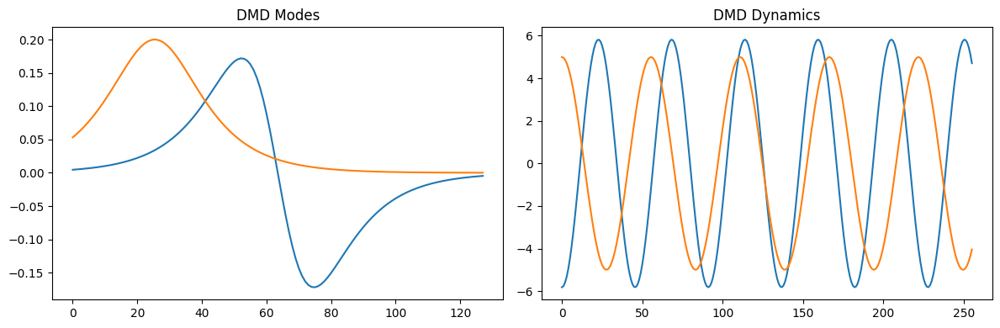

[[ 0.23885411+0.j          0.23740472+0.02635594j  0.23307355+0.05239655j
  ... -0.21935838-0.0946075j  -0.20755608-0.11822059j
  -0.19323704-0.14039492j]
 [ 0.25754297+0.j          0.25598047+0.02841572j  0.25131132+0.05649155j
  ... -0.23652003-0.10201446j -0.2237949 -0.12747274j
  -0.20835664-0.15137996j]
 [ 0.27753608+0.j          0.27585267+0.0306186j   0.2708222 +0.06087107j
  ... -0.25487888-0.10993956j -0.24116666-0.13737116j
  -0.22453141-0.16313162j]
 ...
 [ 0.03232809+0.j          0.03202325+0.00442741j  0.03111449+0.00877121j
  ... -0.03032774-0.01119258j -0.02850972-0.01524095j
  -0.02615398-0.01900198j]
 [ 0.029881  +0.j          0.02959924+0.00409228j  0.02875926+0.00810727j
  ... -0.02803207-0.01034536j -0.02635167-0.01408728j
  -0.02417424-0.01756361j]
 [ 0.02761904+0.j          0.02735861+0.00378249j  0.02658222+0.00749356j
  ... -0.02591007-0.00956222j -0.02435687-0.01302088j
  -0.02234427-0.01623407j]]


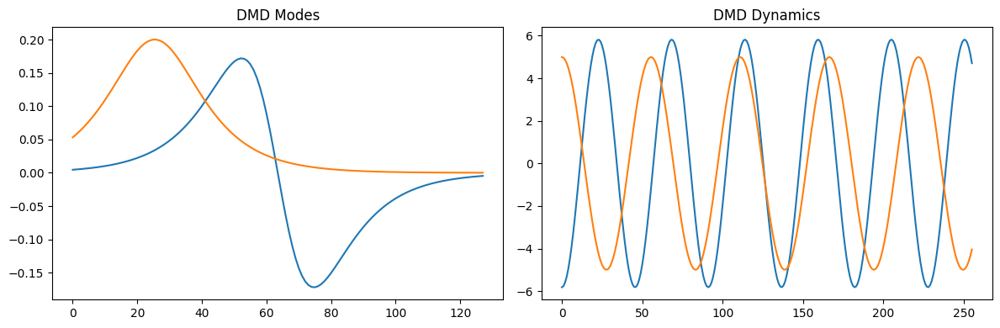

[[ 0.23885411+0.j          0.23740472+0.02635594j  0.23307355+0.05239655j
  ... -0.21935838-0.0946075j  -0.20755608-0.11822059j
  -0.19323704-0.14039492j]
 [ 0.25754297+0.j          0.25598047+0.02841572j  0.25131132+0.05649155j
  ... -0.23652003-0.10201446j -0.2237949 -0.12747274j
  -0.20835664-0.15137996j]
 [ 0.27753608+0.j          0.27585267+0.0306186j   0.2708222 +0.06087107j
  ... -0.25487888-0.10993956j -0.24116666-0.13737116j
  -0.22453141-0.16313162j]
 ...
 [ 0.03232809+0.j          0.03202325+0.00442741j  0.03111449+0.00877121j
  ... -0.03032774-0.01119258j -0.02850972-0.01524095j
  -0.02615398-0.01900198j]
 [ 0.029881  +0.j          0.02959924+0.00409228j  0.02875926+0.00810727j
  ... -0.02803207-0.01034536j -0.02635167-0.01408728j
  -0.02417424-0.01756361j]
 [ 0.02761904+0.j          0.02735861+0.00378249j  0.02658222+0.00749356j
  ... -0.02591007-0.00956222j -0.02435687-0.01302088j
  -0.02234427-0.01623407j]]


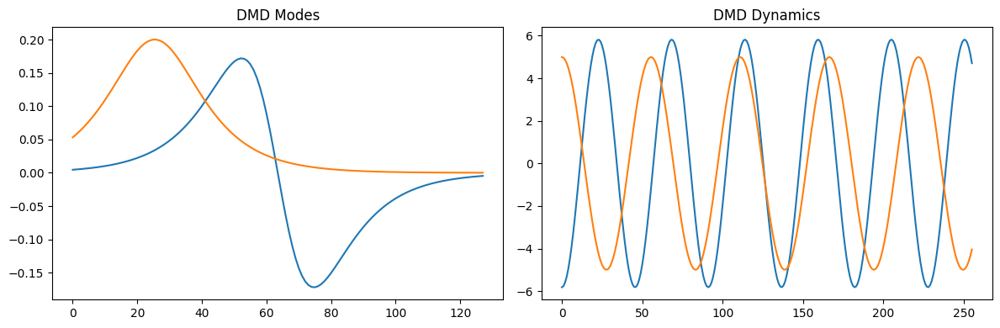

[[ 0.23885411+0.j          0.23740472+0.02635594j  0.23307355+0.05239655j
  ... -0.21935838-0.0946075j  -0.20755608-0.11822059j
  -0.19323704-0.14039492j]
 [ 0.25754297+0.j          0.25598047+0.02841572j  0.25131132+0.05649155j
  ... -0.23652003-0.10201446j -0.2237949 -0.12747274j
  -0.20835664-0.15137996j]
 [ 0.27753608+0.j          0.27585267+0.0306186j   0.2708222 +0.06087107j
  ... -0.25487888-0.10993956j -0.24116666-0.13737116j
  -0.22453141-0.16313162j]
 ...
 [ 0.03232809+0.j          0.03202325+0.00442741j  0.03111449+0.00877121j
  ... -0.03032774-0.01119258j -0.02850972-0.01524095j
  -0.02615398-0.01900198j]
 [ 0.029881  +0.j          0.02959924+0.00409228j  0.02875926+0.00810727j
  ... -0.02803207-0.01034536j -0.02635167-0.01408728j
  -0.02417424-0.01756361j]
 [ 0.02761904+0.j          0.02735861+0.00378249j  0.02658222+0.00749356j
  ... -0.02591007-0.00956222j -0.02435687-0.01302088j
  -0.02234427-0.01623407j]]


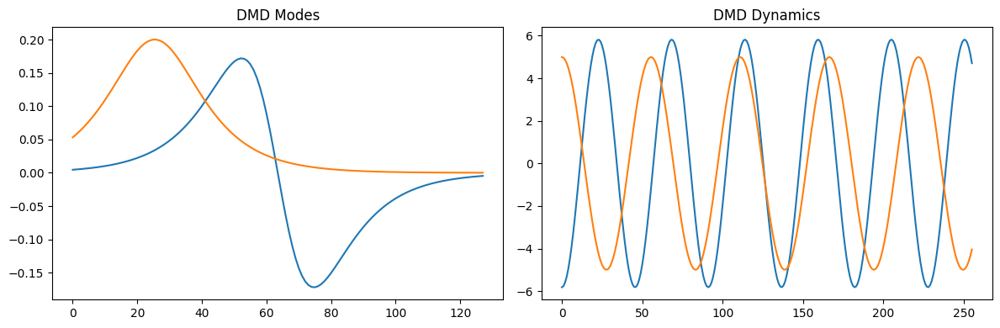

[[ 0.23885411+0.j          0.23740472+0.02635594j  0.23307355+0.05239655j
  ... -0.21935838-0.0946075j  -0.20755608-0.11822059j
  -0.19323704-0.14039492j]
 [ 0.25754297+0.j          0.25598047+0.02841572j  0.25131132+0.05649155j
  ... -0.23652003-0.10201446j -0.2237949 -0.12747274j
  -0.20835664-0.15137996j]
 [ 0.27753608+0.j          0.27585267+0.0306186j   0.2708222 +0.06087107j
  ... -0.25487888-0.10993956j -0.24116666-0.13737116j
  -0.22453141-0.16313162j]
 ...
 [ 0.03232809+0.j          0.03202325+0.00442741j  0.03111449+0.00877121j
  ... -0.03032774-0.01119258j -0.02850972-0.01524095j
  -0.02615398-0.01900198j]
 [ 0.029881  +0.j          0.02959924+0.00409228j  0.02875926+0.00810727j
  ... -0.02803207-0.01034536j -0.02635167-0.01408728j
  -0.02417424-0.01756361j]
 [ 0.02761904+0.j          0.02735861+0.00378249j  0.02658222+0.00749356j
  ... -0.02591007-0.00956222j -0.02435687-0.01302088j
  -0.02234427-0.01623407j]]


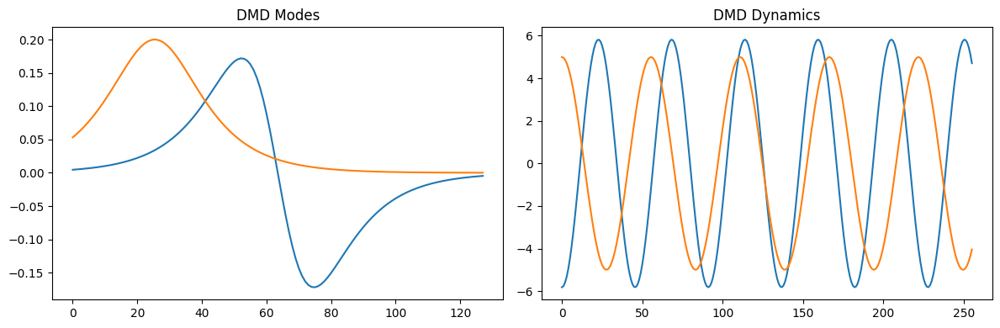

[[ 0.23885411+0.j          0.23740472+0.02635594j  0.23307355+0.05239655j
  ... -0.21935838-0.0946075j  -0.20755608-0.11822059j
  -0.19323704-0.14039492j]
 [ 0.25754297+0.j          0.25598047+0.02841572j  0.25131132+0.05649155j
  ... -0.23652003-0.10201446j -0.2237949 -0.12747274j
  -0.20835664-0.15137996j]
 [ 0.27753608+0.j          0.27585267+0.0306186j   0.2708222 +0.06087107j
  ... -0.25487888-0.10993956j -0.24116666-0.13737116j
  -0.22453141-0.16313162j]
 ...
 [ 0.03232809+0.j          0.03202325+0.00442741j  0.03111449+0.00877121j
  ... -0.03032774-0.01119258j -0.02850972-0.01524095j
  -0.02615398-0.01900198j]
 [ 0.029881  +0.j          0.02959924+0.00409228j  0.02875926+0.00810727j
  ... -0.02803207-0.01034536j -0.02635167-0.01408728j
  -0.02417424-0.01756361j]
 [ 0.02761904+0.j          0.02735861+0.00378249j  0.02658222+0.00749356j
  ... -0.02591007-0.00956222j -0.02435687-0.01302088j
  -0.02234427-0.01623407j]]


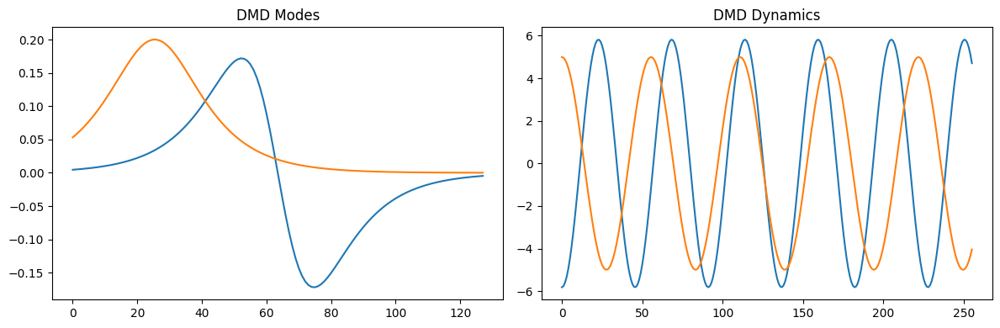

[[ 0.23885411+0.j          0.23740472+0.02635594j  0.23307355+0.05239655j
  ... -0.21935838-0.0946075j  -0.20755608-0.11822059j
  -0.19323704-0.14039492j]
 [ 0.25754297+0.j          0.25598047+0.02841572j  0.25131132+0.05649155j
  ... -0.23652003-0.10201446j -0.2237949 -0.12747274j
  -0.20835664-0.15137996j]
 [ 0.27753608+0.j          0.27585267+0.0306186j   0.2708222 +0.06087107j
  ... -0.25487888-0.10993956j -0.24116666-0.13737116j
  -0.22453141-0.16313162j]
 ...
 [ 0.03232809+0.j          0.03202325+0.00442741j  0.03111449+0.00877121j
  ... -0.03032774-0.01119258j -0.02850972-0.01524095j
  -0.02615398-0.01900198j]
 [ 0.029881  +0.j          0.02959924+0.00409228j  0.02875926+0.00810727j
  ... -0.02803207-0.01034536j -0.02635167-0.01408728j
  -0.02417424-0.01756361j]
 [ 0.02761904+0.j          0.02735861+0.00378249j  0.02658222+0.00749356j
  ... -0.02591007-0.00956222j -0.02435687-0.01302088j
  -0.02234427-0.01623407j]]


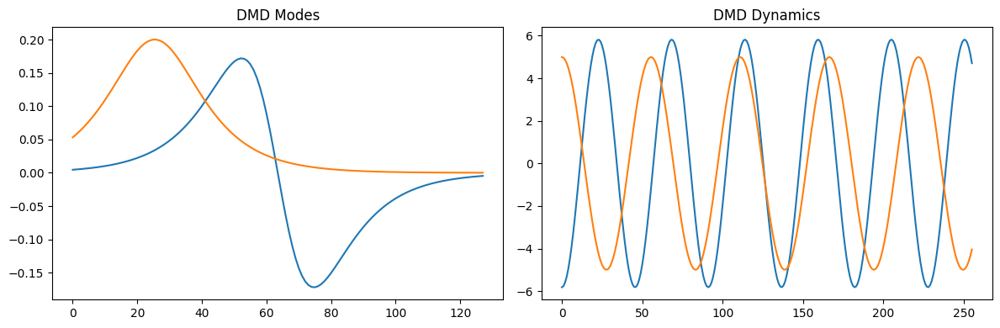

[[ 0.23885411+0.j          0.23740472+0.02635594j  0.23307355+0.05239655j
  ... -0.21935838-0.0946075j  -0.20755608-0.11822059j
  -0.19323704-0.14039492j]
 [ 0.25754297+0.j          0.25598047+0.02841572j  0.25131132+0.05649155j
  ... -0.23652003-0.10201446j -0.2237949 -0.12747274j
  -0.20835664-0.15137996j]
 [ 0.27753608+0.j          0.27585267+0.0306186j   0.2708222 +0.06087107j
  ... -0.25487888-0.10993956j -0.24116666-0.13737116j
  -0.22453141-0.16313162j]
 ...
 [ 0.03232809+0.j          0.03202325+0.00442741j  0.03111449+0.00877121j
  ... -0.03032774-0.01119258j -0.02850972-0.01524095j
  -0.02615398-0.01900198j]
 [ 0.029881  +0.j          0.02959924+0.00409228j  0.02875926+0.00810727j
  ... -0.02803207-0.01034536j -0.02635167-0.01408728j
  -0.02417424-0.01756361j]
 [ 0.02761904+0.j          0.02735861+0.00378249j  0.02658222+0.00749356j
  ... -0.02591007-0.00956222j -0.02435687-0.01302088j
  -0.02234427-0.01623407j]]


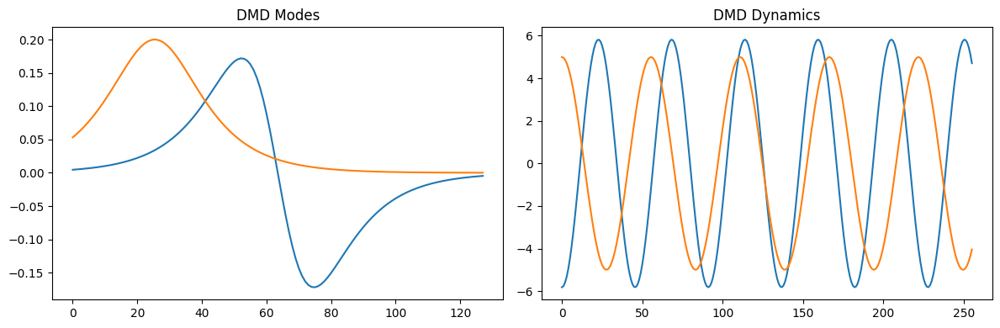

[[ 0.23885411+0.j          0.23740472+0.02635594j  0.23307355+0.05239655j
  ... -0.21935838-0.0946075j  -0.20755608-0.11822059j
  -0.19323704-0.14039492j]
 [ 0.25754297+0.j          0.25598047+0.02841572j  0.25131132+0.05649155j
  ... -0.23652003-0.10201446j -0.2237949 -0.12747274j
  -0.20835664-0.15137996j]
 [ 0.27753608+0.j          0.27585267+0.0306186j   0.2708222 +0.06087107j
  ... -0.25487888-0.10993956j -0.24116666-0.13737116j
  -0.22453141-0.16313162j]
 ...
 [ 0.03232809+0.j          0.03202325+0.00442741j  0.03111449+0.00877121j
  ... -0.03032774-0.01119258j -0.02850972-0.01524095j
  -0.02615398-0.01900198j]
 [ 0.029881  +0.j          0.02959924+0.00409228j  0.02875926+0.00810727j
  ... -0.02803207-0.01034536j -0.02635167-0.01408728j
  -0.02417424-0.01756361j]
 [ 0.02761904+0.j          0.02735861+0.00378249j  0.02658222+0.00749356j
  ... -0.02591007-0.00956222j -0.02435687-0.01302088j
  -0.02234427-0.01623407j]]


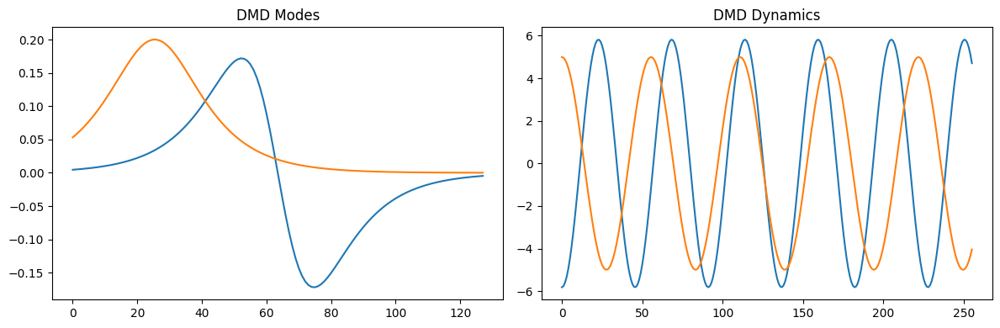

[[ 0.23885411+0.j          0.23740472+0.02635594j  0.23307355+0.05239655j
  ... -0.21935838-0.0946075j  -0.20755608-0.11822059j
  -0.19323704-0.14039492j]
 [ 0.25754297+0.j          0.25598047+0.02841572j  0.25131132+0.05649155j
  ... -0.23652003-0.10201446j -0.2237949 -0.12747274j
  -0.20835664-0.15137996j]
 [ 0.27753608+0.j          0.27585267+0.0306186j   0.2708222 +0.06087107j
  ... -0.25487888-0.10993956j -0.24116666-0.13737116j
  -0.22453141-0.16313162j]
 ...
 [ 0.03232809+0.j          0.03202325+0.00442741j  0.03111449+0.00877121j
  ... -0.03032774-0.01119258j -0.02850972-0.01524095j
  -0.02615398-0.01900198j]
 [ 0.029881  +0.j          0.02959924+0.00409228j  0.02875926+0.00810727j
  ... -0.02803207-0.01034536j -0.02635167-0.01408728j
  -0.02417424-0.01756361j]
 [ 0.02761904+0.j          0.02735861+0.00378249j  0.02658222+0.00749356j
  ... -0.02591007-0.00956222j -0.02435687-0.01302088j
  -0.02234427-0.01623407j]]


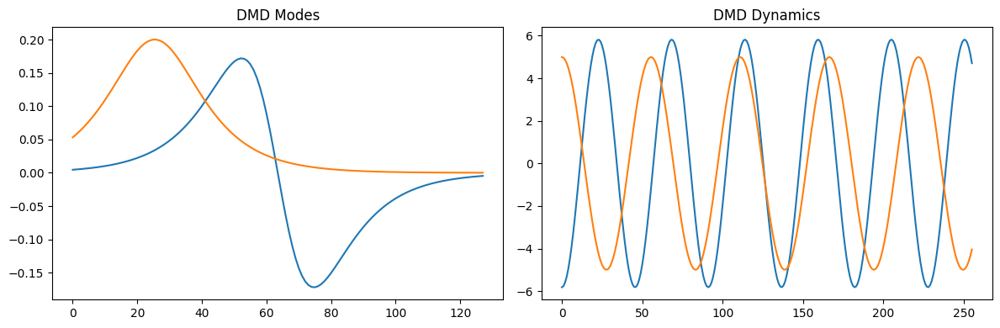

[[ 0.23885411+0.j          0.23740472+0.02635594j  0.23307355+0.05239655j
  ... -0.21935838-0.0946075j  -0.20755608-0.11822059j
  -0.19323704-0.14039492j]
 [ 0.25754297+0.j          0.25598047+0.02841572j  0.25131132+0.05649155j
  ... -0.23652003-0.10201446j -0.2237949 -0.12747274j
  -0.20835664-0.15137996j]
 [ 0.27753608+0.j          0.27585267+0.0306186j   0.2708222 +0.06087107j
  ... -0.25487888-0.10993956j -0.24116666-0.13737116j
  -0.22453141-0.16313162j]
 ...
 [ 0.03232809+0.j          0.03202325+0.00442741j  0.03111449+0.00877121j
  ... -0.03032774-0.01119258j -0.02850972-0.01524095j
  -0.02615398-0.01900198j]
 [ 0.029881  +0.j          0.02959924+0.00409228j  0.02875926+0.00810727j
  ... -0.02803207-0.01034536j -0.02635167-0.01408728j
  -0.02417424-0.01756361j]
 [ 0.02761904+0.j          0.02735861+0.00378249j  0.02658222+0.00749356j
  ... -0.02591007-0.00956222j -0.02435687-0.01302088j
  -0.02234427-0.01623407j]]


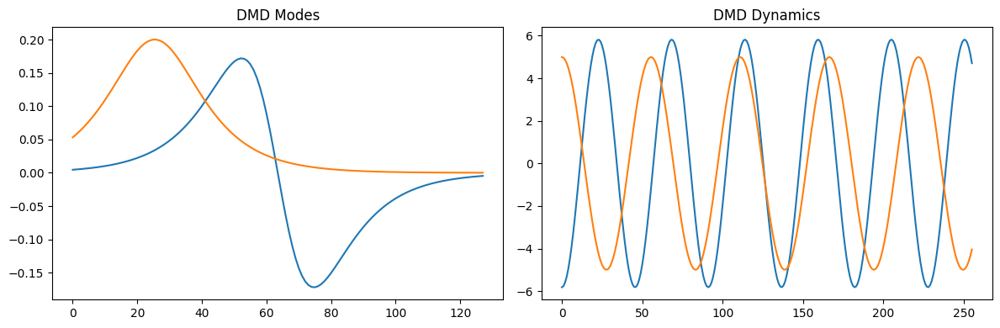

[[ 0.23885411+0.j          0.23740472+0.02635594j  0.23307355+0.05239655j
  ... -0.21935838-0.0946075j  -0.20755608-0.11822059j
  -0.19323704-0.14039492j]
 [ 0.25754297+0.j          0.25598047+0.02841572j  0.25131132+0.05649155j
  ... -0.23652003-0.10201446j -0.2237949 -0.12747274j
  -0.20835664-0.15137996j]
 [ 0.27753608+0.j          0.27585267+0.0306186j   0.2708222 +0.06087107j
  ... -0.25487888-0.10993956j -0.24116666-0.13737116j
  -0.22453141-0.16313162j]
 ...
 [ 0.03232809+0.j          0.03202325+0.00442741j  0.03111449+0.00877121j
  ... -0.03032774-0.01119258j -0.02850972-0.01524095j
  -0.02615398-0.01900198j]
 [ 0.029881  +0.j          0.02959924+0.00409228j  0.02875926+0.00810727j
  ... -0.02803207-0.01034536j -0.02635167-0.01408728j
  -0.02417424-0.01756361j]
 [ 0.02761904+0.j          0.02735861+0.00378249j  0.02658222+0.00749356j
  ... -0.02591007-0.00956222j -0.02435687-0.01302088j
  -0.02234427-0.01623407j]]


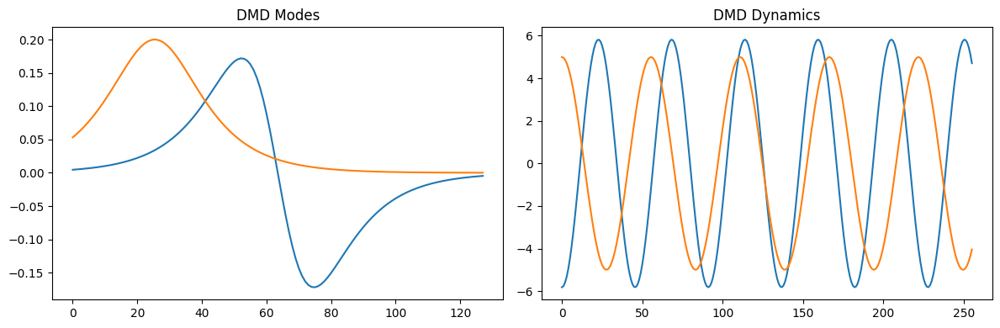

Average Execution Time: 0.760261 seconds
Average RAM Usage: 7168.00 bytes
time: 1min 16s (started: 2023-07-17 11:37:26 +00:00)


In [ ]:
external_variable_1 = X.T

# Code block to measure execution time and RAM requirements
code_block = """
# Access the external variables or dependencies here
print(external_variable_1)

Z = X.T

# Perform DMD
pdmd = DMD(svd_rank=2)
pdmd.fit(Z)

# Access DMD modes and dynamics
pmodes = pdmd.modes.T
pdynamics = pdmd.dynamics

# Visualize DMD modes and dynamics
plt.figure(figsize=(12, 4))

# Plot DMD modes
plt.subplot(1, 2, 1)
for mode in pmodes:
    plt.plot(mode)
plt.title('DMD Modes')

# Plot DMD dynamics
plt.subplot(1, 2, 2)
for dynamic in pdynamics:
    plt.plot(dynamic)
plt.title('DMD Dynamics')

plt.tight_layout()
plt.show()
"""

execution_times = []
memory_usage = []

# Execute the code block 10 times and measure the execution time and RAM requirements
for _ in range(100):
    process = psutil.Process()
    process_memory_before = process.memory_info().rss

    # Create a setup statement to define the local namespace with the external variables
    setup_statement = f"from __main__ import external_variable_1"

    # Measure the execution time
    execution_time = timeit.timeit(stmt=code_block, setup=setup_statement, globals=globals(), number=1)

    # Measure the memory usage
    process_memory_after = process.memory_info().rss
    memory_usage.append(process_memory_after - process_memory_before)

    # Store the execution time
    execution_times.append(execution_time)

# Calculate the average execution time and RAM usage
average_execution_time = sum(execution_times) / len(execution_times)
average_memory_usage = sum(memory_usage) / len(memory_usage)

# Print the average execution time and RAM usage
print("Average Execution Time: {:.6f} seconds".format(average_execution_time))
print("Average RAM Usage: {:.2f} bytes".format(average_memory_usage))

In [ ]:
import sys

time: 444 µs (started: 2023-08-21 13:30:15 +00:00)


In [ ]:
X_size_bytes = sys.getsizeof(X)

# Convert bytes to megabytes
X_size_kilobytes = X_size_bytes / 1024

print(f"Array size: {X_size_kilobytes:.2f} KB")

Array size: 512.12 KB
time: 1.83 ms (started: 2023-08-20 16:44:01 +00:00)


In [ ]:
PC_size_bytes = sys.getsizeof(PCf)

# Convert bytes to megabytes
PC_size_kilobytes = PC_size_bytes / 1024

print(f"Array size: {PC_size_kilobytes:.2f} KB")

Array size: 8.12 KB
time: 1.22 ms (started: 2023-08-20 16:43:52 +00:00)


In [ ]:
DMD_dyn_size_bytes = sys.getsizeof(dmd.dynamics)

# Convert bytes to megabytes
DMD_dyn_size_kilobytes = DMD_dyn_size_bytes / 1024

print(f"Array size: {DMD_dyn_size_kilobytes:.2f} KB")

Array size: 8.12 KB
time: 7.99 ms (started: 2023-08-20 16:43:27 +00:00)


In [ ]:
DMD_modes_size_bytes = sys.getsizeof(dmd.modes)

# Convert bytes to megabytes
DMD_modes_size_kilobytes = DMD_modes_size_bytes / 1024

print(f"Array size: {DMD_modes_size_kilobytes:.2f} KB")

Array size: 0.12 KB
time: 928 µs (started: 2023-08-20 16:43:43 +00:00)


In [ ]:
PDMD_dyn_size_bytes = sys.getsizeof(pdmd.dynamics)

# Convert bytes to megabytes
PDMD_dyn_size_kilobytes = PDMD_dyn_size_bytes / 1024

print(f"Array size: {PDMD_dyn_size_kilobytes:.2f} KB")

Array size: 16.12 KB
time: 1.47 ms (started: 2023-08-20 16:44:55 +00:00)


In [ ]:
pDMD_modes_size_bytes = sys.getsizeof(pdmd.modes)

# Convert bytes to megabytes
pDMD_modes_size_kilobytes = pDMD_modes_size_bytes / 1024

print(f"Array size: {pDMD_modes_size_kilobytes:.2f} KB")

Array size: 0.12 KB
time: 3.88 ms (started: 2023-08-20 16:45:23 +00:00)


In [ ]:
recon_size_bytes = sys.getsizeof(dmd.reconstructed_data)

# Convert bytes to megabytes
recon_size_kilobytes = recon_size_bytes / 1024

print(f"Array size: {recon_size_kilobytes:.2f} KB")

Array size: 512.12 KB
time: 7.26 ms (started: 2023-08-21 13:30:17 +00:00)


In [ ]:
PCArecon_size_bytes = sys.getsizeof(X_recon)

# Convert bytes to megabytes
PCArecon_size_kilobytes = PCArecon_size_bytes / 1024

print(f"Array size: {PCArecon_size_kilobytes:.2f} KB")

Array size: 512.12 KB
time: 3.2 ms (started: 2023-08-21 13:32:25 +00:00)
